In [22]:
import os
os.chdir('mmpose')

In [ ]:
!python tools/misc/publish_model.py \
        work_dirs/rtmpose-l-Dog_hip_center/best_PCK_epoch_10.pth \
        checkpoint/center_epoch_100.pth

In [ ]:
!python tools/misc/publish_model.py \
        work_dirs/rtmpose-l-Dog_hip_head/best_PCK_epoch_20.pth \
        checkpoint/head_epoch_200.pth

In [1]:
import cv2
import numpy as np
from PIL import Image

import matplotlib.pyplot as plt
%matplotlib inline
import scipy
import pandas as pd

import torch

import mmcv
from mmcv import imread
import mmengine
from mmengine.registry import init_default_scope

from mmpose.apis import inference_topdown
from mmpose.apis import init_model as init_pose_estimator
from mmpose.evaluation.functional import nms
from mmpose.registry import VISUALIZERS
from mmpose.structures import merge_data_samples
import matplotlib.patches as patches

from mmdet.apis import inference_detector, init_detector



In [2]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print('device', device)

device cuda:0


In [4]:
# # faster rcnn
# detector = init_detector(
#     '/home/featurize/work/mmdetection/data/faster_r_cnn_dog_hip_AC_FH.py',
    
#     '/home/featurize/work/mmdetection/checkpoint/faster_r_cnn_dog_hip_acfh_-56ce5bbe.pth',
#     device=device
# )

Loads checkpoint by local backend from path: /home/featurize/work/mmdetection/checkpoint/faster_r_cnn_dog_hip_acfh_-56ce5bbe.pth


In [3]:
# rtm detec
detector = init_detector(
    '/home/featurize/work/mmdetection/data/rtmdet_dog_hip_cranial_acetabulum.py',
    
    '/home/featurize/work/mmdetection/checkpoint/rtmdet_dog_hip_cranial_acetabulum_epoch_130-02159770.pth',
    device=device
)

Loads checkpoint by local backend from path: /home/featurize/work/mmdetection/checkpoint/rtmdet_dog_hip_cranial_acetabulum_epoch_130-02159770.pth


In [57]:
img_path = '/home/featurize/work/Dataset2/data/July_2024/138477.jpg'
init_default_scope(detector.cfg.get('default_scope', 'mmdet'))

detect_result = inference_detector(detector, img_path)

In [5]:
labels =detect_result.pred_instances.labels
labels

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [6]:
print(dir(detect_result.pred_instances))

['__class__', '__contains__', '__delattr__', '__delitem__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getitem__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__len__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__setitem__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_data_fields', '_metainfo_fields', 'all_items', 'all_keys', 'all_values', 'bboxes', 'cat', 'clone', 'cpu', 'cuda', 'detach', 'get', 'items', 'keys', 'labels', 'metainfo', 'metainfo_items', 'metainfo_keys', 'metainfo_values', 'mlu', 'musa', 'new', 'npu', 'numpy', 'pop', 'scores', 'set_data', 'set_field', 'set_metainfo', 'to', 'to_dict', 'to_tensor', 'update', 'values']


In [58]:
scores = detect_result.pred_instances.scores
scores 

tensor([0.3864, 0.2473, 0.1520, 0.1159, 0.0995, 0.0811, 0.0774, 0.0742, 0.0709,
        0.0695, 0.0674, 0.0594, 0.0478, 0.0465, 0.0401, 0.0317, 0.0317, 0.0304,
        0.0294, 0.0291, 0.0266, 0.0253, 0.0251, 0.0244, 0.0240, 0.0234, 0.0227,
        0.0226, 0.0226, 0.0222, 0.0216, 0.0202, 0.0189, 0.0186, 0.0179, 0.0179,
        0.0174, 0.0165, 0.0161, 0.0161, 0.0160, 0.0156, 0.0152, 0.0149, 0.0147,
        0.0142, 0.0141, 0.0139, 0.0138, 0.0137, 0.0135, 0.0135, 0.0135, 0.0135,
        0.0134, 0.0133, 0.0132, 0.0130, 0.0130, 0.0129, 0.0128, 0.0128, 0.0128,
        0.0128, 0.0128, 0.0127, 0.0126, 0.0125, 0.0125, 0.0124, 0.0124, 0.0124,
        0.0124, 0.0123, 0.0121, 0.0121, 0.0120, 0.0120, 0.0119, 0.0119, 0.0119,
        0.0118, 0.0118, 0.0118, 0.0117, 0.0117, 0.0116, 0.0116, 0.0116, 0.0115,
        0.0114, 0.0114, 0.0113, 0.0113, 0.0113, 0.0112, 0.0111, 0.0111, 0.0111,
        0.0111, 0.0111, 0.0111, 0.0110, 0.0109, 0.0109, 0.0109, 0.0109, 0.0109,
        0.0109, 0.0109, 0.0109, 0.0108, 

In [8]:
bboxes=detect_result.pred_instances.bboxes[:]
bboxes

tensor([[ 245.3426,   95.5781,  735.4568,  114.6691],
        [ 234.5121,  100.0167,  727.1880,  117.4987],
        [ 239.5468,   83.5497,  729.3752,  108.8638],
        ...,
        [   0.0000,   77.1395,  118.7498,  126.4430],
        [ 294.4750,   10.3072,  719.0475,   36.1380],
        [ 538.8101,  889.2153, 1007.0000,  932.2787]], device='cuda:0')

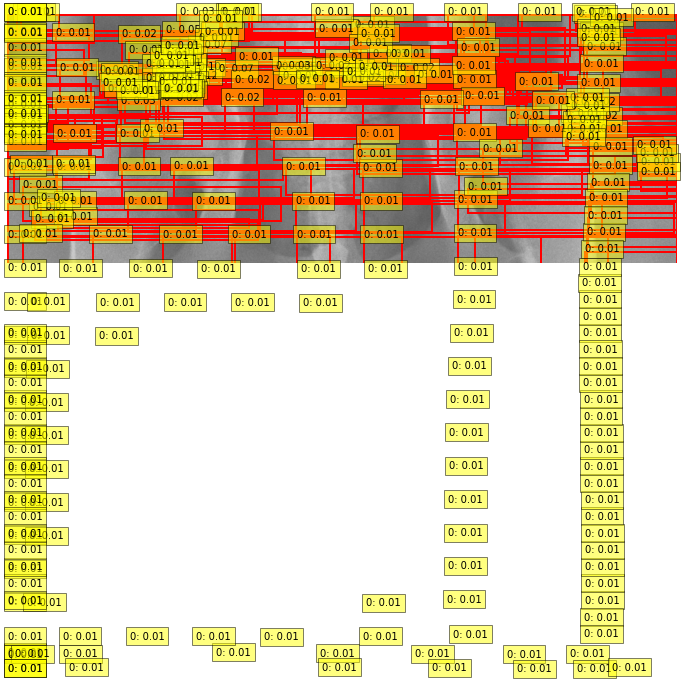

In [9]:
img_path = '/home/featurize/work/Dataset2/data/July_2024/138477.jpg'
image = Image.open(img_path)
scores = scores.cpu().numpy()
bboxes = bboxes.cpu().numpy()
labels = labels.cpu().numpy()

# 加载图像
img_path = '/home/featurize/work/Dataset2/data/July_2024/138477.jpg'
image = Image.open(img_path)

# 显示图像
fig, ax = plt.subplots(1, figsize=(12, 12))
ax.imshow(image)

# 不同类别的颜色
colors = ['r', 'b']

# 绘制边界框
for i in range(len(bboxes)):
    bbox = bboxes[i]
    label = labels[i]
    score = scores[i]

    # 边界框的左上角坐标和宽高
    x, y, width, height = bbox[0], bbox[1], bbox[2] - bbox[0], bbox[3] - bbox[1]

    # 创建矩形补丁
    rect = patches.Rectangle((x, y), width, height, linewidth=2, edgecolor=colors[label], facecolor='none')
    ax.add_patch(rect)

    # 添加标签和分数
    plt.text(x, y, f'{label}: {score:.2f}', bbox=dict(facecolor='yellow', alpha=0.5))

plt.axis('off')
plt.show()

In [4]:
# RTMDet 
detector2 = init_detector(
    '/home/featurize/work/mmdetection/data/rtmdet_dog_hip_center.py',
    
    '/home/featurize/work/mmdetection/checkpoint/rtmdet_dog_hip_center_175-fb9c4177.pth',
    device=device
)

Loads checkpoint by local backend from path: /home/featurize/work/mmdetection/checkpoint/rtmdet_dog_hip_center_175-fb9c4177.pth


In [5]:
pose_estimator = init_pose_estimator(
    '/home/featurize/work/mmpose/data/rtmpose-m-Dog_hip_CA.py',
    '/home/featurize/work/mmpose/checkpoint/CA_epoch_190-4624ec1a_20240804.pth',
    device=device,
    cfg_options={'model': {'test_cfg': {'output_heatmaps': False}}}
)

Loads checkpoint by local backend from path: /home/featurize/work/mmpose/checkpoint/CA_epoch_190-4624ec1a_20240804.pth


In [6]:
pose_estimator2 = init_pose_estimator(
    '/home/featurize/work/mmpose/data/rtmpose-s-Dog_hip_center-v0.py',
    '/home/featurize/work/mmpose/checkpoint/center_epoch_100-e250c000_20240714.pth',
    device=device,
    cfg_options={'model': {'test_cfg': {'output_heatmaps': False}}}
)

Loads checkpoint by local backend from path: /home/featurize/work/mmpose/checkpoint/center_epoch_100-e250c000_20240714.pth


Processing /home/featurize/work/Dataset2/data/Testing/Images/340563.jpeg
CA: [[[515 110]
  [517 108]]]
FH: [[[221 130]]

 [[525 166]]]


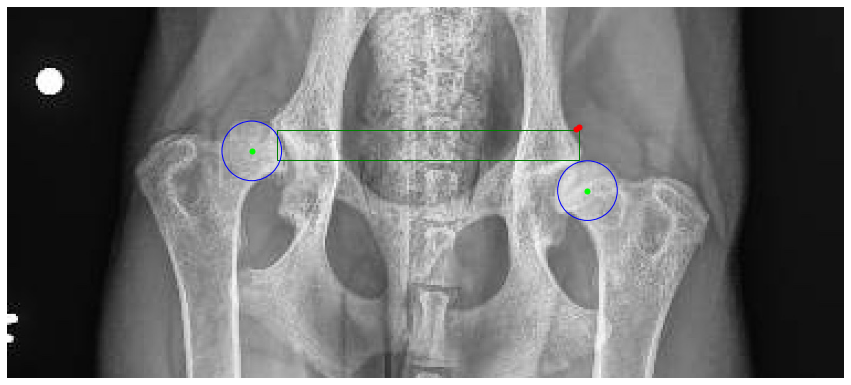

Processing /home/featurize/work/Dataset2/data/Testing/Images/359971.jpeg
FH: [[[480 107]]]


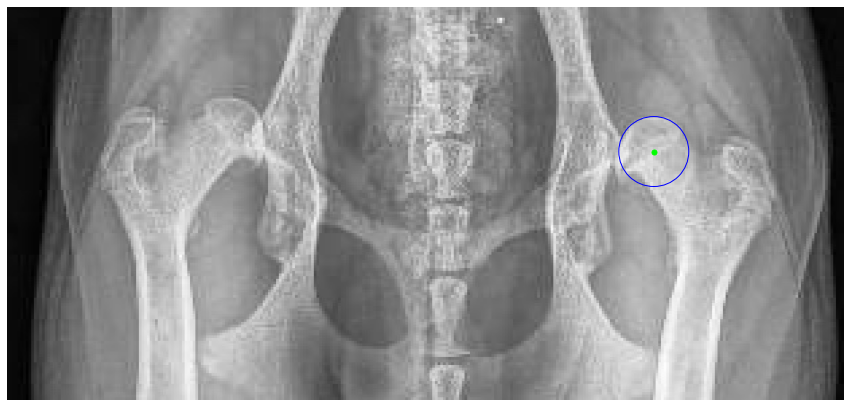

Processing /home/featurize/work/Dataset2/data/Testing/Images/328949.jpeg
CA: [[[341 144]
  [337 141]]]
FH: [[[696 193]]

 [[317 171]]]


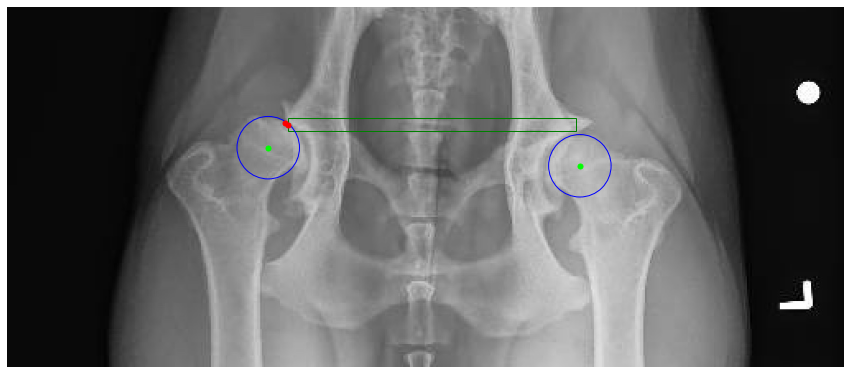

Processing /home/featurize/work/Dataset2/data/Testing/Images/348742.jpeg
CA: [[[197 113]
  [448 122]]]
FH: [[[436 152]]

 [[203 143]]]


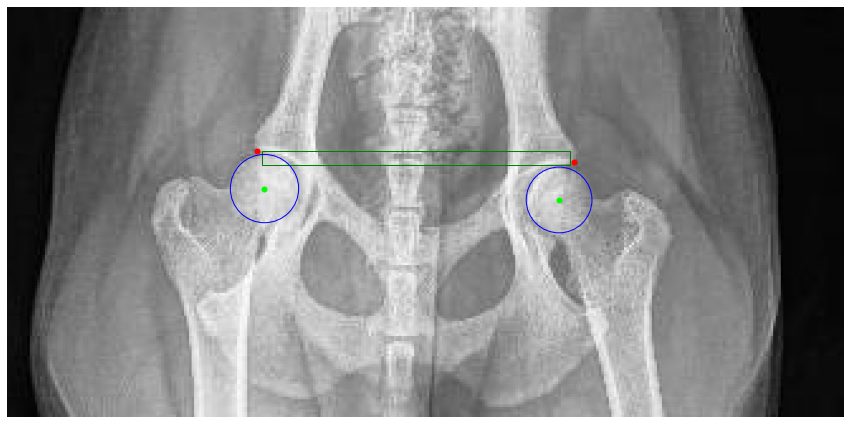

Processing /home/featurize/work/Dataset2/data/Testing/Images/355767.jpeg
CA: [[[616 115]
  [283 115]]]
FH: [[[604 157]]

 [[295 150]]]


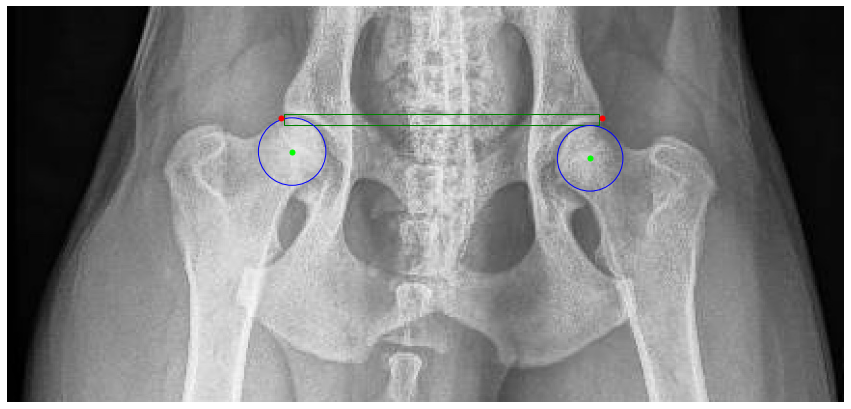

Processing /home/featurize/work/Dataset2/data/Testing/Images/353517.jpeg
CA: [[[184  94]
  [453  90]]]
FH: [[[192 126]]

 [[451 118]]]


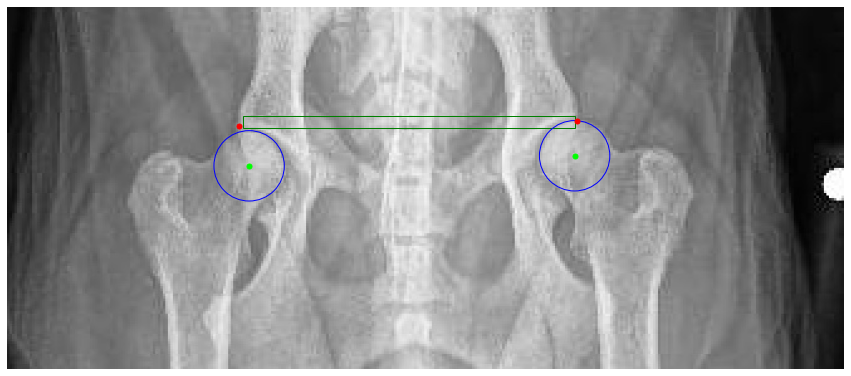

Processing /home/featurize/work/Dataset2/data/Testing/Images/355524.jpeg
FH: [[[485 153]]

 [[172 151]]]


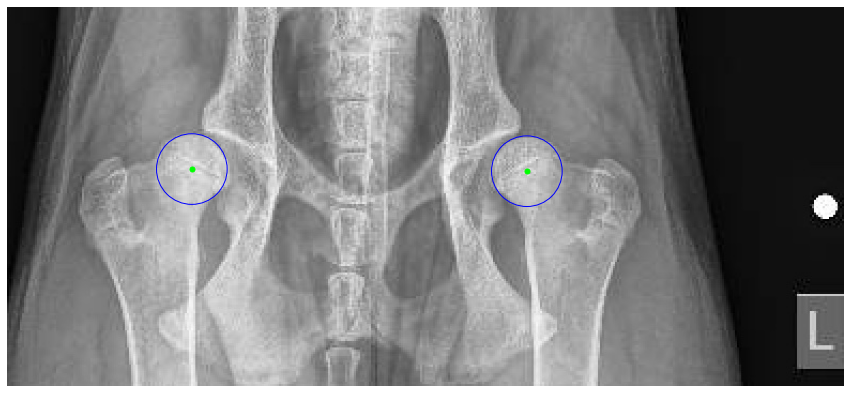

Processing /home/featurize/work/Dataset2/data/Testing/Images/358587.jpeg
CA: [[[172  66]
  [405  65]]]
FH: [[[398  88]]

 [[178  96]]]


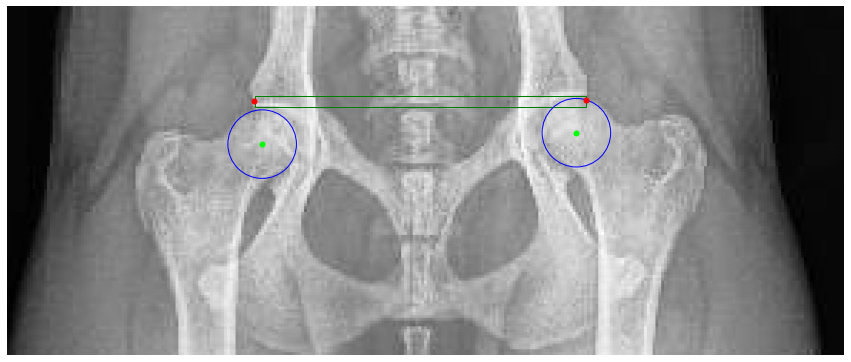

Processing /home/featurize/work/Dataset2/data/Testing/Images/355223.jpeg
FH: [[[372 145]]

 [[615 145]]]


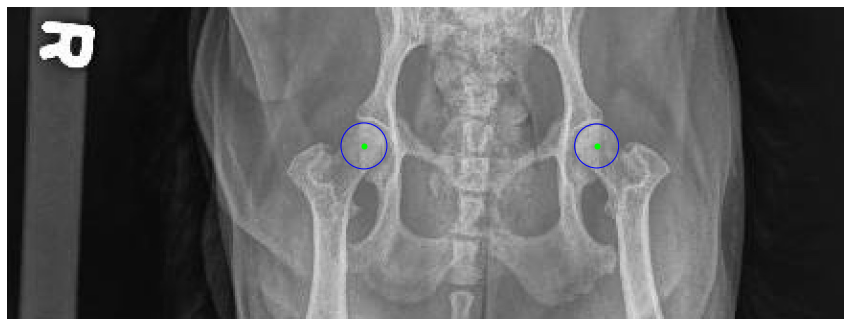

Processing /home/featurize/work/Dataset2/data/Testing/Images/264113.jpeg
CA: [[[591 100]
  [299  98]]]
FH: [[[580 136]]

 [[302 113]]]


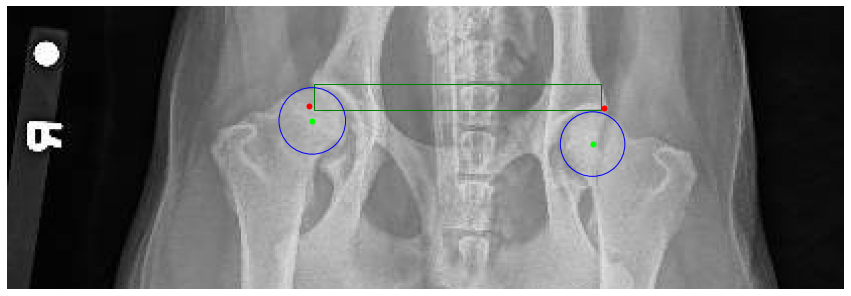

Processing /home/featurize/work/Dataset2/data/Testing/Images/365780.jpeg
CA: [[[590 140]
  [207 138]]]
FH: [[[569 181]]

 [[225 163]]]


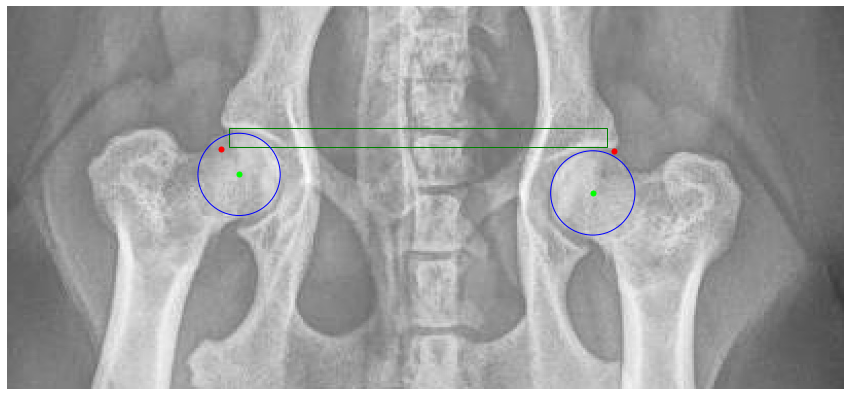

Processing /home/featurize/work/Dataset2/data/Testing/Images/360388.jpeg
CA: [[[443  59]
  [148  78]]]
FH: [[[155  93]]

 [[432 115]]]


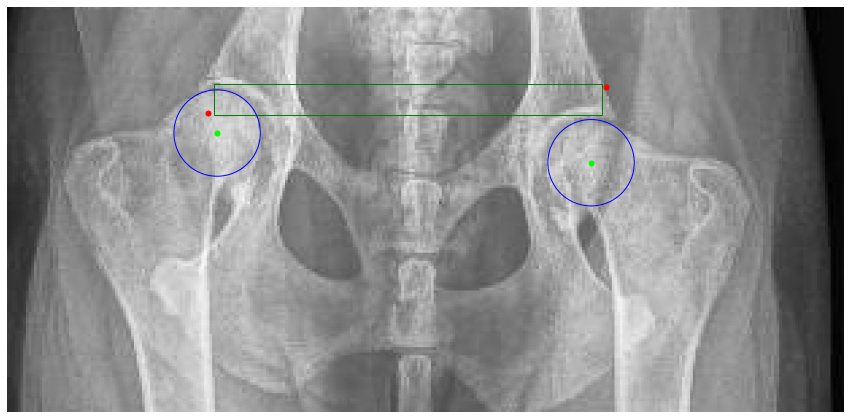

Processing /home/featurize/work/Dataset2/data/Testing/Images/246775.jpeg
FH: [[[277  51]]

 [[126  50]]]


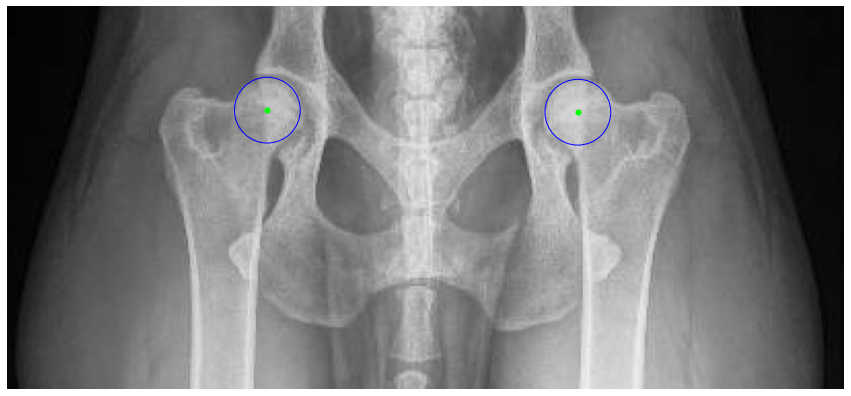

Processing /home/featurize/work/Dataset2/data/Testing/Images/361492.jpeg
FH: [[[496 103]]

 [[179 111]]]


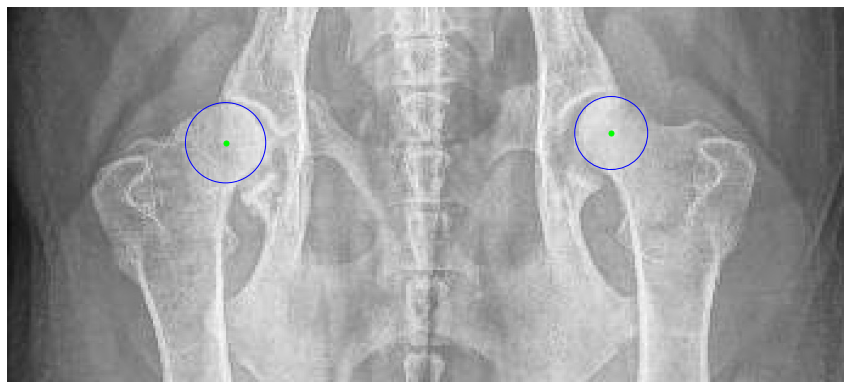

Processing /home/featurize/work/Dataset2/data/Testing/Images/336938.jpeg
CA: [[[484 145]
  [221 143]]]
FH: [[[477 173]]

 [[226 158]]]


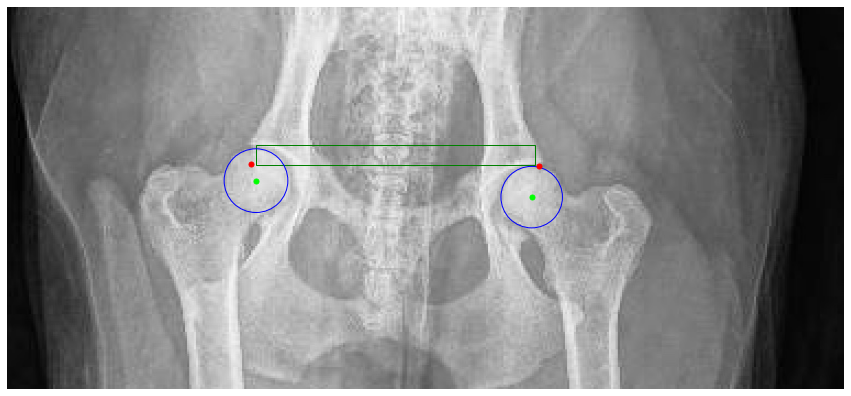

Processing /home/featurize/work/Dataset2/data/Testing/Images/358275.jpeg
FH: [[[183 119]]

 [[426 122]]]


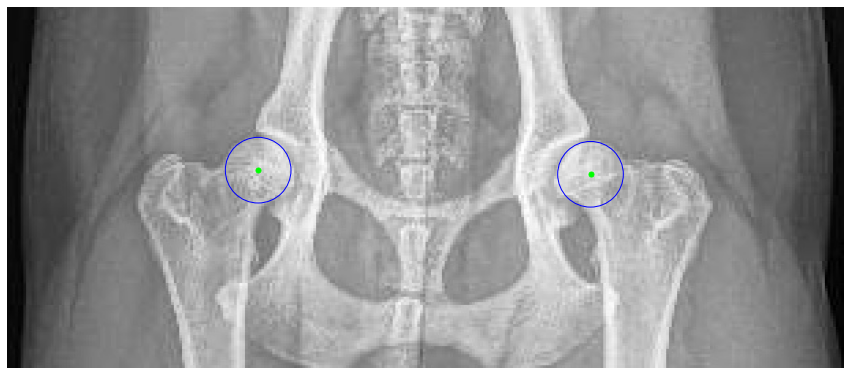

Processing /home/featurize/work/Dataset2/data/Testing/Images/364394.jpeg
FH: [[[143  84]]

 [[380  86]]]


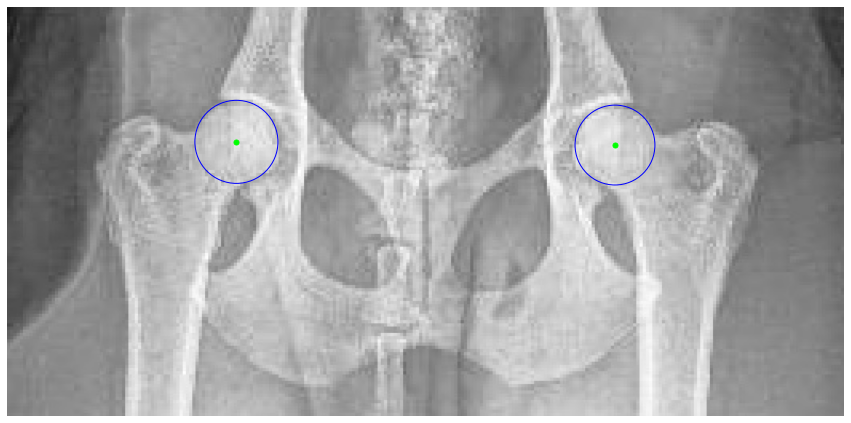

Processing /home/featurize/work/Dataset2/data/Testing/Images/353262.jpg
CA: [[[1288  250]
  [ 418  114]]]
FH: [[[ 483  347]]

 [[1290  211]]]


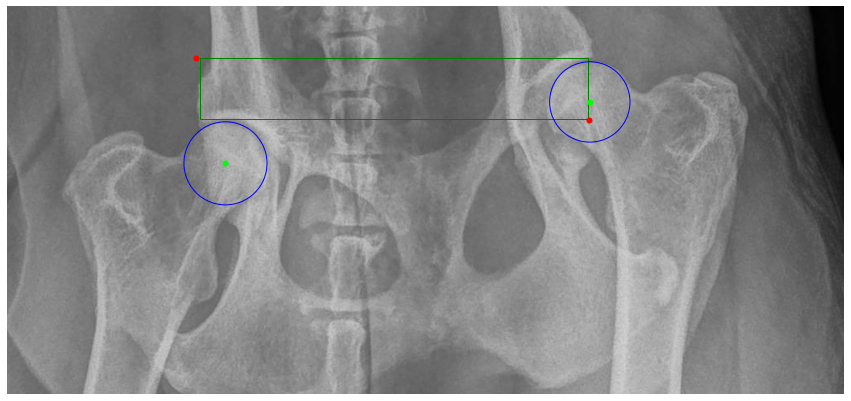

Processing /home/featurize/work/Dataset2/data/Testing/Images/359216.jpeg
FH: [[[169 116]]

 [[407 122]]]


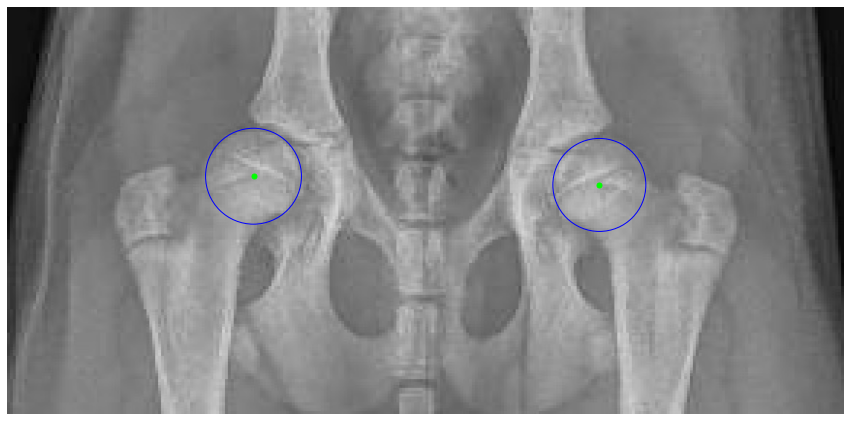

Processing /home/featurize/work/Dataset2/data/Testing/Images/352697.jpeg
FH: [[[502 131]]

 [[216 132]]]


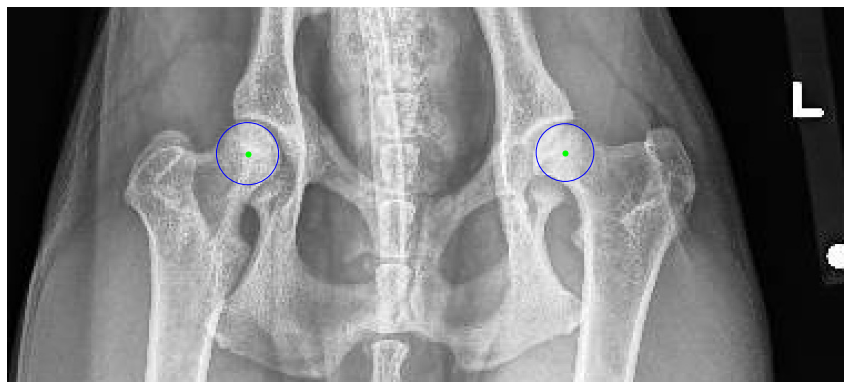

Processing /home/featurize/work/Dataset2/data/Testing/Images/359792.jpeg
CA: [[[460  98]
  [170  98]]]
FH: [[[447 130]]

 [[177 105]]]


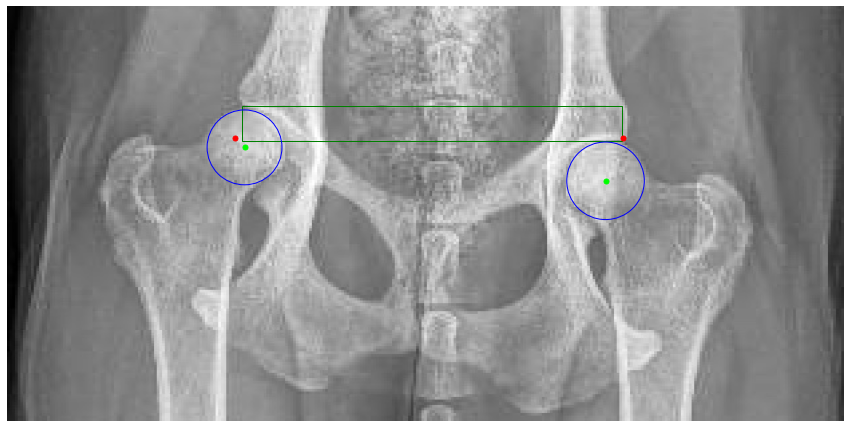

Processing /home/featurize/work/Dataset2/data/Testing/Images/360132.jpeg
CA: [[[152  66]
  [154  66]]]
FH: [[[162  97]]

 [[455 105]]]


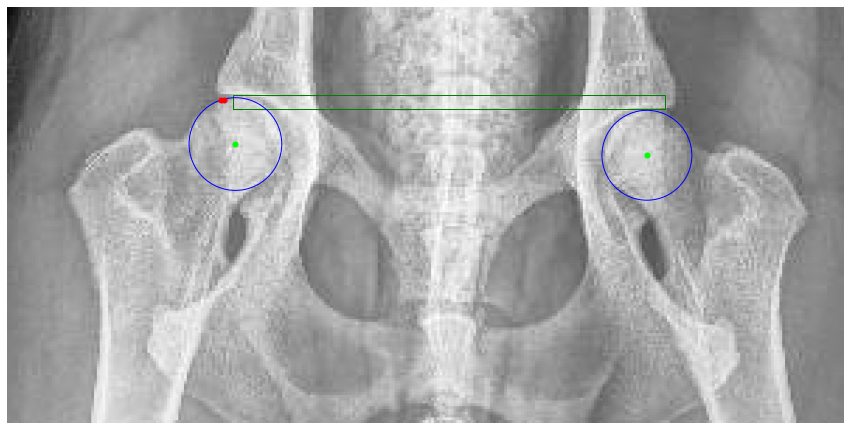

Processing /home/featurize/work/Dataset2/data/Testing/Images/251256.jpg
CA: [[[ 333  112]
  [1082  224]]]
FH: [[[1017  290]]

 [[ 305  205]]]


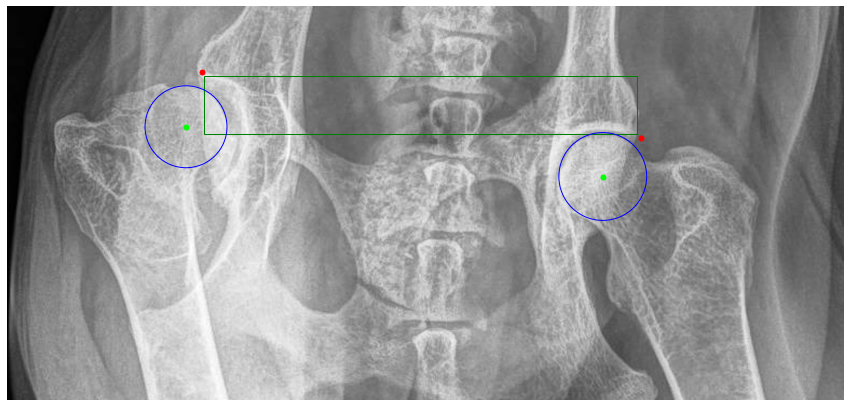

Processing /home/featurize/work/Dataset2/data/Testing/Images/350186.jpeg
CA: [[[518 124]
  [519 124]]]
FH: [[[506 160]]

 [[229 158]]]


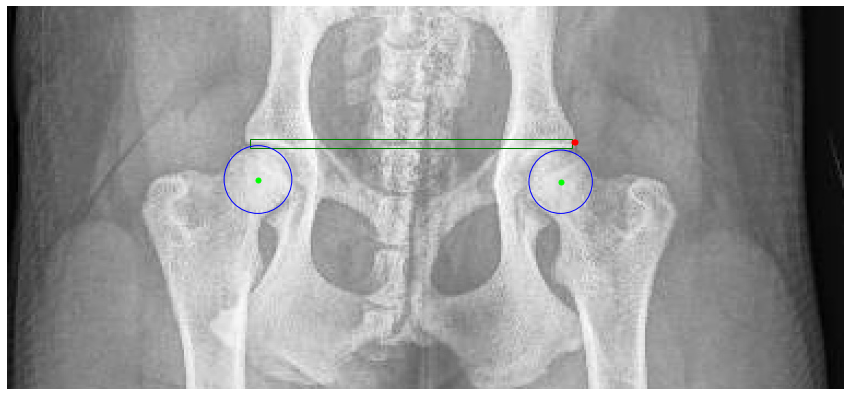

Processing /home/featurize/work/Dataset2/data/Testing/Images/367031.jpg
FH: [[[320 224]]

 [[970 214]]]


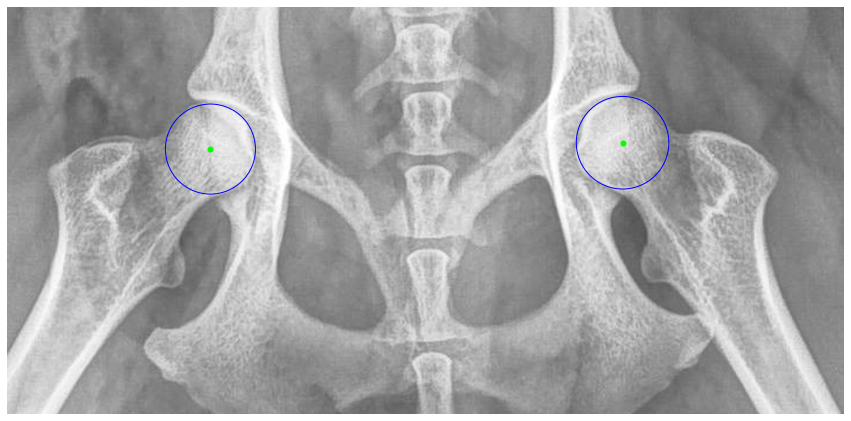

Processing /home/featurize/work/Dataset2/data/Testing/Images/348064.jpeg
CA: [[[524 130]
  [206 127]]]
FH: [[[510 149]]

 [[230 162]]]


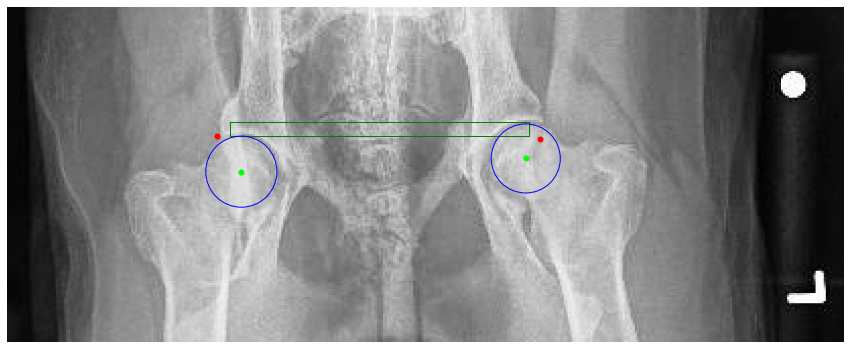

Processing /home/featurize/work/Dataset2/data/Testing/Images/337935.jpeg
CA: [[[908 194]
  [904 156]]]
FH: [[[899 209]]

 [[421 252]]]


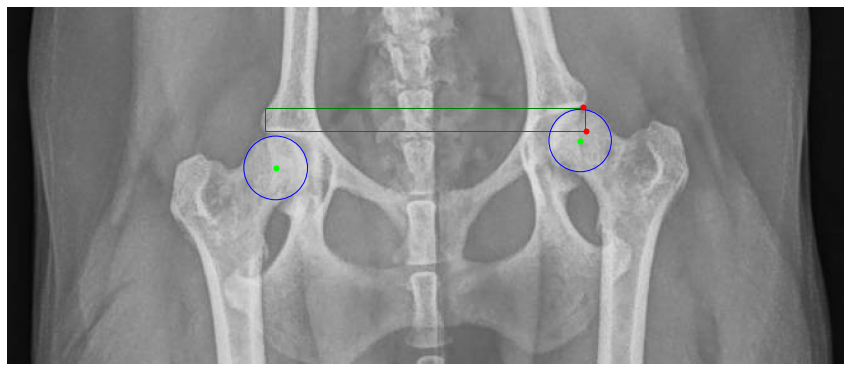

Processing /home/featurize/work/Dataset2/data/Testing/Images/360778.jpeg
CA: [[[539 101]
  [207  99]]]
FH: [[[542 139]]

 [[200 133]]]


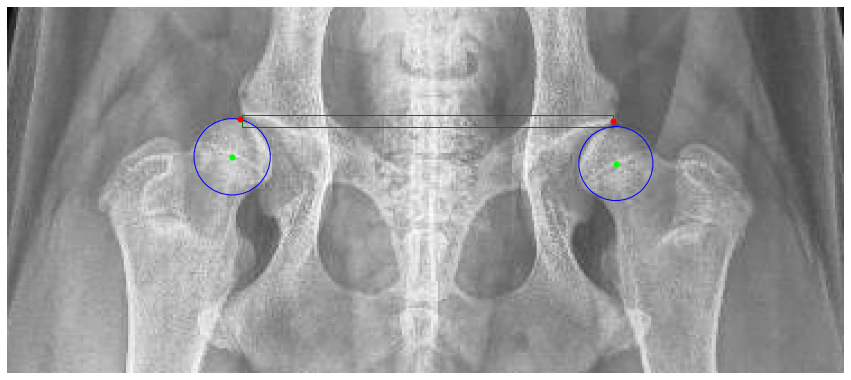

Processing /home/featurize/work/Dataset2/data/Testing/Images/204964.jpg
CA: [[[1197  435]
  [1210  435]]]
FH: [[[1145  522]]

 [[ 338  340]]]


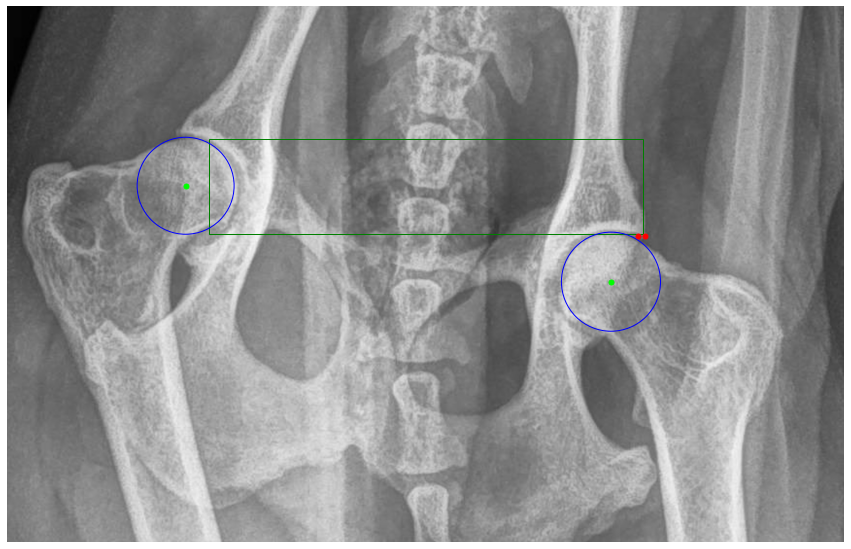

Processing /home/featurize/work/Dataset2/data/Testing/Images/357039.jpeg
CA: [[[514  89]
  [230 103]]]
FH: [[[507 122]]

 [[249 133]]]


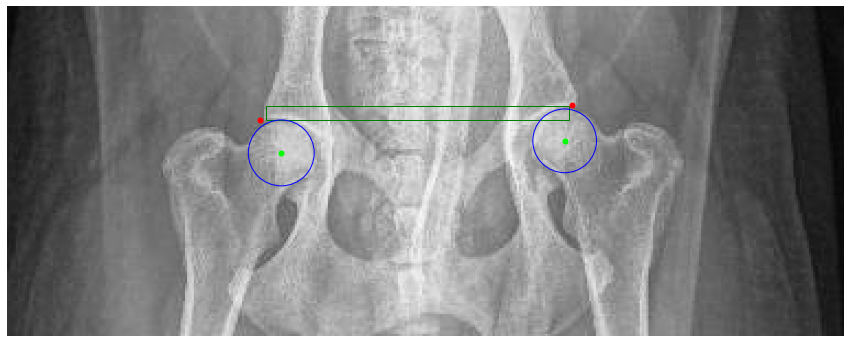

Processing /home/featurize/work/Dataset2/data/Testing/Images/261359.jpeg
CA: [[[286  27]
  [291  28]]]
FH: [[[282  48]]

 [[121  56]]]


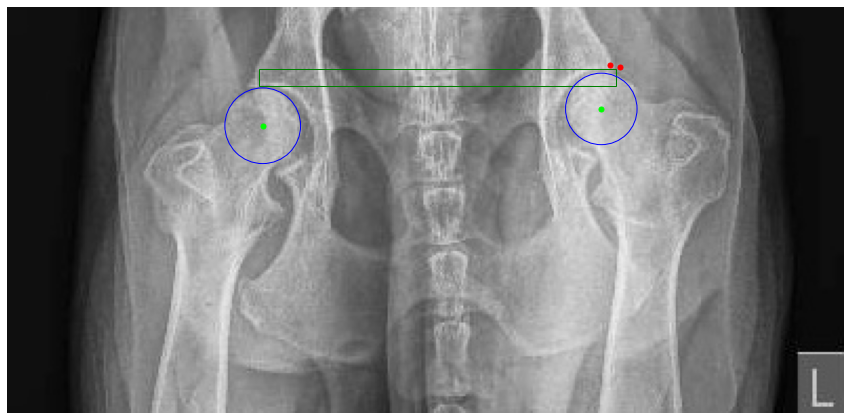

Processing /home/featurize/work/Dataset2/data/Testing/Images/363515.jpeg
CA: [[[190  91]
  [189  69]]]
FH: [[[484 123]]

 [[196 108]]]


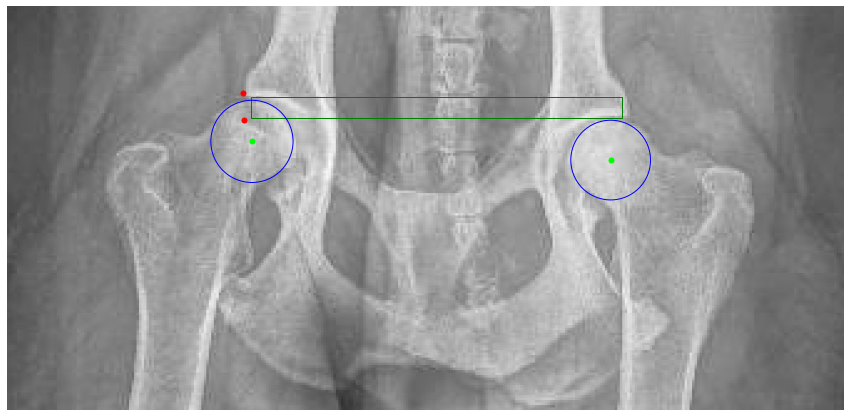

Processing /home/featurize/work/Dataset2/data/Testing/Images/359626.jpeg
FH: [[[159 123]]

 [[408 121]]]


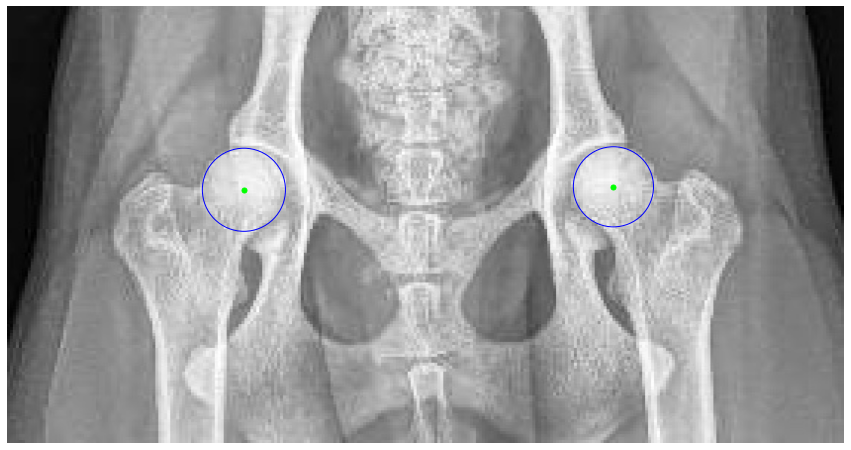

Processing /home/featurize/work/Dataset2/data/Testing/Images/341649.jpeg
FH: [[[274 189]]

 [[607 198]]]


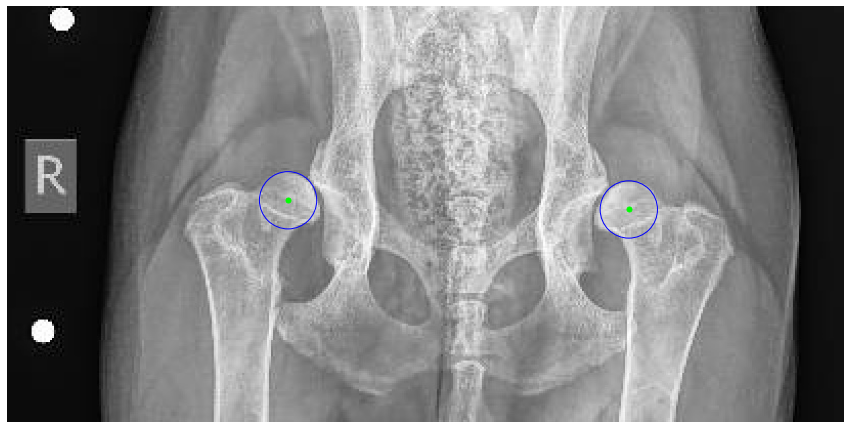

Processing /home/featurize/work/Dataset2/data/Testing/Images/348002.jpeg
CA: [[[451  59]
  [203  59]]]
FH: [[[222 125]]

 [[445  90]]]


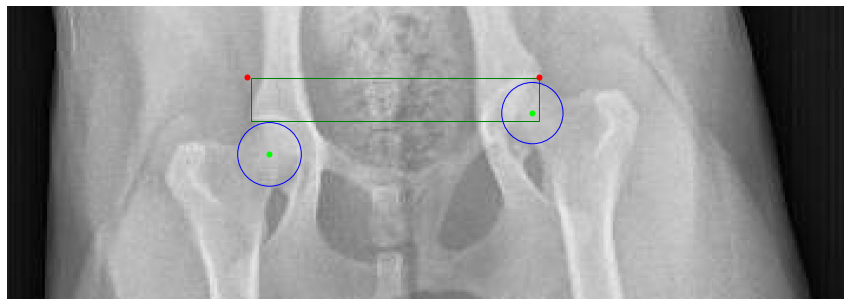

Processing /home/featurize/work/Dataset2/data/Testing/Images/359782.jpeg
FH: [[[201 131]]

 [[510 133]]]


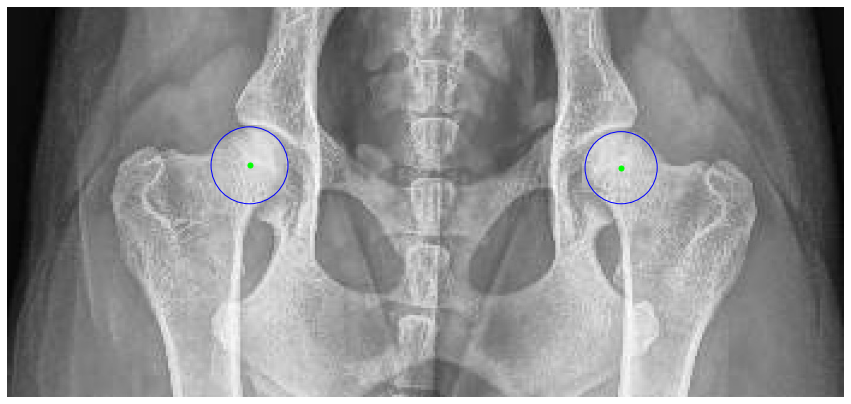

Processing /home/featurize/work/Dataset2/data/Testing/Images/270257.jpeg
CA: [[[586  91]
  [282  89]]]
FH: [[[591 102]]

 [[294 127]]]


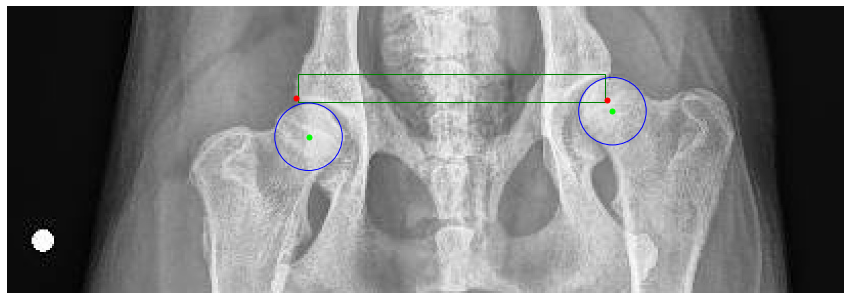

Processing /home/featurize/work/Dataset2/data/Testing/Images/350556.jpeg
CA: [[[463  88]
  [186  87]]]
FH: [[[193 117]]

 [[470  98]]]


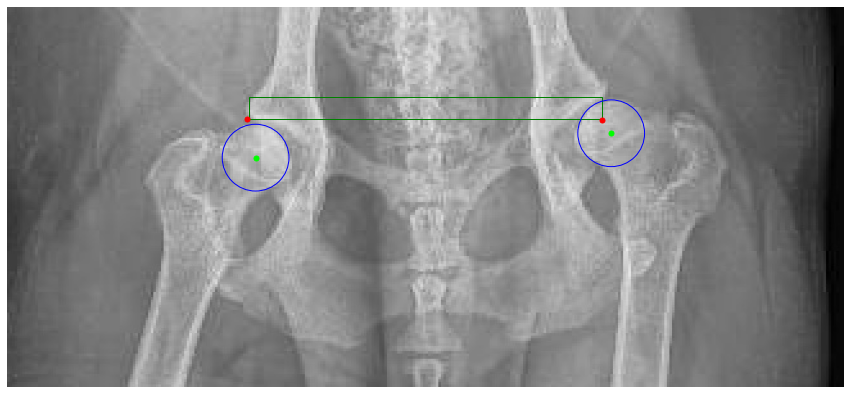

Processing /home/featurize/work/Dataset2/data/Testing/Images/360678.jpg
FH: [[[1043  210]]

 [[ 321  215]]]


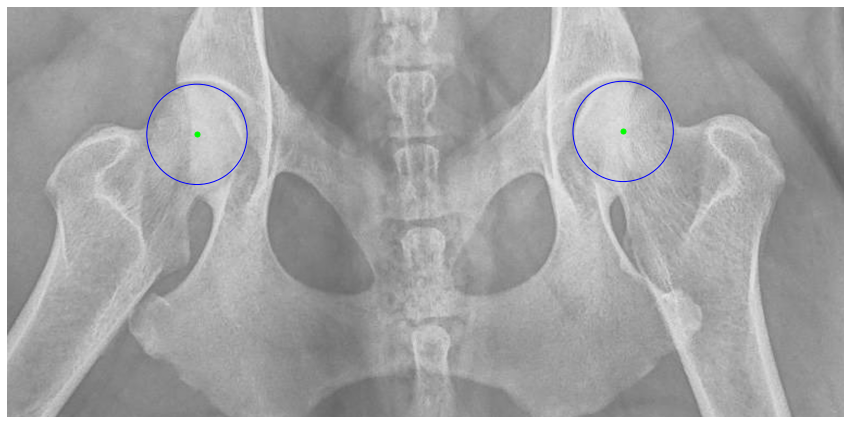

Processing /home/featurize/work/Dataset2/data/Testing/Images/364276.jpeg
CA: [[[460 130]
  [460 129]]]
FH: [[[194 165]]

 [[448 151]]]


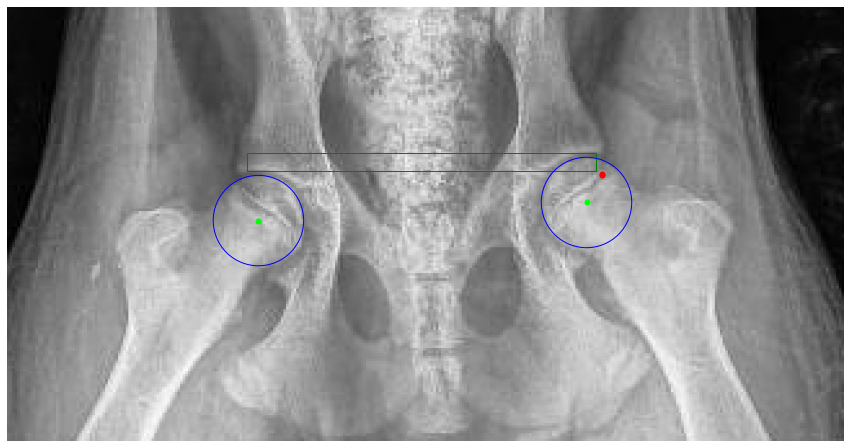

Processing /home/featurize/work/Dataset2/data/Testing/Images/349607.jpeg
CA: [[[517 124]
  [518 122]]]
FH: [[[214 159]]

 [[511 149]]]


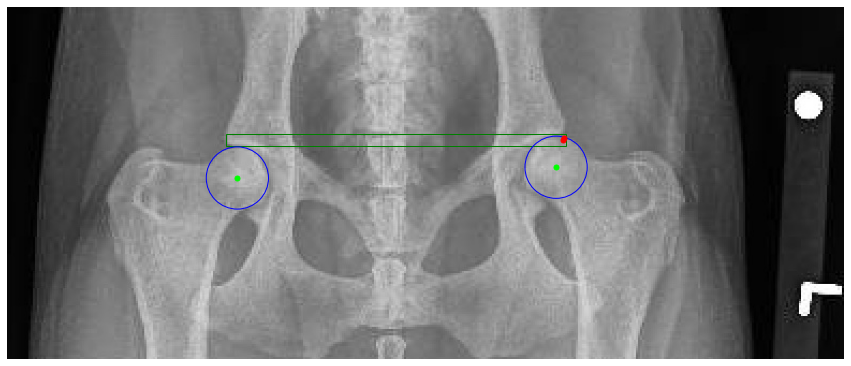

Processing /home/featurize/work/Dataset2/data/Testing/Images/302735.jpeg
CA: [[[295 111]
  [564 111]]]
FH: [[[552 145]]

 [[306 139]]]


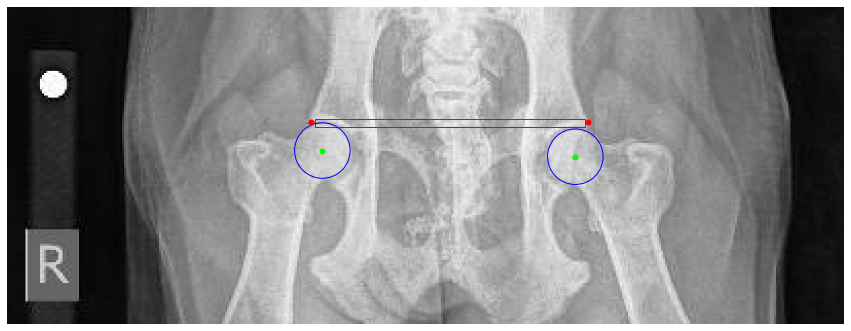

Processing /home/featurize/work/Dataset2/data/Testing/Images/361188.jpeg
CA: [[[155  75]
  [153  75]]]
FH: [[[413  91]]

 [[169 110]]]


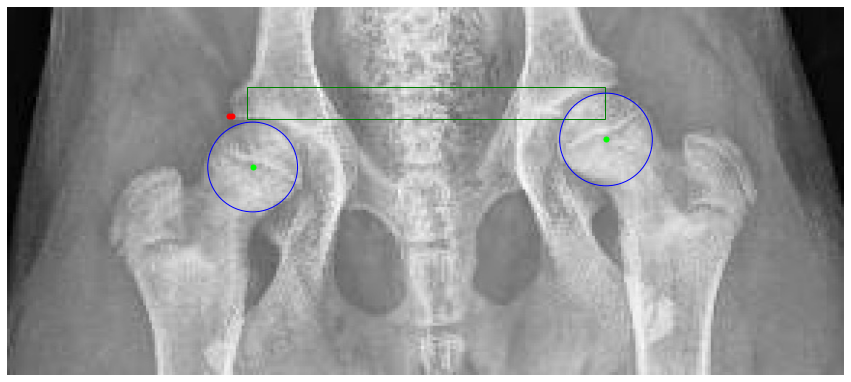

Processing /home/featurize/work/Dataset2/data/Testing/Images/335450.jpeg
CA: [[[497 138]
  [244 136]]]
FH: [[[486 164]]

 [[248 149]]]


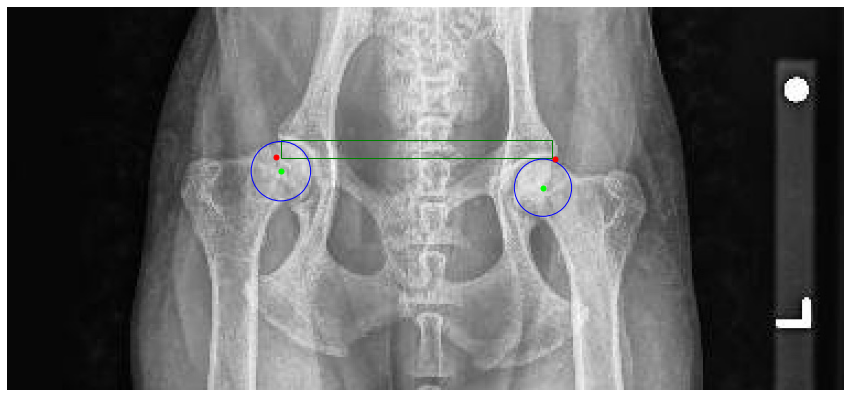

Processing /home/featurize/work/Dataset2/data/Testing/Images/352456.jpeg
CA: [[[220 102]
  [219 100]]]
FH: [[[493 137]]

 [[230 129]]]


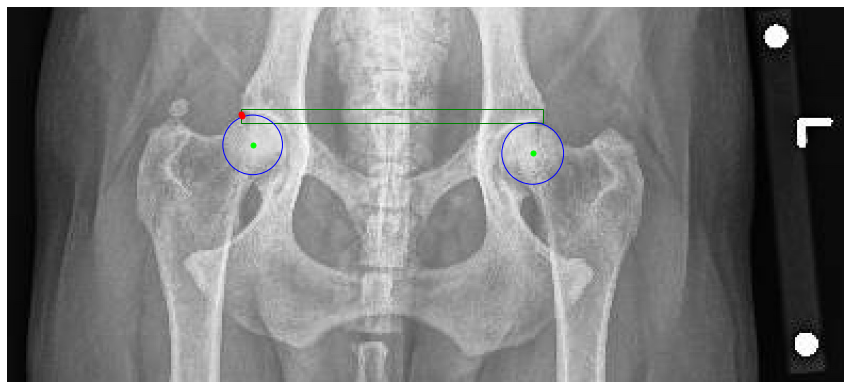

Processing /home/featurize/work/Dataset2/data/Testing/Images/314200.jpeg
CA: [[[239 157]
  [235 156]]]
FH: [[[529 195]]

 [[240 165]]]


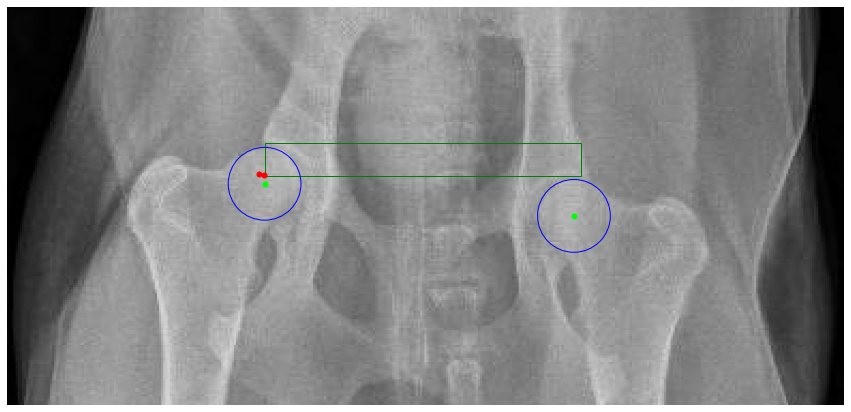

Processing /home/featurize/work/Dataset2/data/Testing/Images/351971.jpg
CA: [[[1136  229]
  [ 359  228]]]
FH: [[[1088  328]]

 [[ 385  318]]]


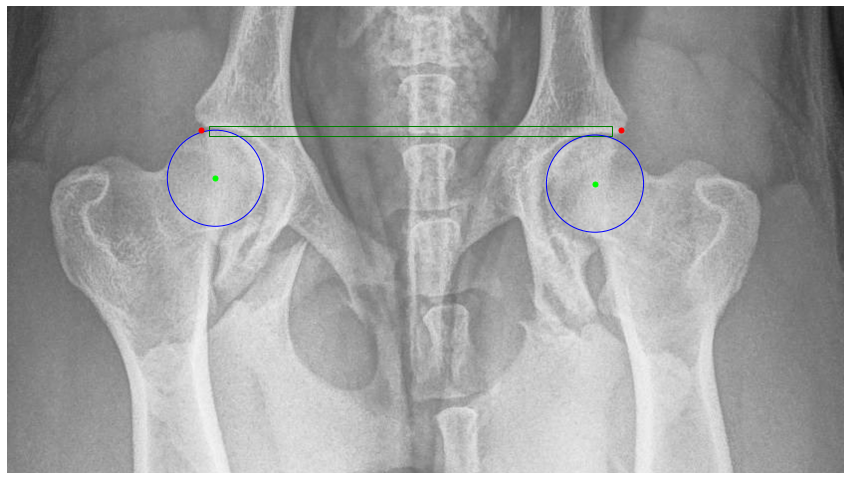

Processing /home/featurize/work/Dataset2/data/Testing/Images/339041.jpeg
FH: [[[224 137]]

 [[517 137]]]


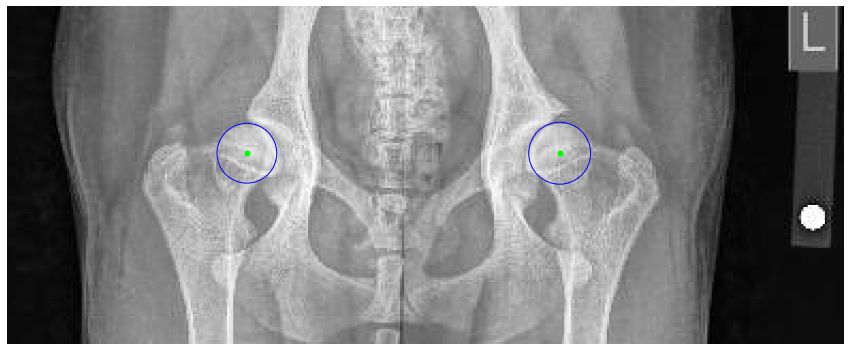

Processing /home/featurize/work/Dataset2/data/Testing/Images/332727.jpeg
CA: [[[201 138]
  [486 117]]]
FH: [[[475 170]]

 [[206 150]]]


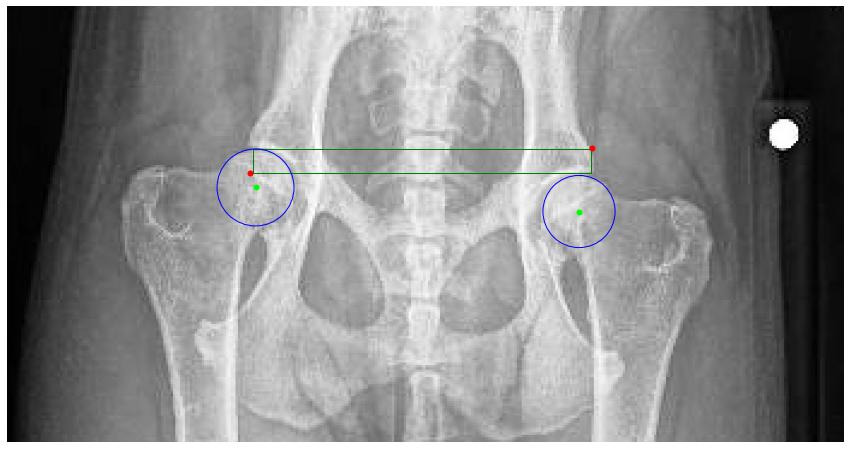

Processing /home/featurize/work/Dataset2/data/Testing/Images/351666.jpg
FH: [[[ 376  364]]

 [[1253  361]]]


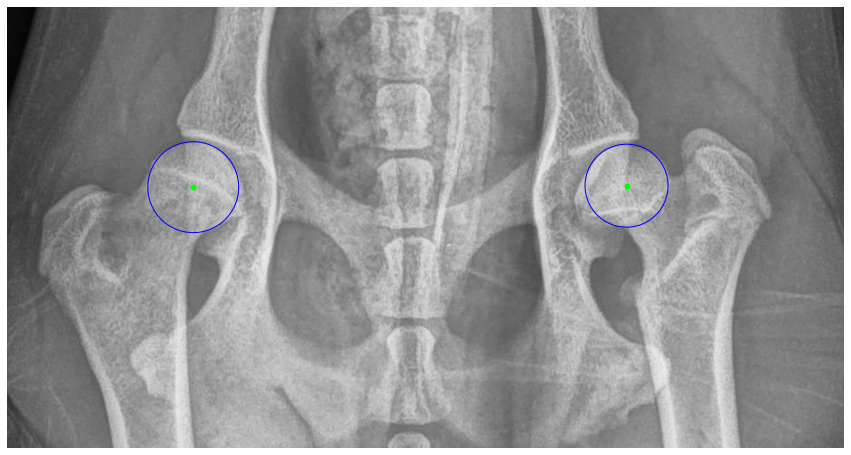

Processing /home/featurize/work/Dataset2/data/Testing/Images/351294.jpeg
CA: [[[458  88]
  [189  82]]]
FH: [[[453 108]]

 [[198 118]]]


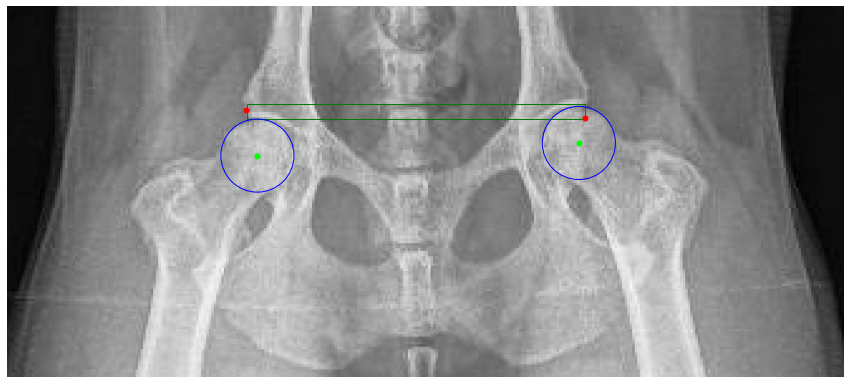

Processing /home/featurize/work/Dataset2/data/Testing/Images/288625.jpeg
CA: [[[516  90]
  [253  72]]]
FH: [[[261 105]]

 [[508 119]]]


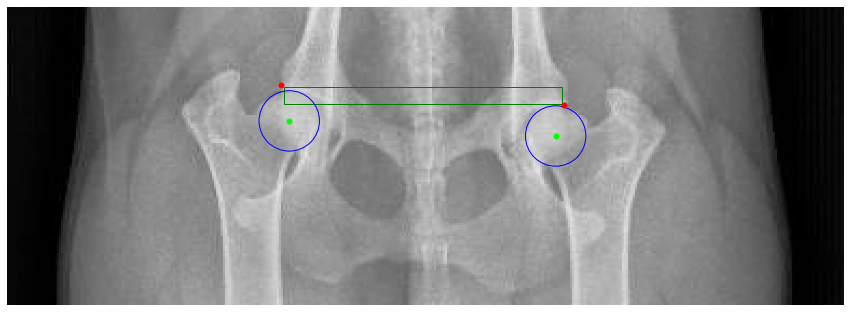

Processing /home/featurize/work/Dataset2/data/Testing/Images/357332.jpeg
FH: [[[490 103]]

 [[221  99]]]


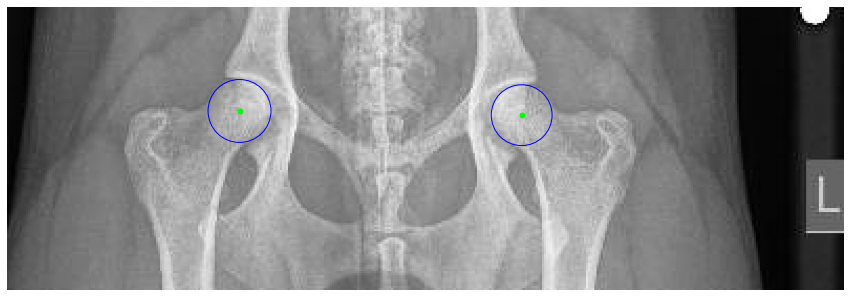

Processing /home/featurize/work/Dataset2/data/Testing/Images/345281.jpeg
CA: [[[508 112]
  [208 111]]]
FH: [[[501 142]]

 [[222 149]]]


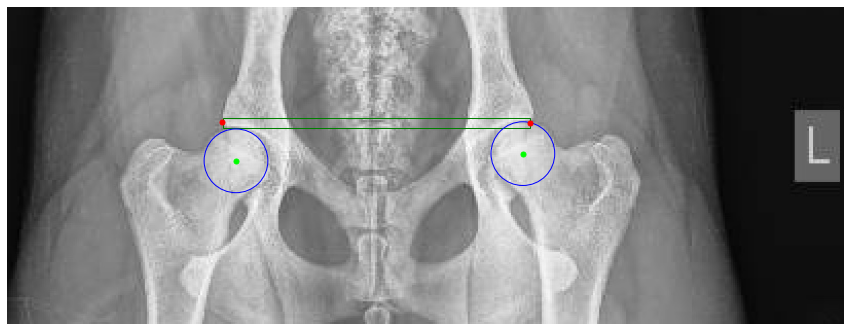

Processing /home/featurize/work/Dataset2/data/Testing/Images/364123.jpeg
CA: [[[152  70]
  [434  69]]]
FH: [[[423  99]]

 [[164 104]]]


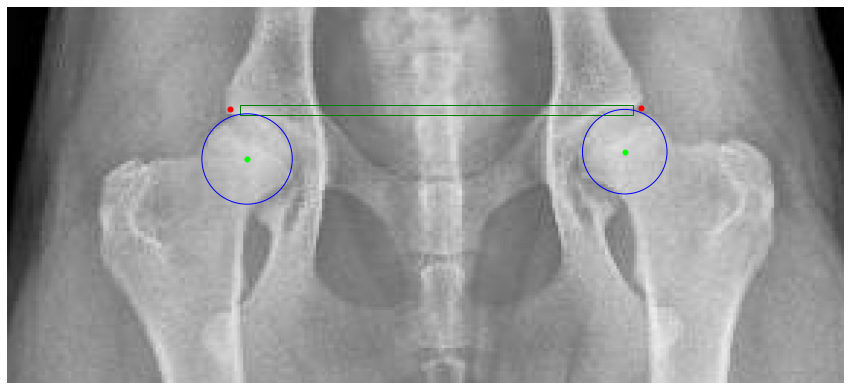

Processing /home/featurize/work/Dataset2/data/Testing/Images/332635.jpeg
CA: [[[268 139]
  [519 138]]]
FH: [[[509 165]]

 [[272 154]]]


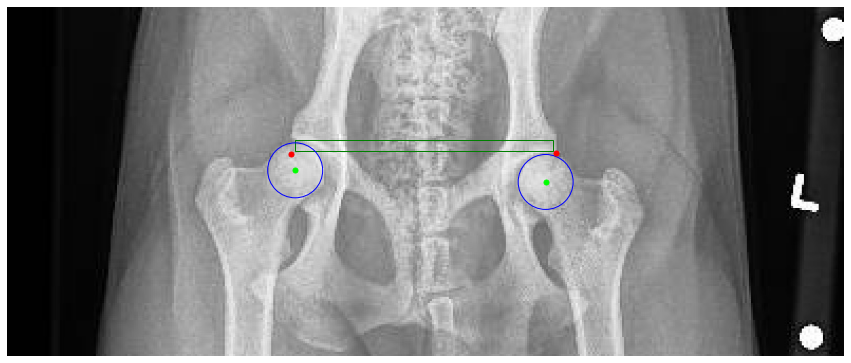

Processing /home/featurize/work/Dataset2/data/Testing/Images/355423.jpeg
CA: [[[199 162]
  [197 160]]]
FH: [[[208 181]]

 [[534 200]]]


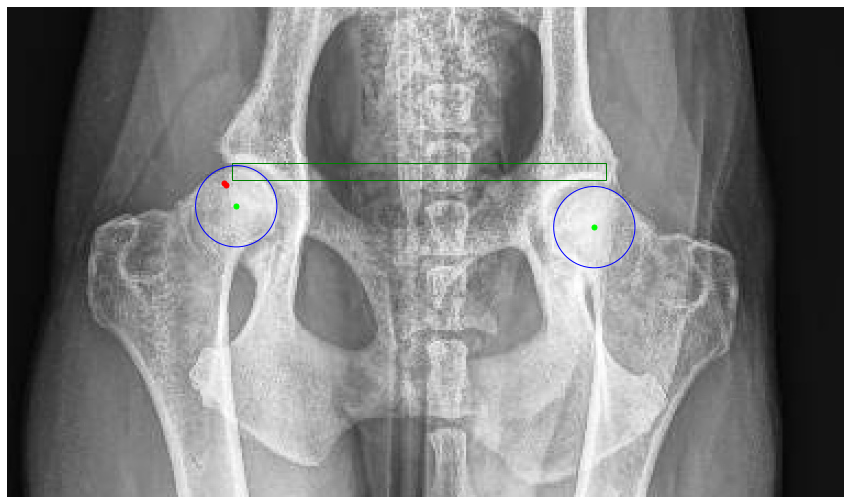

Processing /home/featurize/work/Dataset2/data/Testing/Images/360391.jpeg
CA: [[[194 102]
  [190 100]]]
FH: [[[526 138]]

 [[194 131]]]


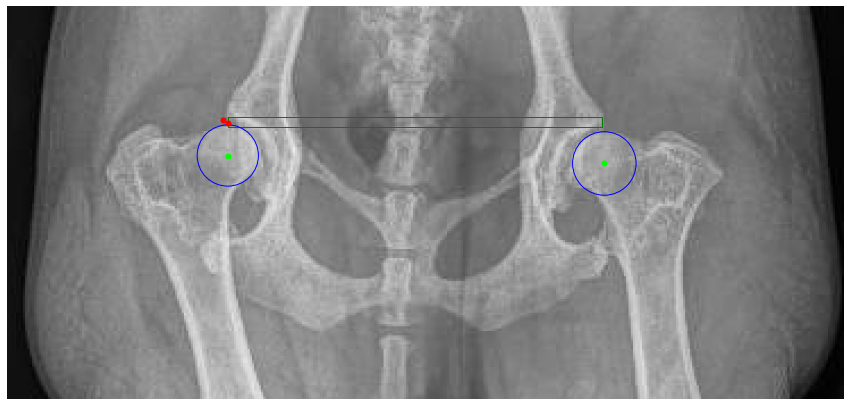

Processing /home/featurize/work/Dataset2/data/Testing/Images/366863.jpeg
FH: [[[192  96]]

 [[460  93]]]


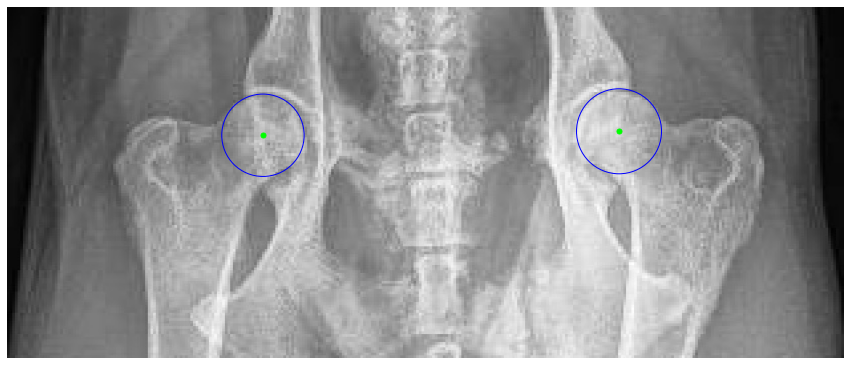

Processing /home/featurize/work/Dataset2/data/Testing/Images/353028.jpeg
CA: [[[182 126]
  [176 119]]]
FH: [[[190 161]]

 [[490 149]]]


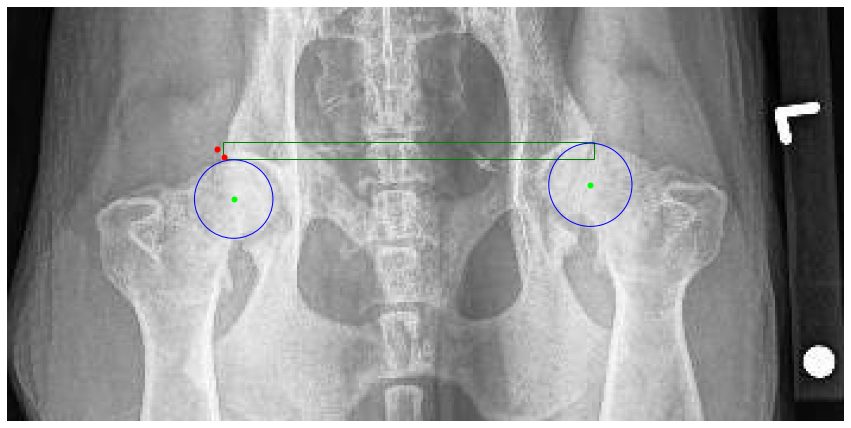

Processing /home/featurize/work/Dataset2/data/Testing/Images/358586.jpeg
FH: [[[120  78]]

 [[333  81]]]


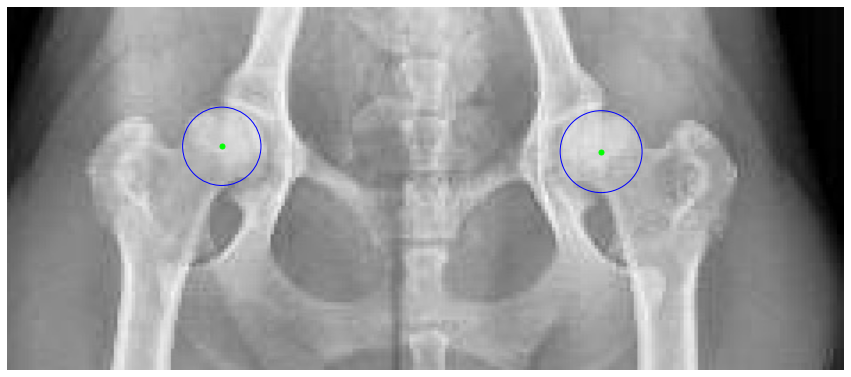

Processing /home/featurize/work/Dataset2/data/Testing/Images/357885.jpeg
CA: [[[200  96]
  [199  95]]]
FH: [[[197 128]]

 [[484 133]]]


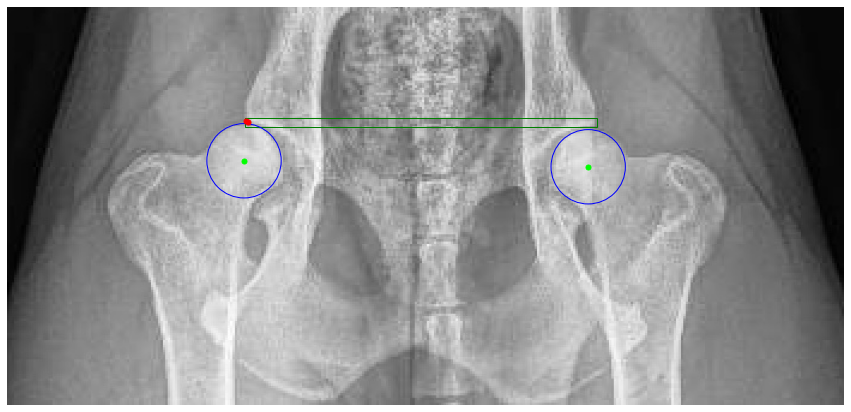

Processing /home/featurize/work/Dataset2/data/Testing/Images/360713.jpeg
FH: [[[185 120]]

 [[497 116]]]


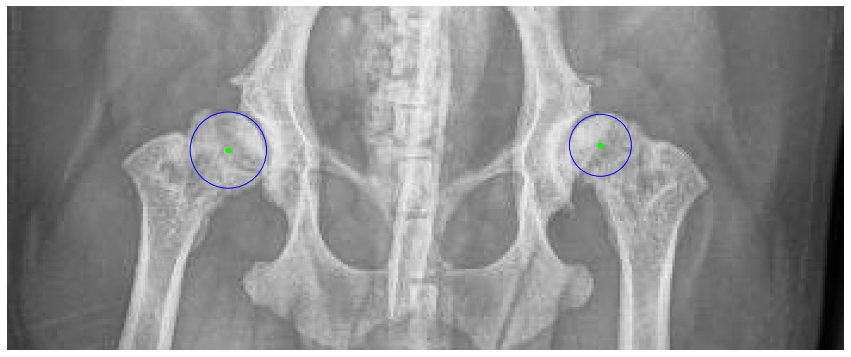

Processing /home/featurize/work/Dataset2/data/Testing/Images/355048.jpeg
FH: [[[548 169]]

 [[212 147]]]


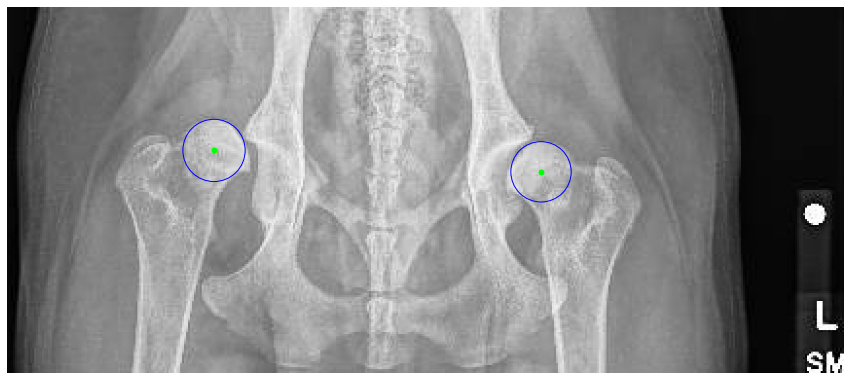

Processing /home/featurize/work/Dataset2/data/Testing/Images/328125.jpeg
CA: [[[481 108]
  [241  90]]]
FH: [[[470 134]]

 [[245 120]]]


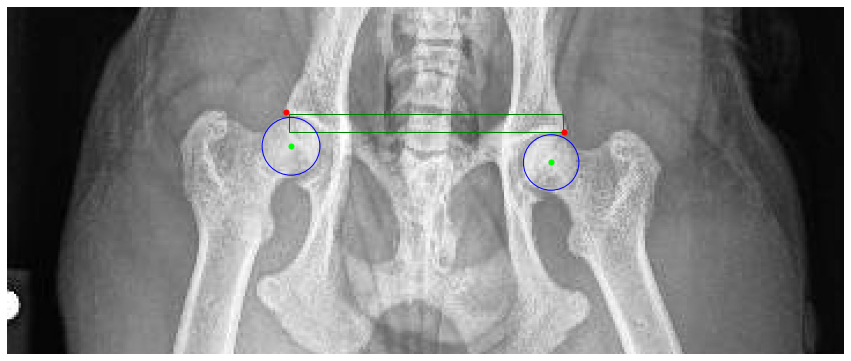

Processing /home/featurize/work/Dataset2/data/Testing/Images/366596.jpeg
FH: [[[617 154]]

 [[208 153]]]


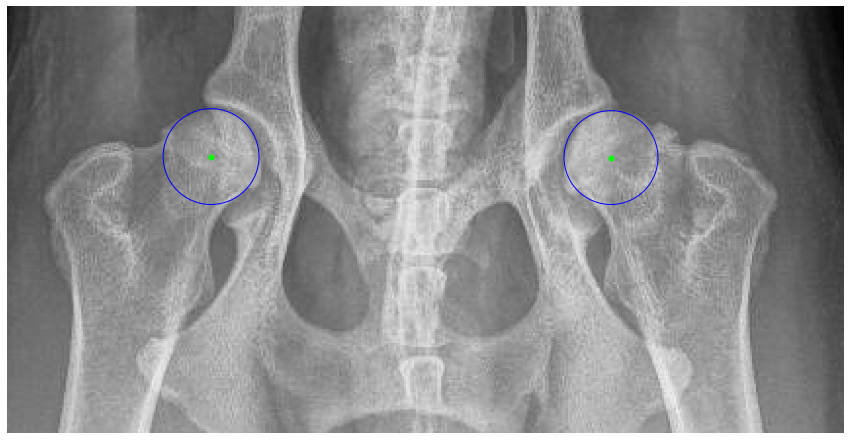

Processing /home/featurize/work/Dataset2/data/Testing/Images/274791.jpeg
CA: [[[553 167]
  [264 166]]]
FH: [[[272 182]]

 [[542 194]]]


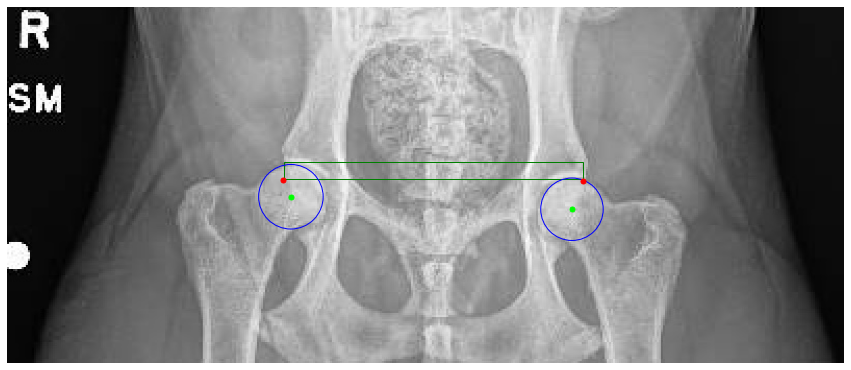

Processing /home/featurize/work/Dataset2/data/Testing/Images/361394.jpeg
FH: [[[399  92]]

 [[144  96]]]


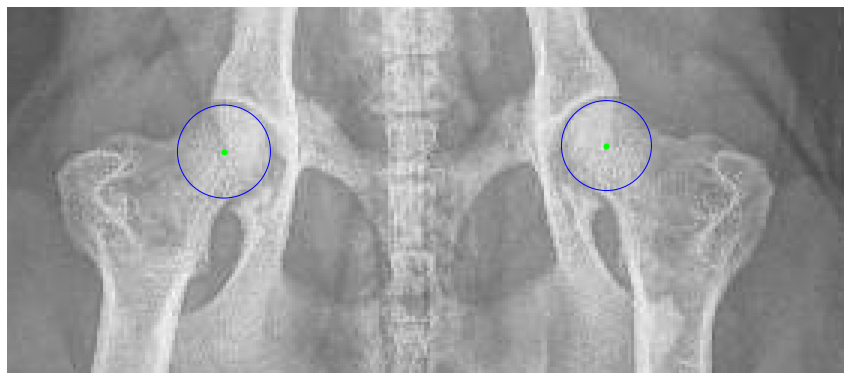

Processing /home/featurize/work/Dataset2/data/Testing/Images/355416.jpeg
FH: [[[487  94]]

 [[184 100]]]


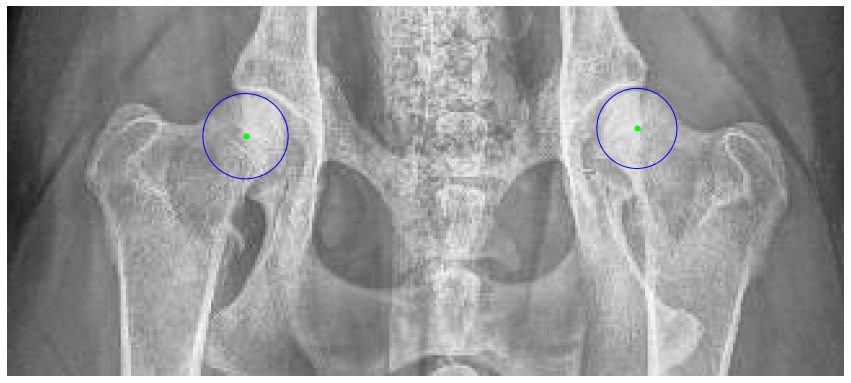

Processing /home/featurize/work/Dataset2/data/Testing/Images/361506.jpeg
FH: [[[167 115]]

 [[492 115]]]


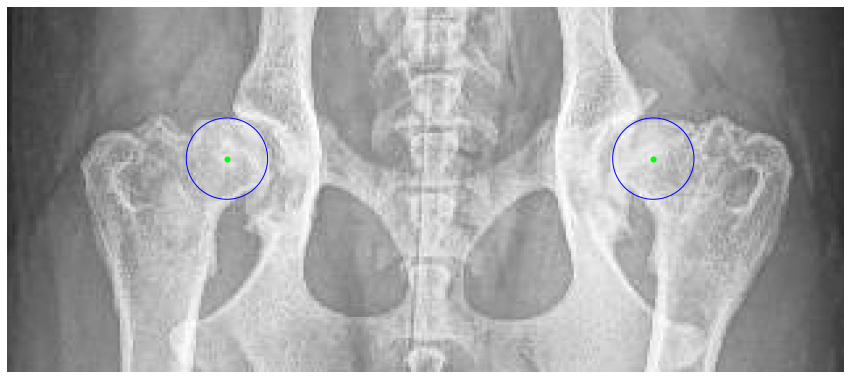

Processing /home/featurize/work/Dataset2/data/Testing/Images/354095.jpeg
CA: [[[427  48]
  [144  51]]]
FH: [[[159 108]]

 [[438  77]]]


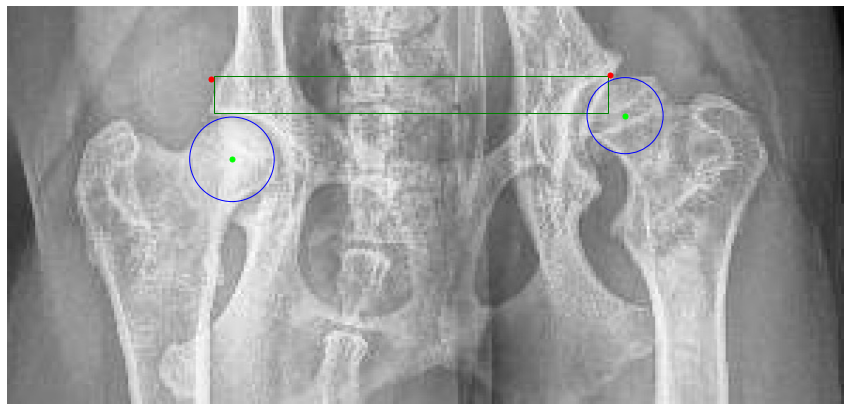

Processing /home/featurize/work/Dataset2/data/Testing/Images/331722.jpeg
CA: [[[664 125]
  [667 125]]]
FH: [[[659 161]]

 [[363 186]]]


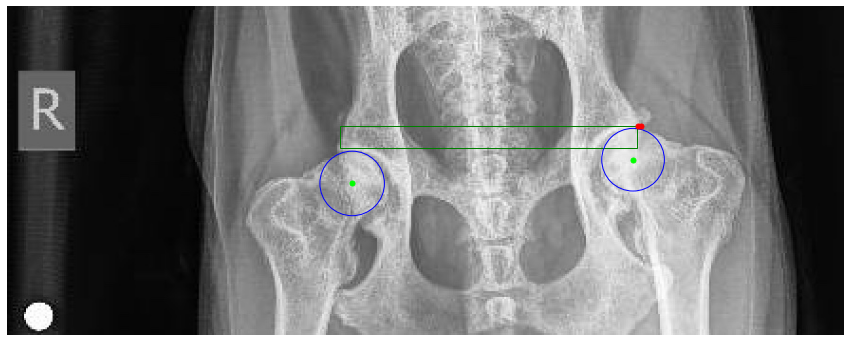

Processing /home/featurize/work/Dataset2/data/Testing/Images/353949.jpg
CA: [[[ 400  289]
  [1309  285]]]
FH: [[[1302  383]]

 [[ 355  301]]]


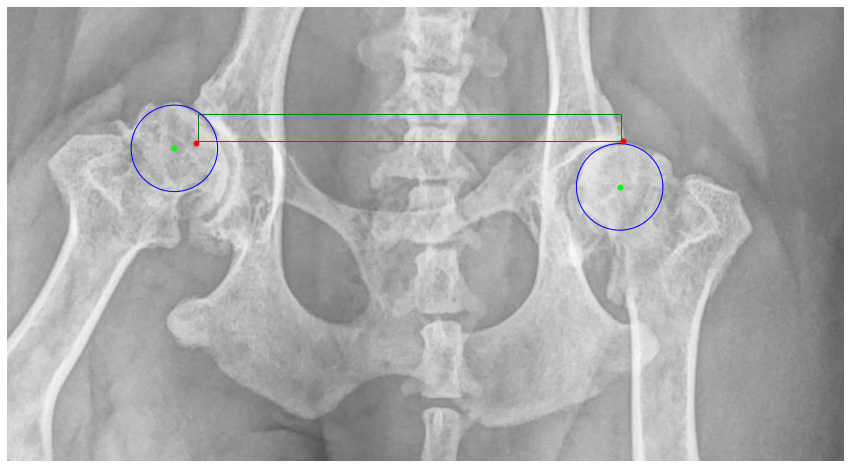

Processing /home/featurize/work/Dataset2/data/Testing/Images/351595.jpeg
CA: [[[456 108]
  [182 129]]]
FH: [[[445 161]]

 [[179 137]]]


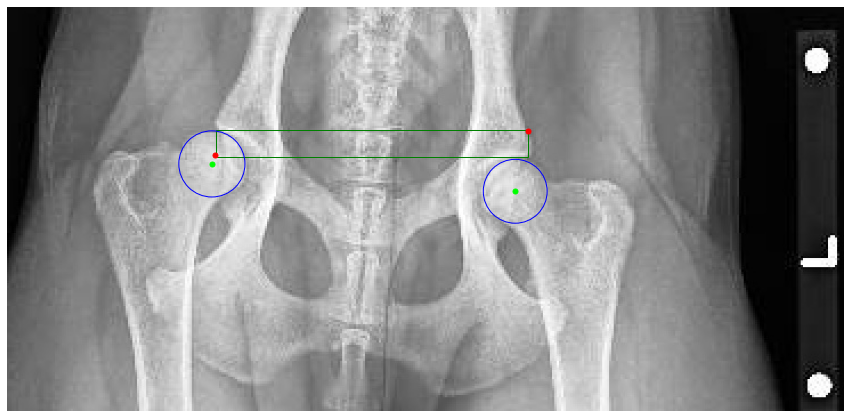

Processing /home/featurize/work/Dataset2/data/Testing/Images/349667.jpeg
CA: [[[510 101]
  [511 109]]]
FH: [[[497 149]]

 [[220 136]]]


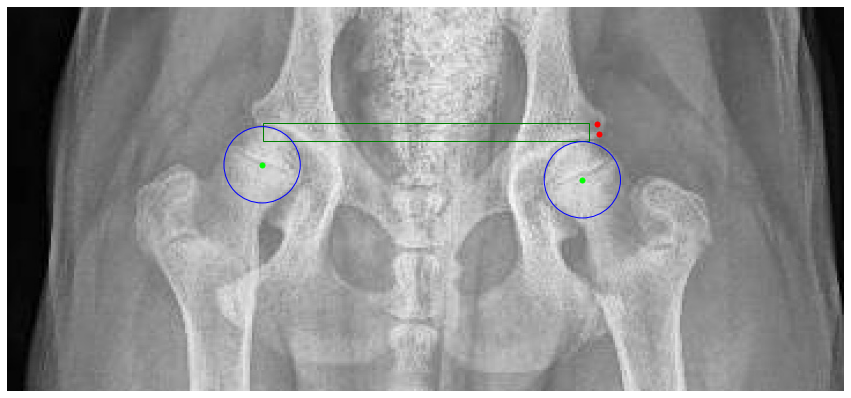

Processing /home/featurize/work/Dataset2/data/Testing/Images/353433.jpeg
FH: [[[520 156]]

 [[209 156]]]


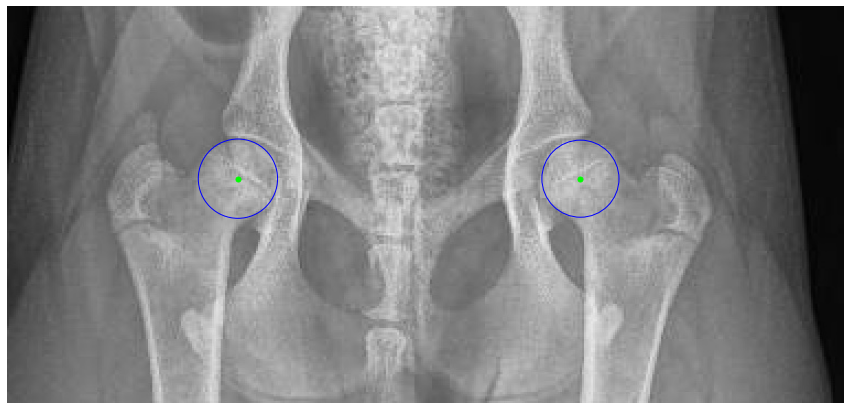

Processing /home/featurize/work/Dataset2/data/Testing/Images/325050.jpg
CA: [[[1155  144]
  [ 358  140]]]
FH: [[[1140  186]]

 [[ 393  233]]]


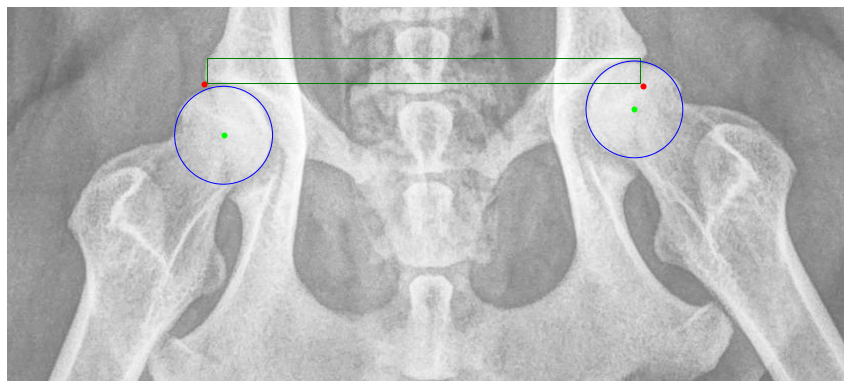

Processing /home/featurize/work/Dataset2/data/Testing/Images/347694.jpeg
CA: [[[498 132]
  [195 109]]]
FH: [[[504 166]]

 [[194 144]]]


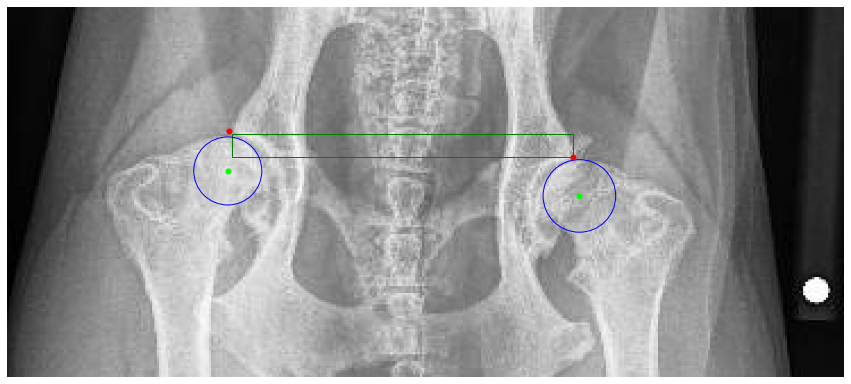

Processing /home/featurize/work/Dataset2/data/Testing/Images/354826.jpg
CA: [[[1111  187]
  [ 389  183]]]
FH: [[[ 419  265]]

 [[1110  213]]]


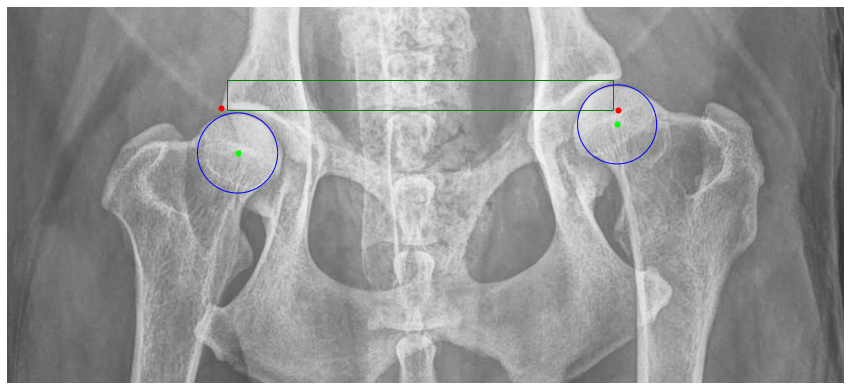

Processing /home/featurize/work/Dataset2/data/Testing/Images/346249.jpg
CA: [[[1057  211]
  [ 303  156]]]
FH: [[[ 345  236]]

 [[1032  298]]]


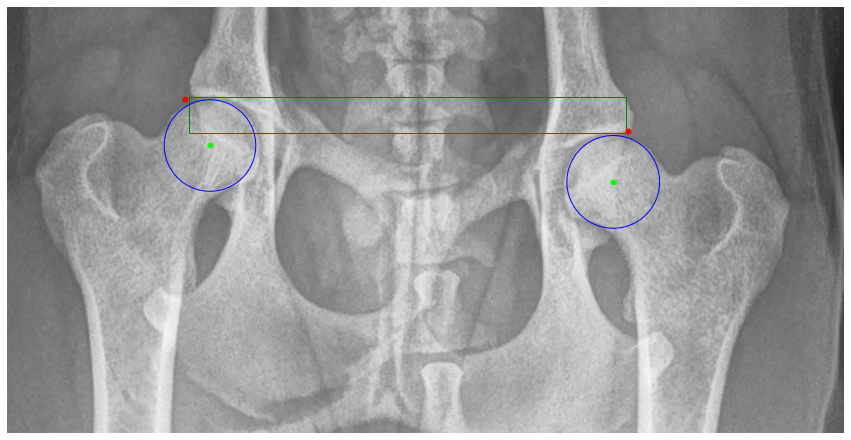

Processing /home/featurize/work/Dataset2/data/Testing/Images/357623.jpg
CA: [[[1062  196]
  [1061  193]]]
FH: [[[1037  276]]

 [[ 362  300]]]


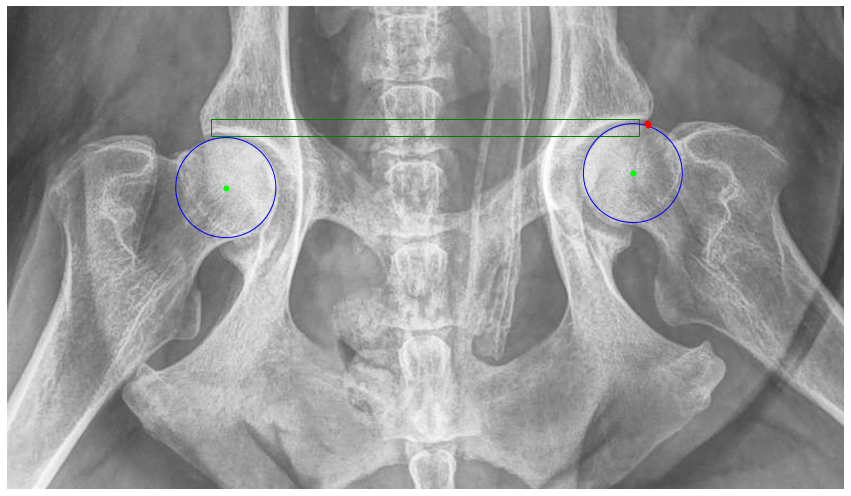

Processing /home/featurize/work/Dataset2/data/Testing/Images/357265.jpeg
CA: [[[203 165]
  [549 165]]]
FH: [[[538 208]]

 [[212 198]]]


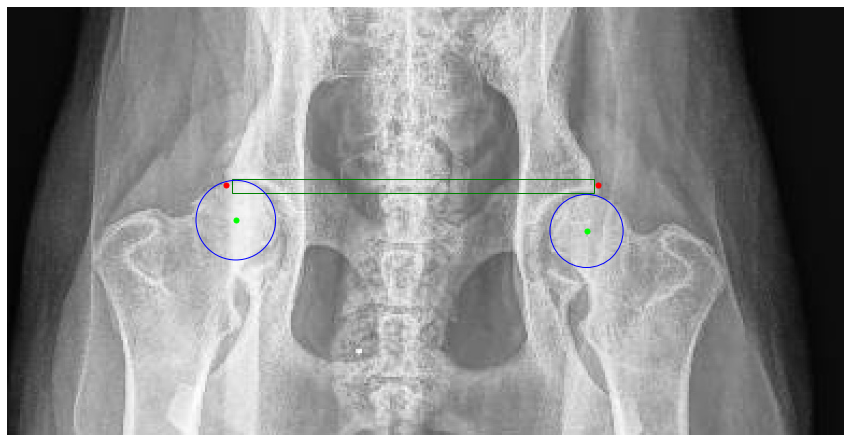

Processing /home/featurize/work/Dataset2/data/Testing/Images/353330.jpeg
CA: [[[511 123]
  [204 122]]]
FH: [[[503 159]]

 [[192 135]]]


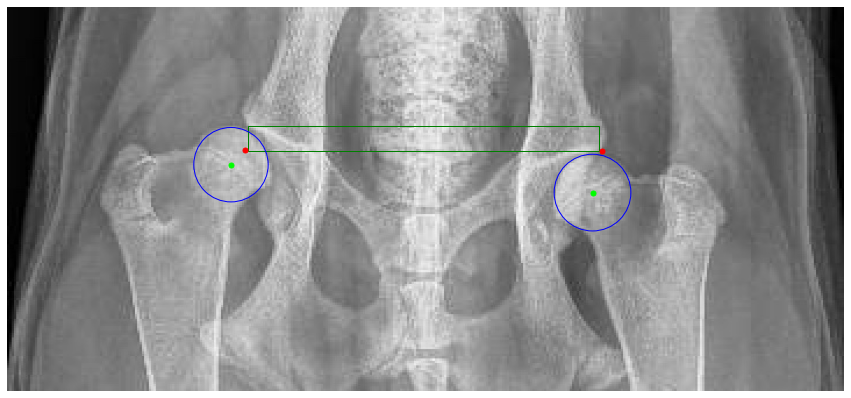

Processing /home/featurize/work/Dataset2/data/Testing/Images/363860.jpeg
CA: [[[141  98]
  [487 118]]]
FH: [[[152 134]]

 [[471 151]]]


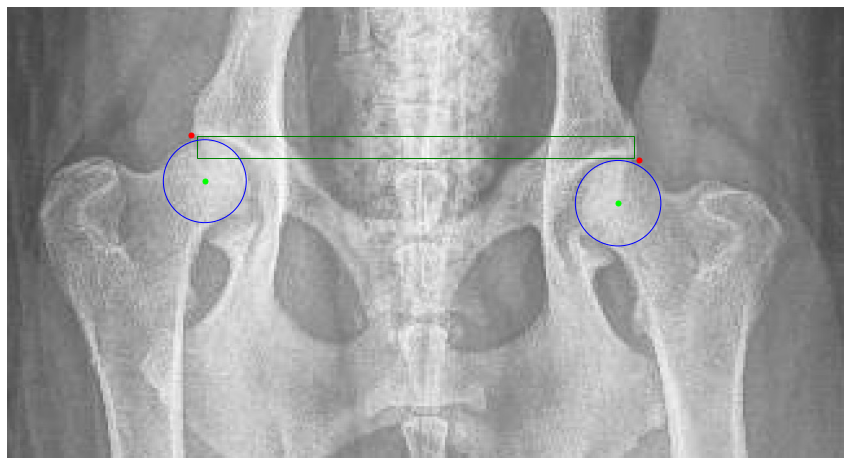

Processing /home/featurize/work/Dataset2/data/Testing/Images/325038.jpeg
FH: [[[301 155]]

 [[580 154]]]


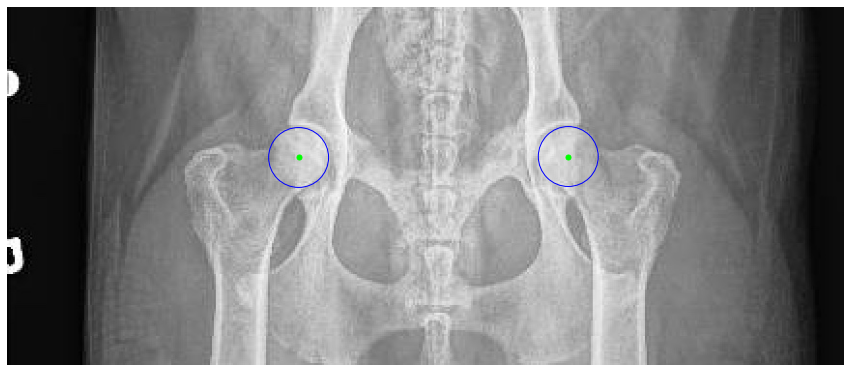

Processing /home/featurize/work/Dataset2/data/Testing/Images/357970.jpeg
CA: [[[453 105]
  [195 104]]]
FH: [[[445 134]]

 [[193 121]]]


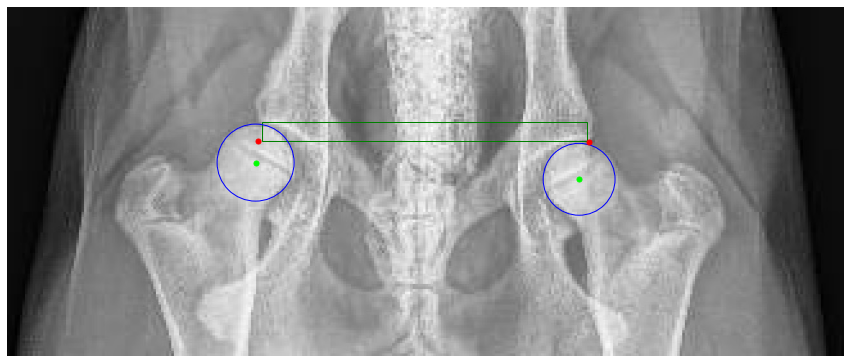

Processing /home/featurize/work/Dataset2/data/Testing/Images/268505.jpeg
CA: [[[584  55]
  [262  55]]]
FH: [[[274  96]]

 [[567 138]]]


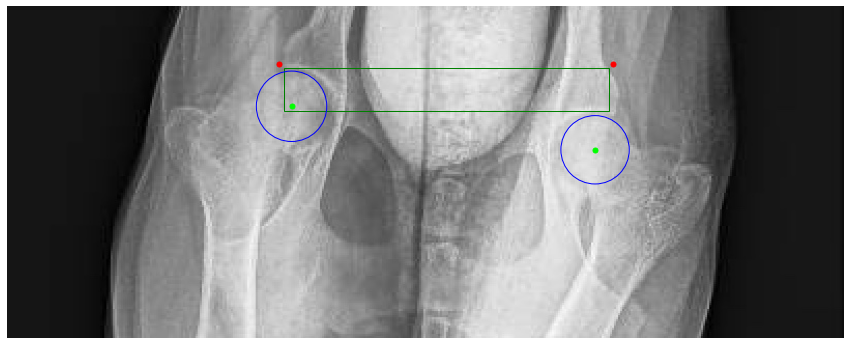

Processing /home/featurize/work/Dataset2/data/Testing/Images/349744.jpeg
CA: [[[239  79]
  [512  78]]]
FH: [[[246 106]]

 [[500 112]]]


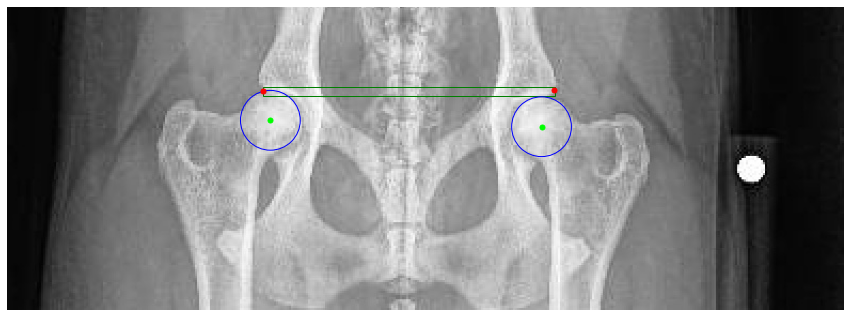

Processing /home/featurize/work/Dataset2/data/Testing/Images/351103.jpeg
FH: [[[432 109]]

 [[191 112]]]


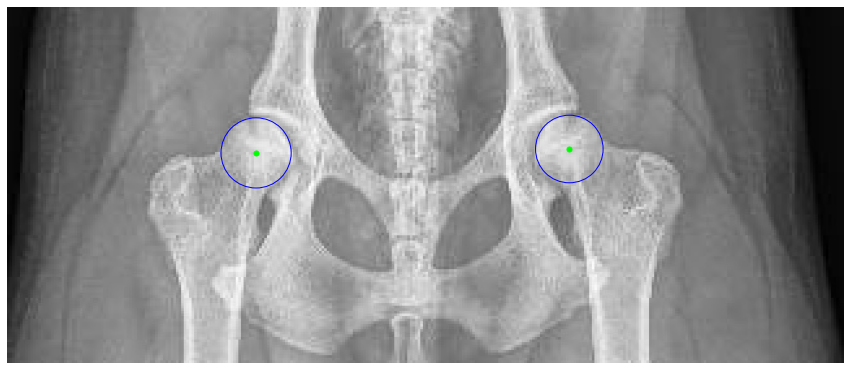

Processing /home/featurize/work/Dataset2/data/Testing/Images/356926.jpeg
CA: [[[476  97]
  [206  97]]]
FH: [[[467 118]]

 [[215 129]]]


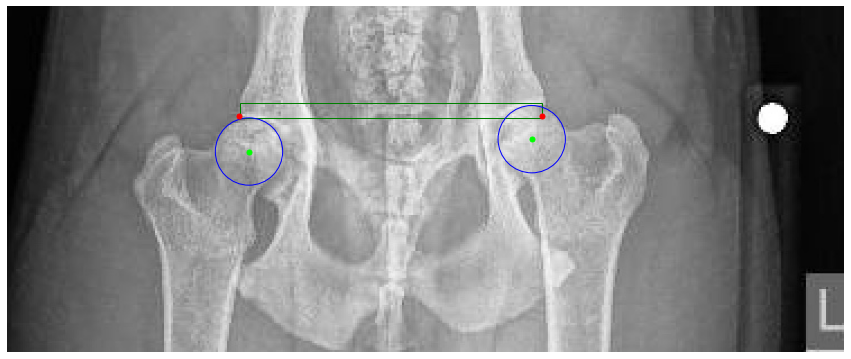

Processing /home/featurize/work/Dataset2/data/Testing/Images/352310.jpeg
FH: [[[541 131]]

 [[196 135]]]


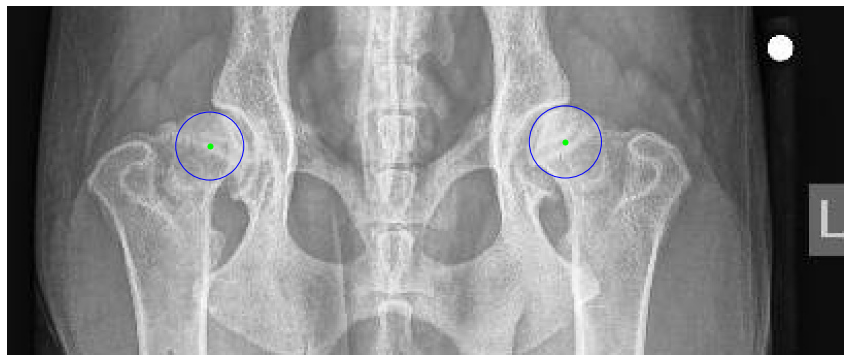

Processing /home/featurize/work/Dataset2/data/Testing/Images/364990.jpeg
CA: [[[164  91]
  [454  92]]]
FH: [[[441 125]]

 [[171 114]]]


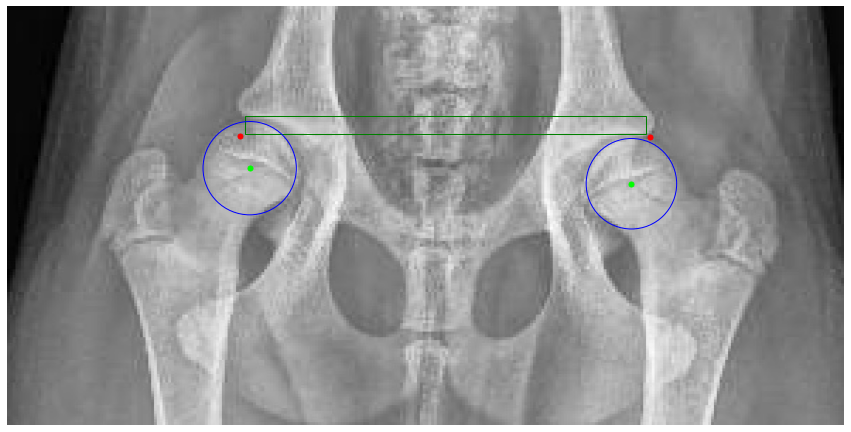

Processing /home/featurize/work/Dataset2/data/Testing/Images/361597.jpeg
FH: [[[388 104]]

 [[160 104]]]


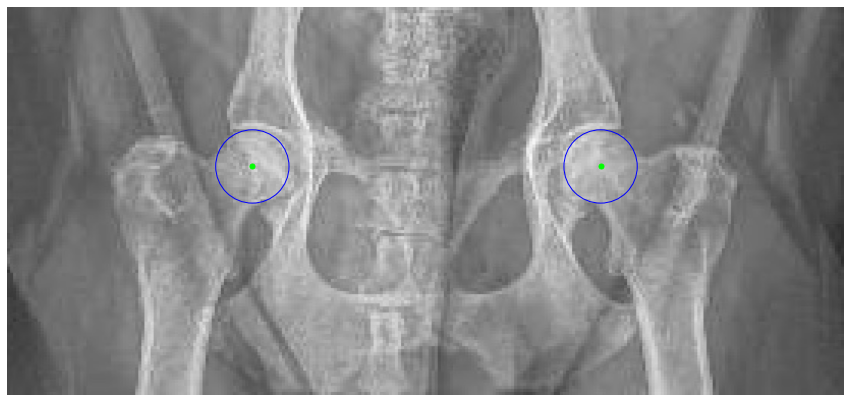

Processing /home/featurize/work/Dataset2/data/Testing/Images/360012.jpeg
FH: [[[142 100]]

 [[409 102]]]


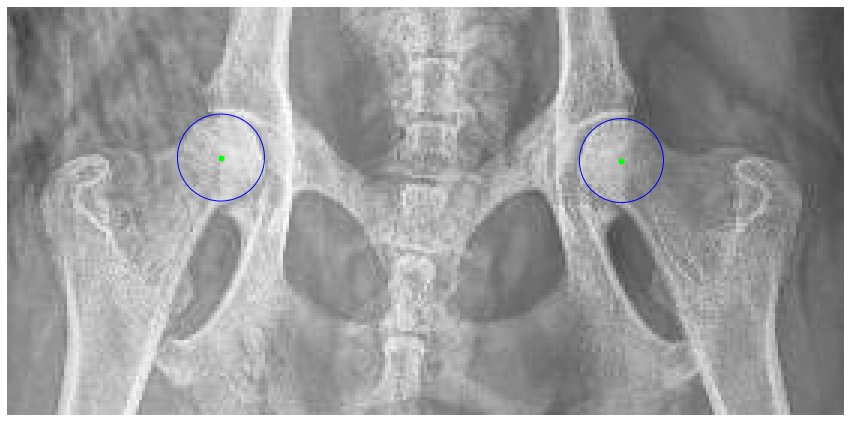

Processing /home/featurize/work/Dataset2/data/Testing/Images/329554.jpeg
CA: [[[267 132]
  [266 130]]]
FH: [[[272 172]]

 [[565 205]]]


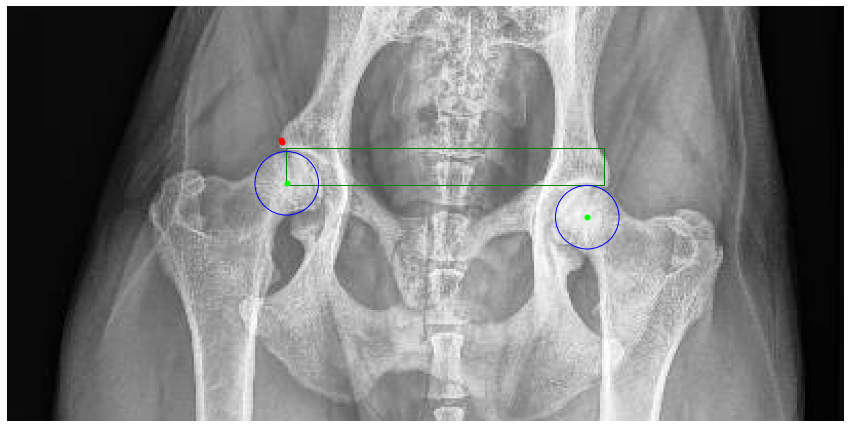

Processing /home/featurize/work/Dataset2/data/Testing/Images/357815.jpeg
CA: [[[414  93]
  [149  94]]]
FH: [[[408 121]]

 [[159 124]]]


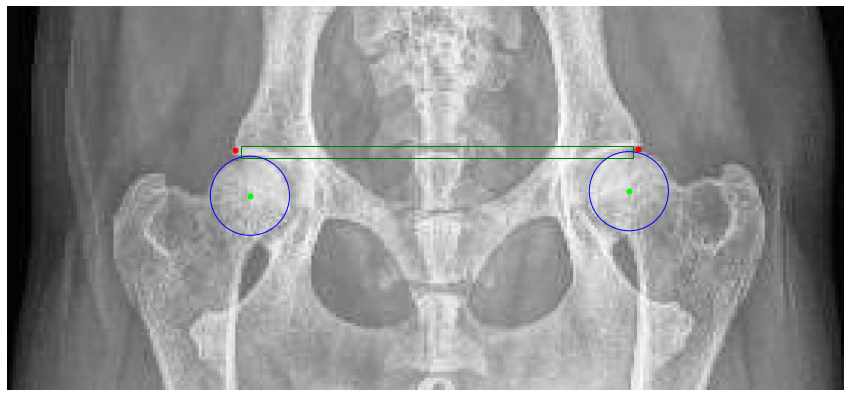

Processing /home/featurize/work/Dataset2/data/Testing/Images/354570.jpeg
CA: [[[284 142]
  [601 143]]]
FH: [[[293 176]]

 [[589 186]]]


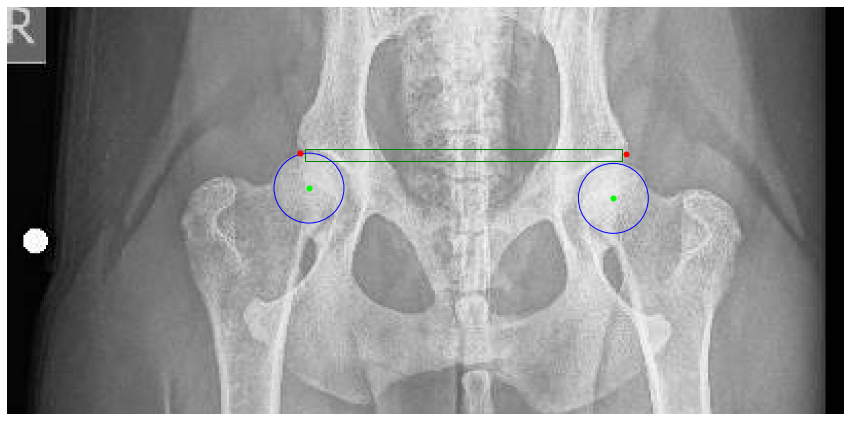

Processing /home/featurize/work/Dataset2/data/Testing/Images/361479.jpeg
CA: [[[178  85]
  [177  85]]]
FH: [[[189 117]]

 [[483 124]]]


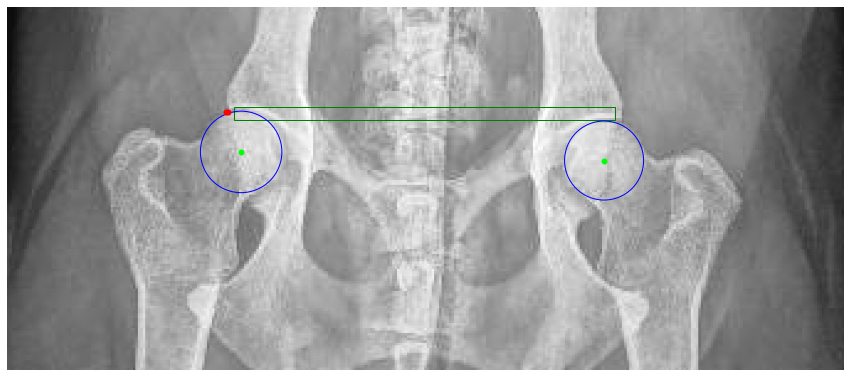

Processing /home/featurize/work/Dataset2/data/Testing/Images/357153.jpeg
FH: [[[536 165]]

 [[239 162]]]


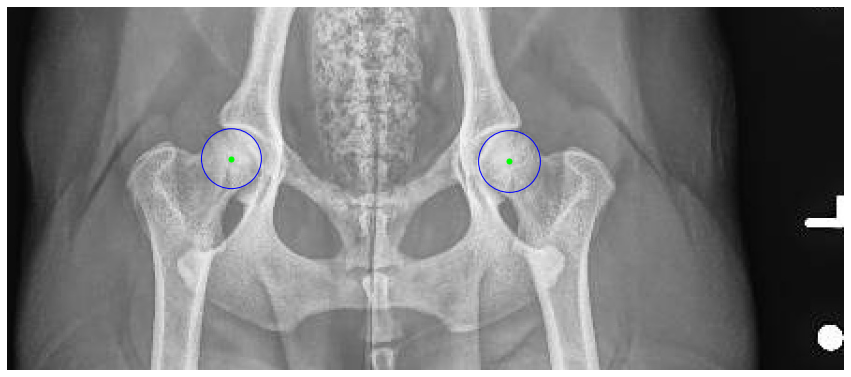

Processing /home/featurize/work/Dataset2/data/Testing/Images/308700.jpg
CA: [[[1076  224]
  [ 321  168]]]
FH: [[[ 345  249]]

 [[1050  307]]]


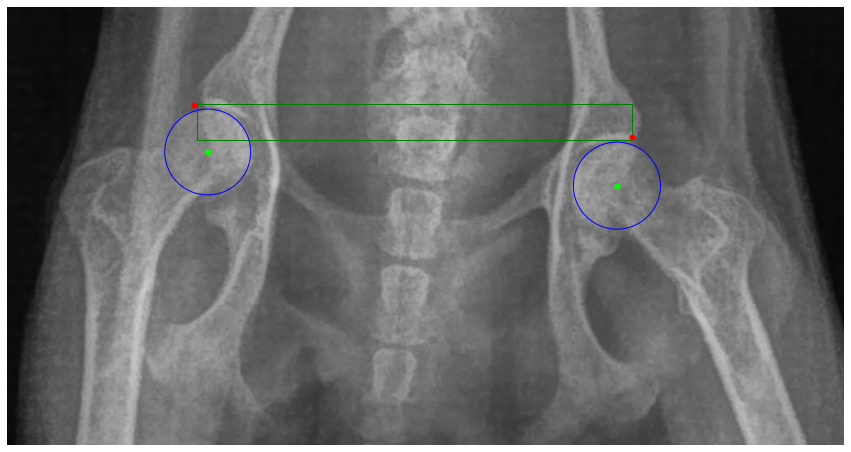

Processing /home/featurize/work/Dataset2/data/Testing/Images/361233.jpeg
CA: [[[507  80]
  [204 102]]]
FH: [[[212 114]]

 [[498 138]]]


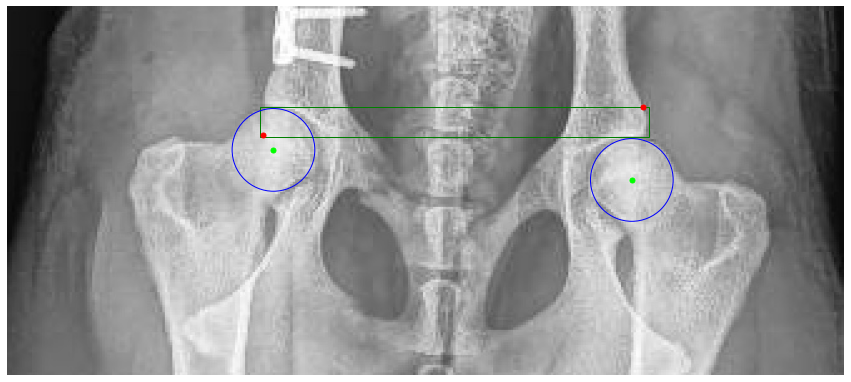

Processing /home/featurize/work/Dataset2/data/Testing/Images/357274.jpeg
CA: [[[441  92]
  [442  75]]]
FH: [[[432 121]]

 [[156 108]]]


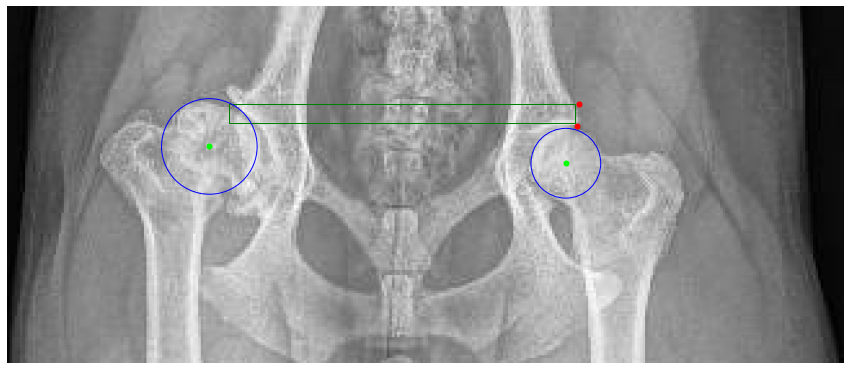

Processing /home/featurize/work/Dataset2/data/Testing/Images/330817.jpeg
CA: [[[470  94]
  [470  93]]]
FH: [[[481 134]]

 [[169 122]]]


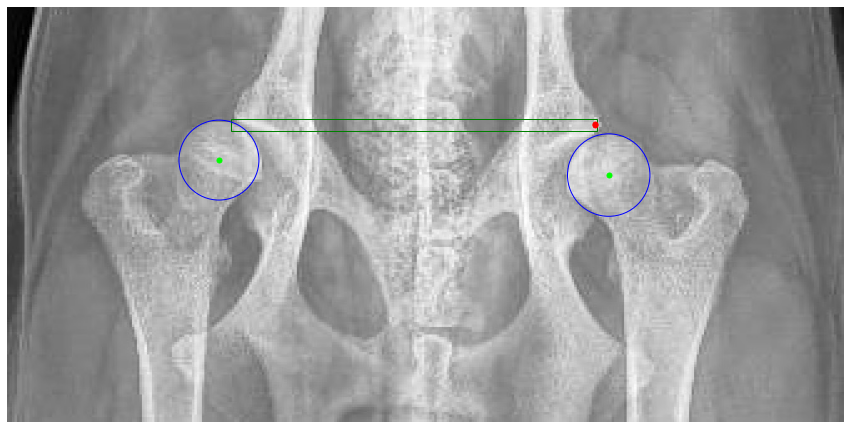

Processing /home/featurize/work/Dataset2/data/Testing/Images/359477.jpeg
CA: [[[209  77]
  [499  76]]]
FH: [[[217  91]]

 [[486 108]]]


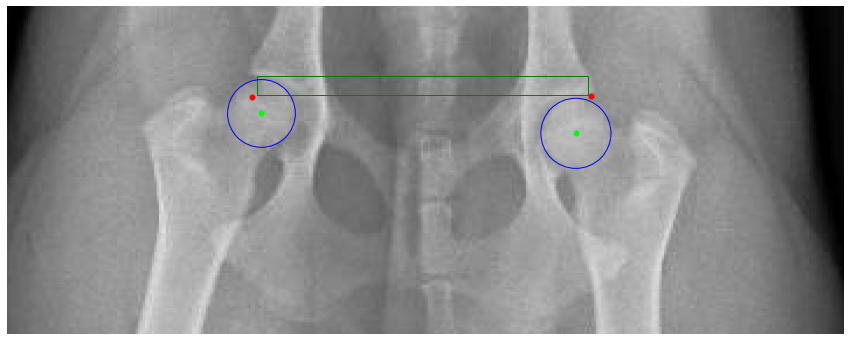

Processing /home/featurize/work/Dataset2/data/Testing/Images/320802.jpeg
FH: [[[595 152]]

 [[293 154]]]


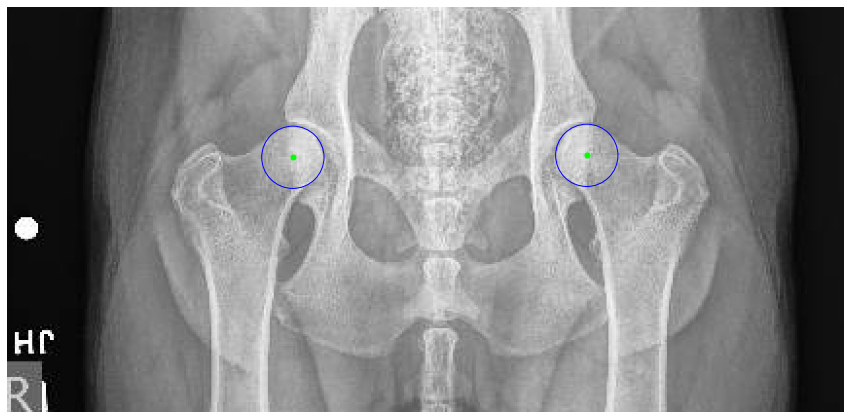

Processing /home/featurize/work/Dataset2/data/Testing/Images/362005.jpeg
CA: [[[427  70]
  [427  69]]]
FH: [[[172 103]]

 [[426  95]]]


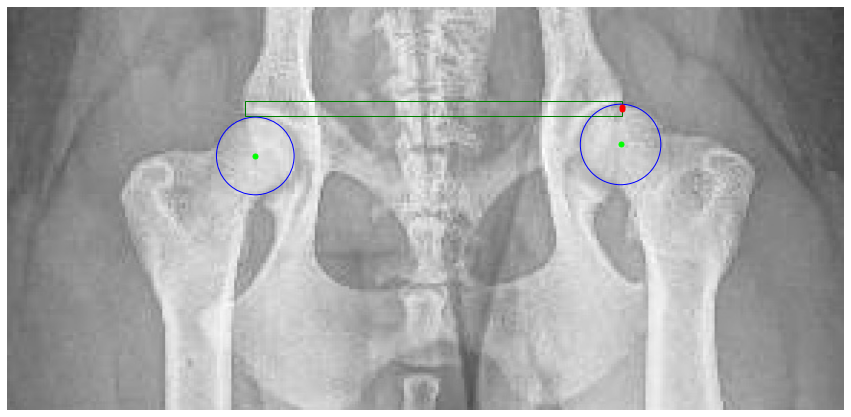

Processing /home/featurize/work/Dataset2/data/Testing/Images/362215.jpeg
CA: [[[476  78]
  [482  60]]]
FH: [[[468 102]]

 [[195 117]]]


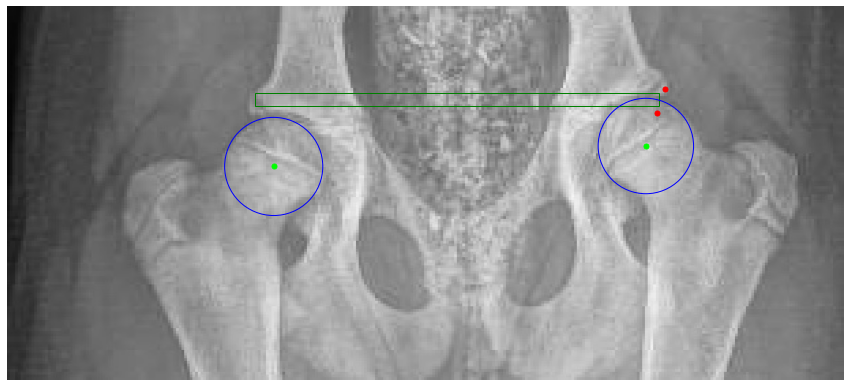

Processing /home/featurize/work/Dataset2/data/Testing/Images/351008.jpeg
CA: [[[390  67]
  [136  74]]]
FH: [[[143 125]]

 [[393 108]]]


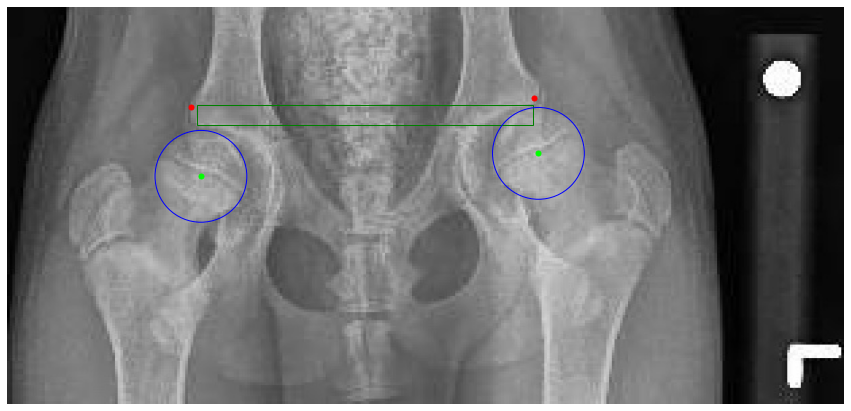

Processing /home/featurize/work/Dataset2/data/Testing/Images/356989.jpeg
FH: [[[215 119]]

 [[518 113]]]


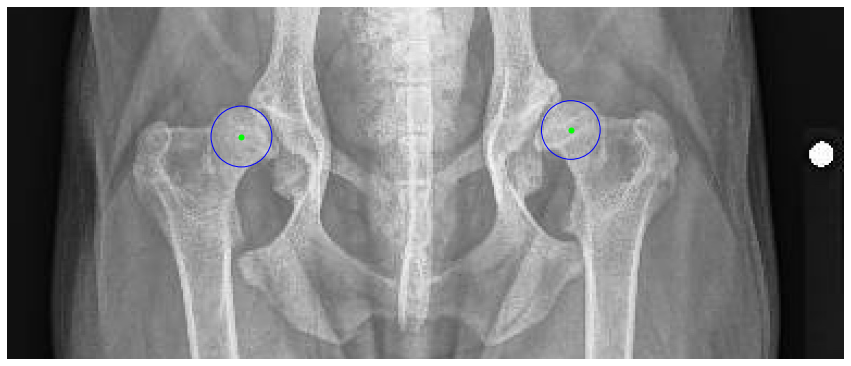

Processing /home/featurize/work/Dataset2/data/Testing/Images/331046.jpeg
FH: [[[531 161]]

 [[212 168]]]


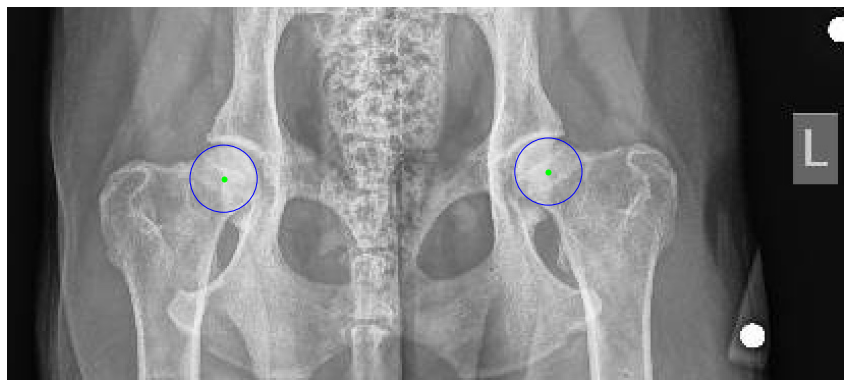

Processing /home/featurize/work/Dataset2/data/Testing/Images/324194.jpeg
CA: [[[497 110]
  [202 109]]]
FH: [[[218 158]]

 [[488 147]]]


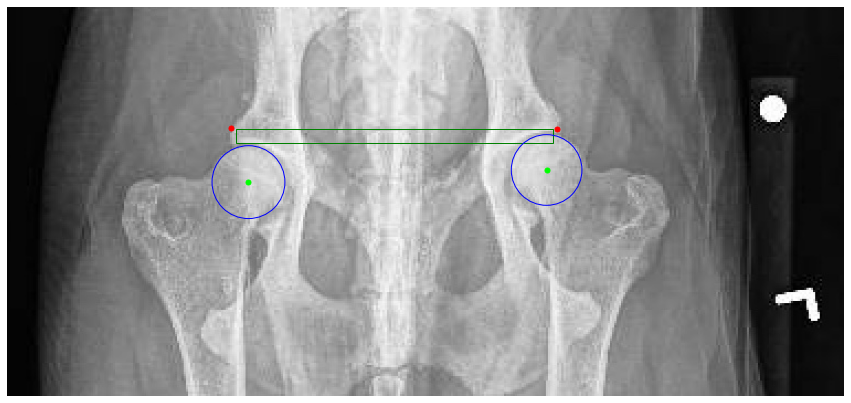

Processing /home/featurize/work/Dataset2/data/Testing/Images/342636.jpeg
FH: [[[482 141]]

 [[216 141]]]


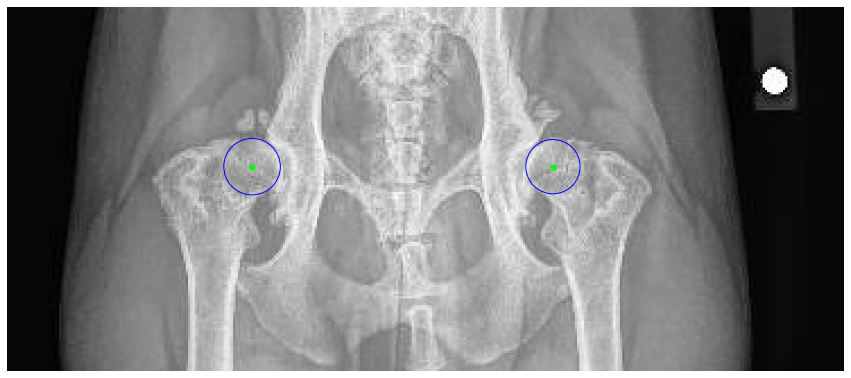

Processing /home/featurize/work/Dataset2/data/Testing/Images/361122.jpg
CA: [[[470 197]
  [471 194]]]
FH: [[[1306  273]]

 [[ 356  159]]]


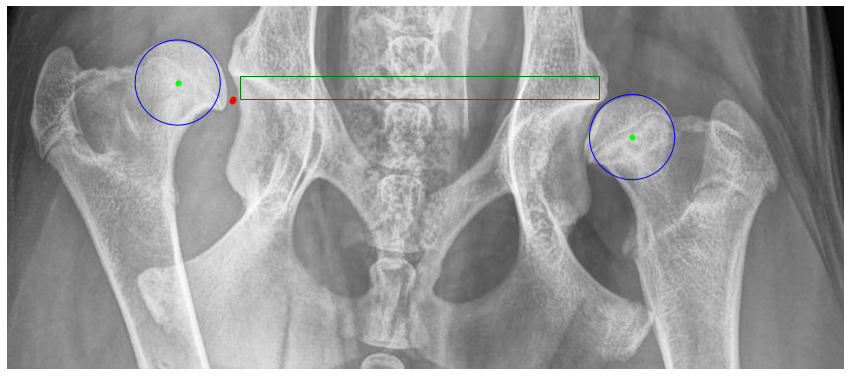

Processing /home/featurize/work/Dataset2/data/Testing/Images/363424.jpeg
CA: [[[465  74]
  [178  73]]]
FH: [[[189 109]]

 [[459 103]]]


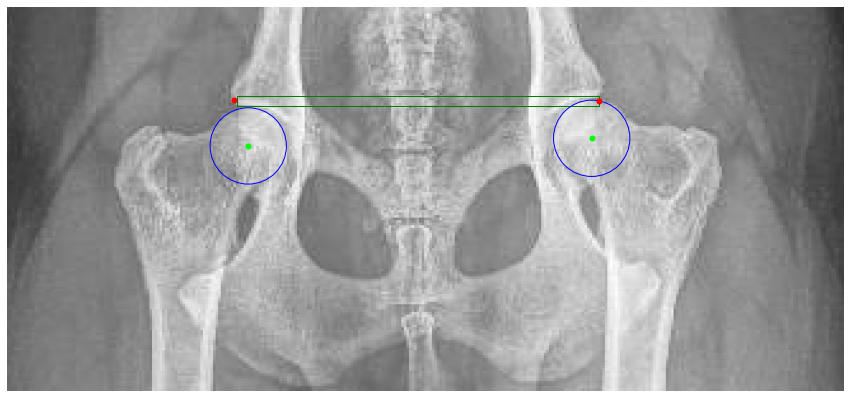

Processing /home/featurize/work/Dataset2/data/Testing/Images/351181.jpeg
CA: [[[452  58]
  [451  72]]]
FH: [[[187 103]]

 [[458  86]]]


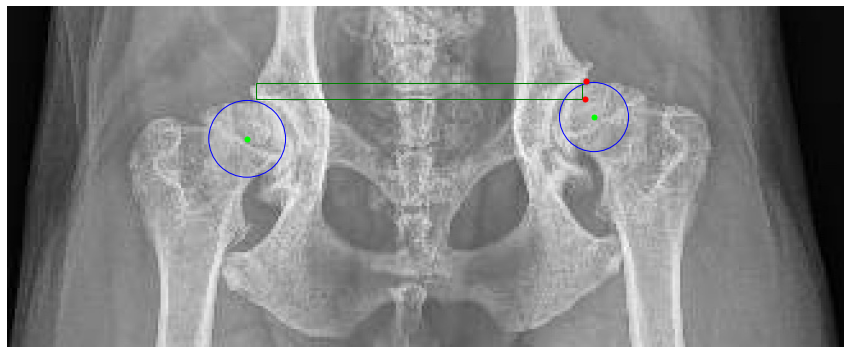

Processing /home/featurize/work/Dataset2/data/Testing/Images/282434.jpeg
FH: [[[527 128]]

 [[255 122]]]


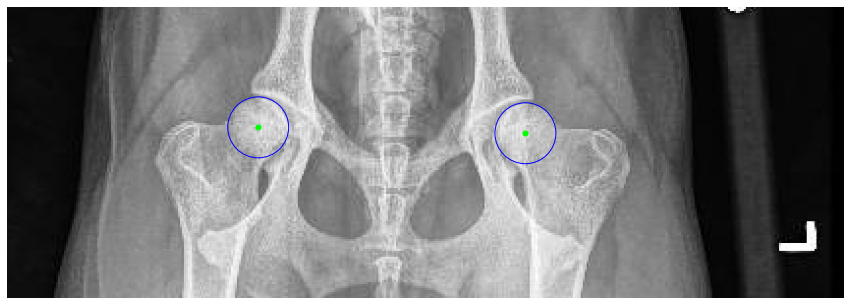

Processing /home/featurize/work/Dataset2/data/Testing/Images/281142.jpeg
CA: [[[266  99]
  [591  92]]]
FH: [[[257 124]]

 [[596 135]]]


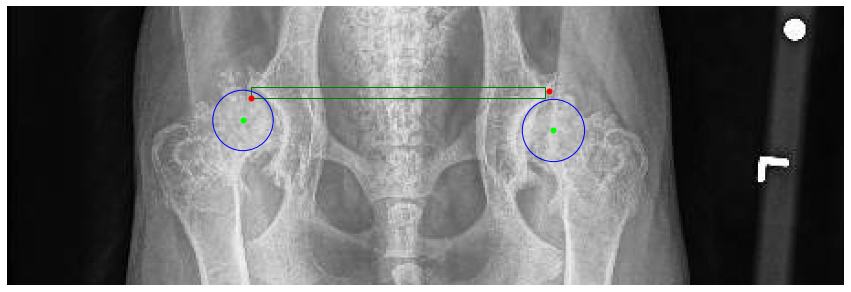

Processing /home/featurize/work/Dataset2/data/Testing/Images/359798.jpeg
CA: [[[139  80]
  [138  78]]]
FH: [[[370 109]]

 [[141  89]]]


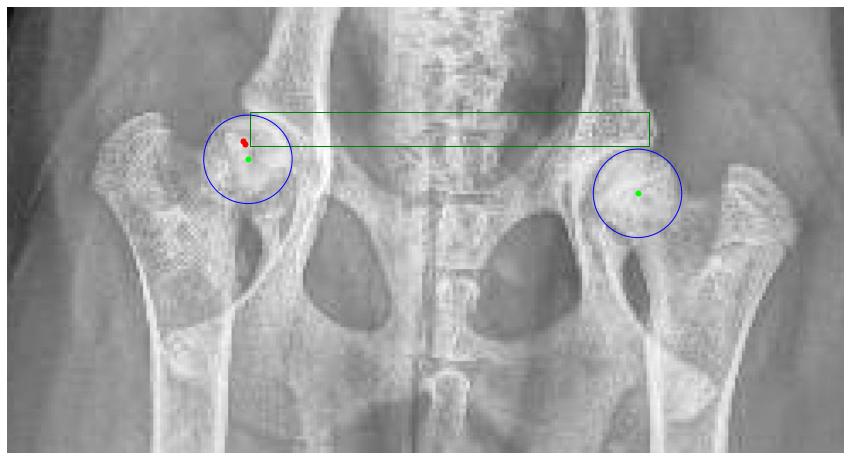

Processing /home/featurize/work/Dataset2/data/Testing/Images/293062.jpeg
CA: [[[189 108]
  [189  88]]]
FH: [[[457 139]]

 [[197 122]]]


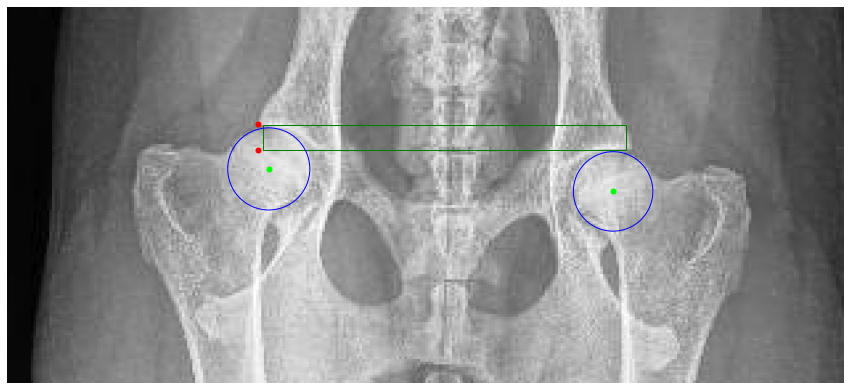

Processing /home/featurize/work/Dataset2/data/Testing/Images/308131.jpeg
CA: [[[595  98]
  [273  98]]]
FH: [[[587 131]]

 [[290 140]]]


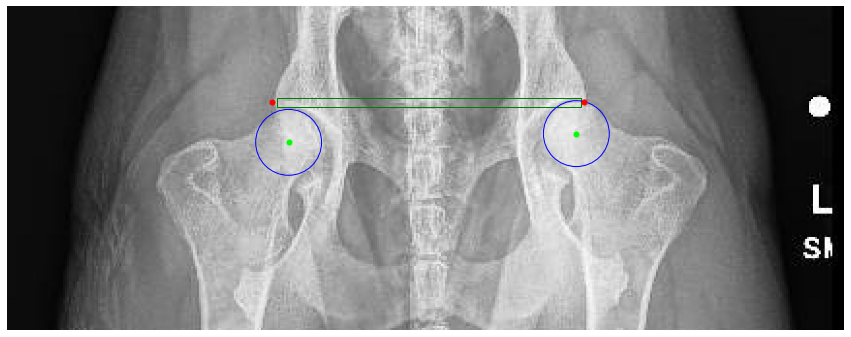

Processing /home/featurize/work/Dataset2/data/Testing/Images/332903.jpeg
FH: [[[305 174]]

 [[552 169]]]


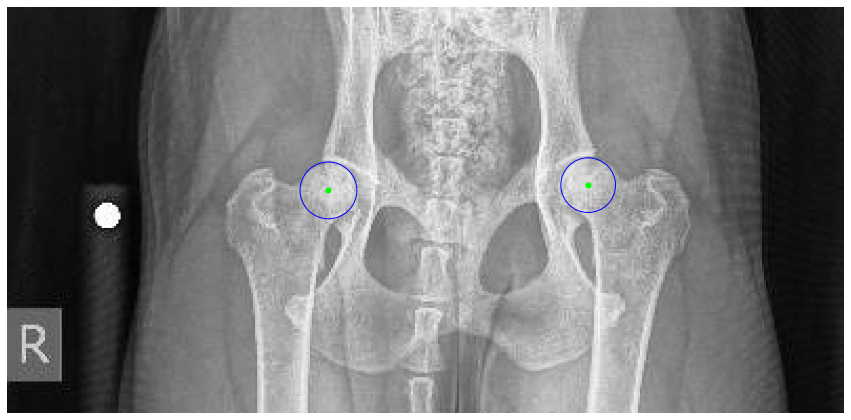

In [20]:
img_dir = '/home/featurize/work/Dataset2/data/Testing/Images'
image_files = [f for f in os.listdir(img_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

colors = [
    (255, 0, 0),    # 红色
    (0, 255, 0),    # 绿色
    (0, 0, 255),    # 蓝色
    (255, 255, 0),  # 黄色
]

for image_file in image_files:
    image_path = os.path.join(img_dir, image_file)
    print(f'Processing {image_path}')
    image = imread(image_path)
    
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    
    ## CA
    detect_result = inference_detector(detector, image_path)
    
    CONF_THRES = 0.3

    pred_instance_CA = detect_result.pred_instances.cpu().numpy()
    bboxes_CA = np.concatenate((pred_instance_CA.bboxes, pred_instance_CA.scores[:, None]), axis=1)
    bboxes_CA = bboxes_CA[np.logical_and(pred_instance_CA.labels == 0, pred_instance_CA.scores > CONF_THRES)]
    bboxes_CA = bboxes_CA[nms(bboxes_CA, 0.3)][:, :4].astype('int')
    
    if len(bboxes_CA) > 0:
        pose_results_CA = inference_topdown(pose_estimator, image_path, bboxes_CA)
        
        try:
            data_samples_CA = merge_data_samples(pose_results_CA)
            CA = data_samples_CA.pred_instances.keypoints.astype('int')
            print(f'CA: {CA}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')
            continue
                
    ## FH   
    
    init_default_scope(detector2.cfg.get('default_scope', 'mmdet'))
    
    ## FH
    detect_result2 = inference_detector(detector2, image_path)
    
    CONF_THRES = 0.5

    pred_instance_FH = detect_result2.pred_instances.cpu().numpy()
    bboxes_FH = np.concatenate((pred_instance_FH.bboxes, pred_instance_FH.scores[:, None]), axis=1)
    bboxes_FH = bboxes_FH[np.logical_and(pred_instance_FH.labels == 0, pred_instance_FH.scores > CONF_THRES)]
    bboxes_FH = bboxes_FH[nms(bboxes_FH, 0.3)][:, :4].astype('int')
    
    if len(bboxes_FH) > 0:
        pose_results_FH = inference_topdown(pose_estimator2, image_path, bboxes_FH)
        
        try:
            data_samples_FH = merge_data_samples(pose_results_FH)
            FH = data_samples_FH.pred_instances.keypoints.astype('int')
            print(f'FH: {FH}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')
            continue
        
    #####plot
    fig, ax = plt.subplots(figsize=(15, 15))  
    ax.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    ax.set_aspect('equal', 'box')

    # 绘制中心关键点和矩形框、圆圈
    if len(bboxes_CA) > 0:
        for idx, bbox in enumerate(bboxes_CA):
            keypoint = CA[idx]
            rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2] - bbox[0], bbox[3] - bbox[1], linewidth=1, edgecolor='g', facecolor='none')
            ax.add_patch(rect)
            
            
            # 绘制关键点
            
            for x, y in keypoint:
                #center_x = x
                #center_y = y
                #radius = min(bbox[2] - bbox[0], bbox[3] - bbox[1]) // 2
                #circle = plt.Circle((center_x, center_y), radius, color='b', fill=False)
                #ax.add_patch(circle)
                ax.plot(x, y, 'o', color=np.array(colors[0])/255.0, markersize=5)

    # 绘制头部关键点
    if len(bboxes_FH) > 0:
        for idx, bbox in enumerate(bboxes_FH):
            keypoint = FH[idx]
            for x, y in keypoint:
                center_x = x
                center_y = y
                radius = max(bbox[2] - bbox[0], bbox[3] - bbox[1]) // 2
                circle = plt.Circle((center_x, center_y), radius, color='b', fill=False)
                ax.add_patch(circle)
                ax.plot(x, y, 'o', color=np.array(colors[1])/255.0, markersize=5)
                
    
    plt.axis('off')
    plt.show()

In [39]:
## Predict
def predict_and_plot(image_path, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center=0.39, conf_thres_head=0.46):
    print(f'Processing {image_path}')
    image = imread(image_path)

    colors = [
        (255, 0, 0),    # 红色
        (0, 255, 0),    # 绿色
        (0, 0, 255),    # 蓝色
        (255, 255, 0),  # 黄色
    ]

    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    
    ## CA
    detect_result = inference_detector(detector, image_path)
    
    pred_instance_CA = detect_result.pred_instances.cpu().numpy()
    bboxes_CA = np.concatenate((pred_instance_CA.bboxes, pred_instance_CA.scores[:, None]), axis=1)
    bboxes_CA = bboxes_CA[np.logical_and(pred_instance_CA.labels == 0, pred_instance_CA.scores > conf_thres_head)]
    bboxes_CA = bboxes_CA[nms(bboxes_CA, 0.3)][:, :4].astype('int')

    if len(bboxes_CA) > 0:
        pose_results_CA = inference_topdown(pose_estimator, image_path, bboxes_CA)

        try:
            data_samples_CA = merge_data_samples(pose_results_CA)
            CA = data_samples_CA.pred_instances.keypoints.astype('int')
            #print(f'center: {center}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')

    ## FH   
    init_default_scope(detector2.cfg.get('default_scope', 'mmdet'))
    
    ## CA
    detect_result = inference_detector(detector2, image_path)
    pred_instance_FH = detect_result.pred_instances.cpu().numpy()
    bboxes_FH = np.concatenate((pred_instance_FH.bboxes, pred_instance_FH.scores[:, None]), axis=1)
    bboxes_FH = bboxes_FH[np.logical_and(pred_instance_FH.labels == 0, pred_instance_FH.scores > conf_thres_center)]
    bboxes_FH = bboxes_FH[nms(bboxes_FH, 0.3)][:, :4].astype('int')
    
    if len(bboxes_FH) > 0:
        pose_results_FH = inference_topdown(pose_estimator2, image_path, bboxes_FH)

        try:
            data_samples_FH = merge_data_samples(pose_results_FH)
            FH = data_samples_FH.pred_instances.keypoints.astype('int')
            #print(f'head: {head}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')

    #####plot
    fig, ax = plt.subplots(figsize=(15, 15))  
    ax.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    ax.set_aspect('equal', 'box')

    # 绘制中心关键点和矩形框、圆圈
    if len(bboxes_CA) > 0:
        print('len(bboxes_CA) :',len(bboxes_CA) )
        for idx, bbox in enumerate(bboxes_CA):
            keypoint = CA[idx]
            print('head:',keypoint)
            print(keypoint[0])
            for x, y in keypoint:
                # center_x = x
                # center_y = y
                # radius = min(bbox[2] - bbox[0], bbox[3] - bbox[1]) // 2
                # circle = plt.Circle((center_x, center_y), radius, color='b', fill=False)
                # ax.add_patch(circle)
                rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2] - bbox[0], bbox[3] - bbox[1], linewidth=1, edgecolor='g', facecolor='none')
                ax.add_patch(rect)
                ax.plot(x, y, 'o', color=np.array(colors[0])/255.0, markersize=5)

    # 
    if len(bboxes_FH) > 0:
        print('len(bboxes_FH) :',len(bboxes_FH) )
        for idx, bbox in enumerate(bboxes_FH):
            keypoint = FH[idx]
            print('center:',keypoint[0][1])
            for x, y in keypoint:
                center_x = x
                center_y = y
                radius = min(bbox[2] - bbox[0], bbox[3] - bbox[1]) // 2
                circle = plt.Circle((center_x, center_y), radius, color='b', fill=False)
                ax.add_patch(circle)
                ax.plot(x, y, 'o', color=np.array(colors[1])/255.0, markersize=5)

    plt.axis('off')
    plt.show()

In [83]:
image_path = '/home/featurize/work/Dataset2/data/Testing/Images/251256.jpg'
init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    
    ## CA
detect_result = inference_detector(detector, image_path)
    
pred_instance_CA = detect_result.pred_instances.cpu().numpy()
bboxes_CA = np.concatenate((pred_instance_CA.bboxes, pred_instance_CA.scores[:, None]), axis=1)
bboxes_CA = bboxes_CA[np.logical_and(pred_instance_CA.labels == 0, pred_instance_CA.scores > 0.5)]
bboxes_CA = bboxes_CA[nms(bboxes_CA, 0.3)][:, :4].astype('int')

if len(bboxes_CA) > 0:
    pose_results_CA = inference_topdown(pose_estimator, image_path, bboxes_CA)

    try:
        data_samples_CA = merge_data_samples(pose_results_CA)
        CA = data_samples_CA.pred_instances.keypoints.astype('int')
            #print(f'center: {center}')
    except ValueError as e:
        print(f'Error merging data samples: {e}')


In [87]:
pred_instance_CA

<InstanceData(

    META INFORMATION

    DATA FIELDS
    scores: array([0.99977714, 0.9996153 , 0.976605  , 0.20392154], dtype=float32)
    bboxes: array([[ 941.77356,  220.64816, 1092.8102 ,  371.955  ],
               [ 236.0979 ,  138.00458,  377.11267,  279.71835],
               [ 285.88242,  123.47344, 1102.0386 ,  203.19344],
               [ 305.8049 ,  153.14505, 1082.1006 ,  225.53484]], dtype=float32)
    labels: array([1, 1, 0, 0])
) at 0x7fd72a571050>

In [85]:
pose_results_CA

[<PoseDataSample(
 
     META INFORMATION
     img_shape: (672, 1430)
     input_size: (1024, 1024)
     ori_shape: (672, 1430)
     img_path: '/home/featurize/work/Dataset2/data/Testing/Images/251256.jpg'
     flip_indices: [0, 1]
 
     DATA FIELDS
     gt_instance_labels: <InstanceData(
         
             META INFORMATION
         
             DATA FIELDS
         ) at 0x7fd72a5854d0>
     pred_instances: <InstanceData(
         
             META INFORMATION
         
             DATA FIELDS
             bboxes: array([[ 285,  123, 1102,  203]])
             keypoints: array([[[1067.49291992,  103.65979004],
                         [ 319.00842285,  103.65979004]]])
             bbox_scores: array([1.], dtype=float32)
             keypoint_scores: array([[0.4068591, 0.3901863]], dtype=float32)
         ) at 0x7fd72a585210>
     gt_instances: <InstanceData(
         
             META INFORMATION
         
             DATA FIELDS
             bboxes: array([[ 285,  123, 1102,

In [88]:
bboxes = np.array([[ 305.8049 ,  153.14505, 1082.1006 ,  225.53484]])  # 边界框数组
keypoints = np.array([[[1067.49291992,  103.65979004],
                       [319.00842285,  103.65979004]]])  # 关键点数组

# 检查关键点是否在边界框内
for i, bbox in enumerate(bboxes):
    x1, y1, x2, y2 = bbox
    for kp in keypoints[i]:
        x, y = kp
        if x1 <= x <= x2 and y1 <= y <= y2:
            print(f"Keypoint ({x}, {y}) is inside the box ({x1}, {y1}, {x2}, {y2}).")
        else:
            print(f"Keypoint ({x}, {y}) is outside the box ({x1}, {y1}, {x2}, {y2}).")

Keypoint (1067.49291992, 103.65979004) is outside the box (305.8049, 153.14505, 1082.1006, 225.53484).
Keypoint (319.00842285, 103.65979004) is outside the box (305.8049, 153.14505, 1082.1006, 225.53484).


Processing /home/featurize/work/Dataset2/data/Testing/Images/251256.jpg
len(bboxes_CA) : 1
head: [[ 333  112]
 [1082  224]]
[333 112]
len(bboxes_FH) : 2
center: 290
center: 205


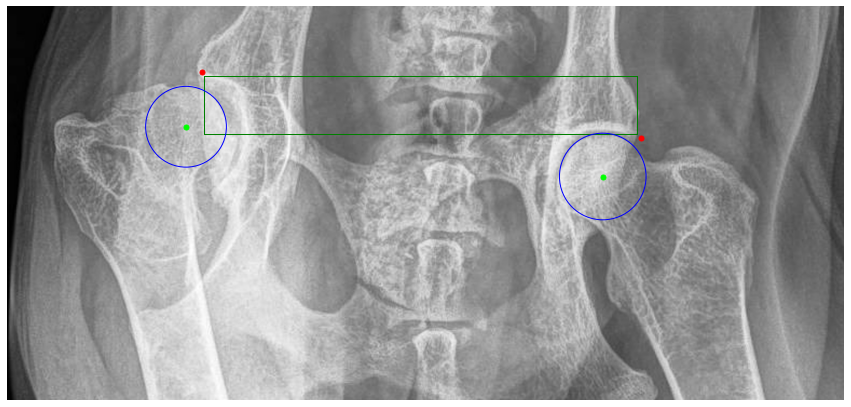

In [40]:
image_path = '/home/featurize/work/Dataset2/data/Testing/Images/251256.jpg'

predict_and_plot(image_path, detector,detector2, pose_estimator, pose_estimator2, 
                 conf_thres_center=0.5, conf_thres_head=0.3)

Processing /home/featurize/work/Dataset2/data/Testing/Images/356926.jpeg


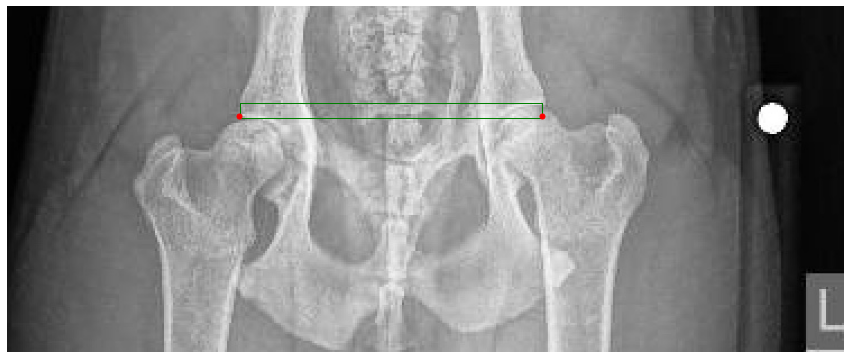

In [17]:
image_path = '/home/featurize/work/Dataset2/data/Testing/Images/356926.jpeg'
predict_and_plot(image_path, detector, detector, pose_estimator, pose_estimator2, 
                 conf_thres_center=0.5, conf_thres_head=0.1)

In [54]:
def calculate_angle(center, head, opposite_center):
    """
    Calculate the angle formed by the three points: center1, head, and opposite_center.
    
    Parameters:
    - center1: The first center point.
    - head: The head point.
    - opposite_center: The opposite center point.
    
    Returns:
    - angle in degrees.
    """
    center = np.array(center)
    head = np.array(head)
    opposite_center = np.array(opposite_center)
    
    # Vector from center1 to head
    vector1 = head - center
    # Vector from center1 to opposite_center
    vector2 = opposite_center - center
    
    # Calculate the cosine of the angle using dot product and norms
    cos_angle = np.dot(vector1, vector2) / (np.linalg.norm(vector1) * np.linalg.norm(vector2))
    
    # Clamp the cosine value to the range [-1, 1] to avoid numerical issues
    cos_angle = np.clip(cos_angle, -1.0, 1.0)
    
    # Calculate the angle in radians and then convert to degrees
    angle = np.arccos(cos_angle)
    return np.degrees(angle)

def predict_and_save(image_path, mat_file_path, detector,detector2, pose_estimator, pose_estimator2, conf_thres_center=0.32, conf_thres_head=0.5):
    image = imread(image_path)
    mat_data = scipy.io.loadmat(mat_file_path)
    four_points = mat_data['Four_points']

    left_head = four_points[2]
    right_head = four_points[3]
    center1 = four_points[0]
    center2 = four_points[1]
    radius1 = four_points[4][0]
    radius2 = four_points[4][1]
    angles = mat_data['Angles']
    
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))

    # Center detection
    detect_result = inference_detector(detector, image_path)
    
    pred_instance_CA = detect_result.pred_instances.cpu().numpy()
    bboxes_CA = np.concatenate((pred_instance_CA.bboxes, pred_instance_CA.scores[:, None]), axis=1)
    bboxes_CA = bboxes_CA[np.logical_and(pred_instance_CA.labels == 0, pred_instance_CA.scores > conf_thres_head)]
    bboxes_CA = bboxes_CA[nms(bboxes_CA, 0.3)][:, :4].astype('int')
    heads_pred = []
    if len(bboxes_CA) > 0:
        pose_results_CA = inference_topdown(pose_estimator, image_path, bboxes_CA)

        try:
            data_samples_CA = merge_data_samples(pose_results_CA)
            heads_pred = data_samples_CA.pred_instances.keypoints.astype('int')
            #print(f'head: {heads_pred}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')

    

    # Head detection
    init_default_scope(detector2.cfg.get('default_scope', 'mmdet'))

    # Center detection
    detect_result2 = inference_detector(detector2, image_path)
    pred_instance_FH = detect_result2.pred_instances.cpu().numpy()
    bboxes_FH = np.concatenate((pred_instance_FH.bboxes, pred_instance_FH.scores[:, None]), axis=1)
    bboxes_FH = bboxes_FH[np.logical_and(pred_instance_FH.labels == 0, pred_instance_FH.scores > conf_thres_center)]
    bboxes_FH = bboxes_FH[nms(bboxes_FH, 0.3)][:, :4].astype('int')
   
    centers_pred = []
    if len(bboxes_FH) > 0:
        pose_results_FH = inference_topdown(pose_estimator2, image_path, bboxes_FH)

        try:
            data_samples_FH = merge_data_samples(pose_results_FH)
            centers_pred = data_samples_FH.pred_instances.keypoints.astype('int')
            #print(f'center: {centers_pred}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')

    


    # Initialize DataFrame with ground truth values
    df = pd.DataFrame({
        'Image Path': [image_path],
        'Left Head X': [left_head[0]],
        'Left Head Y': [left_head[1]],
        'Right Head X': [right_head[0]],
        'Right Head Y': [right_head[1]],
        'Center1 X': [center1[0]],
        'Center1 Y': [center1[1]],
        'Center2 X': [center2[0]],
        'Center2 Y': [center2[1]],
        'Radius1': [radius1],
        'Radius2': [radius2],
        'Angle1': [angles[0][0]],
        'Angle2': [angles[0][1]],
        'Pred Left Head X': [np.nan],
        'Pred Left Head Y': [np.nan],
        'Pred Right Head X': [np.nan],
        'Pred Right Head Y': [np.nan],
        'Pred Center1 X': [np.nan],
        'Pred Center1 Y': [np.nan],
        'Pred Center2 X': [np.nan],
        'Pred Center2 Y': [np.nan],
        'Pred Radius1': [np.nan],
        'Pred Radius2': [np.nan],
        'Pred Angle1': [np.nan],
        'Pred Angle2': [np.nan]
    })

    # Update DataFrame with predicted values if predictions are available
    if len(centers_pred) == 2 and len(heads_pred) == 1:
        #print(len(centers_pred) >= 2)
        #print(len(heads_pred) >= 2)
        # 将预测的点按照x坐标进行排序，确保左边的为left，右边的为right
        centers_pred = sorted(centers_pred, key=lambda p: p[0, 0])
        heads_pred = sorted(heads_pred, key=lambda p: p[0, 0])
        # print('center',centers_pred[0][0])
        # print('head',heads_pred)
        # print('head',heads_pred[0][0])
        # print('head',heads_pred[0][1])
        predicted_radius1 = max(bboxes_FH[0][2] - bboxes_FH[0][0], bboxes_FH[0][3] - bboxes_FH[0][1]) // 2
        predicted_radius2 = max(bboxes_FH[1][2] - bboxes_FH[1][0], bboxes_FH[1][3] - bboxes_FH[1][1]) // 2
        predicted_angle1 = calculate_angle(centers_pred[0][0],heads_pred[0][0], centers_pred[1][0])
        predicted_angle2 = calculate_angle(centers_pred[1][0], heads_pred[0][1], centers_pred[0][0])

        pred_left_head = heads_pred[0][0]
        pred_right_head = heads_pred[0][1]
        pred_center1 = centers_pred[0][0]
        pred_center2 = centers_pred[1][0]

        df.loc[0, 'Pred Left Head X'] = pred_left_head[0]
        df.loc[0, 'Pred Left Head Y'] = pred_left_head[1]
        df.loc[0, 'Pred Right Head X'] = pred_right_head[0]
        df.loc[0, 'Pred Right Head Y'] = pred_right_head[1]
        df.loc[0, 'Pred Center1 X'] = pred_center1[0]
        df.loc[0, 'Pred Center1 Y'] = pred_center1[1]
        df.loc[0, 'Pred Center2 X'] = pred_center2[0]
        df.loc[0, 'Pred Center2 Y'] = pred_center2[1]
        df.loc[0, 'Pred Radius1'] = predicted_radius1
        df.loc[0, 'Pred Radius2'] = predicted_radius2
        df.loc[0, 'Pred Angle1'] = predicted_angle1
        df.loc[0, 'Pred Angle2'] = predicted_angle2

    return df

def process_all_images_and_save(image_dir, label_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center=0.32, conf_thres_head=0.5, output_dir='/home/featurize/work/Result'):
    image_files = [f for f in os.listdir(image_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    all_dfs = []

    for image_file in image_files:
        image_path = os.path.join(image_dir, image_file)
        mat_file_path = os.path.join(label_dir, os.path.splitext(image_file)[0] + '.mat')
        if os.path.exists(mat_file_path):
            df = predict_and_save(image_path, mat_file_path, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center, conf_thres_head)
            all_dfs.append(df)
        else:
            print(f'MAT file for image {image_file} not found.')

    # Combine all dataframes and save to CSV
    final_df = pd.concat(all_dfs, ignore_index=True)
    
    final_df.to_csv(os.path.join(output_dir, 'predictions333.csv'), index=False)
    return final_df

#Example usage
image_dir = '/home/featurize/work/Dataset2/data/Testing/Images'
label_dir = '/home/featurize/work/Dataset2/data/Testing/Labels'
df = process_all_images_and_save(image_dir, label_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center=0.39, conf_thres_head=0.3, output_dir='/home/featurize/work/Result')


In [50]:
df

,Image Path,Left Head X,Left Head Y,Right Head X,Right Head Y,Center1 X,Center1 Y,Center2 X,Center2 Y,Radius1,...,Pred Right Head X,Pred Right Head Y,Pred Center1 X,Pred Center1 Y,Pred Center2 X,Pred Center2 Y,Pred Radius1,Pred Radius2,Pred Angle1,Pred Angle2
0,/home/featurize/work/Dataset2/data/Testing/Ima...,242.723324,105.867347,517.722741,136.778134,225.136152,129.849854,526.249854,166.623032,25.636796,...,517.0,108.0,221.0,130.0,525.0,166.0,27.0,27.0,10.645250,75.393113
1,/home/featurize/work/Dataset2/data/Testing/Ima...,181.967638,103.735569,451.637609,111.196793,167.578134,92.010787,480.949563,104.801458,23.887574,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,/home/featurize/work/Dataset2/data/Testing/Ima...,345.048688,138.909913,684.001458,148.502915,316.269679,172.485423,696.259184,192.737318,37.401170,...,337.0,141.0,317.0,171.0,696.0,193.0,38.0,38.0,51.688609,4.919642
3,/home/featurize/work/Dataset2/data/Testing/Ima...,199.021866,111.196793,449.505831,120.789796,204.351312,142.640525,437.248105,152.766472,26.780135,...,448.0,122.0,203.0,143.0,436.0,152.0,26.0,27.0,103.521974,109.589367
4,/home/featurize/work/Dataset2/data/Testing/Ima...,290.688338,110.130904,617.916327,116.526239,297.616618,150.634694,606.191545,159.694752,35.146070,...,283.0,115.0,295.0,150.0,604.0,157.0,34.0,35.0,7.520363,6.156558
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116,/home/featurize/work/Dataset2/data/Testing/Ima...,271.242046,86.877472,587.173259,97.880052,257.881771,129.315993,596.604041,136.389080,32.489087,...,591.0,92.0,257.0,124.0,596.0,135.0,33.0,34.0,72.059627,81.508982
117,/home/featurize/work/Dataset2/data/Testing/Ima...,141.463848,57.902332,381.288921,80.286006,142.529738,88.813120,371.695918,111.196793,24.538612,...,138.0,78.0,141.0,89.0,370.0,109.0,26.0,26.0,107.520141,2.619486
118,/home/featurize/work/Dataset2/data/Testing/Ima...,191.560641,88.813120,471.889504,105.867347,197.955977,120.789796,456.434111,139.975802,30.185561,...,189.0,88.0,197.0,122.0,457.0,139.0,30.0,31.0,123.485819,7.033536
119,/home/featurize/work/Dataset2/data/Testing/Ima...,278.963557,103.735569,597.664431,94.142566,292.287172,141.041691,588.071429,132.514577,34.460546,...,273.0,98.0,290.0,140.0,587.0,131.0,34.0,34.0,6.104895,7.735212


In [53]:
evaluate_df(df)

Percentage of angles with less than 1 degree error: 4.13%
Percentage of angles with less than 5 degrees error: 15.29%
Percentage of angles with less than 10 degrees error: 21.07%
Percentage of Delta Angle1 < 5: 14.05%
Percentage of Delta Angle2 < 5: 16.53%
Percentage of Delta Angle1 < 10: 19.83%
Percentage of Delta Angle2 < 10: 22.31%


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

In [ ]:
## use different confidience threshold to compute best point

def calculate_angle(center, head, opposite_center):
    """
    Calculate the angle formed by the three points: center1, head, and opposite_center.
    
    Parameters:
    - center1: The first center point.
    - head: The head point.
    - opposite_center: The opposite center point.
    
    Returns:
    - angle in degrees.
    """
    center = np.array(center)
    head = np.array(head)
    opposite_center = np.array(opposite_center)
    
    # Vector from center1 to head
    vector1 = head - center
    # Vector from center1 to opposite_center
    vector2 = opposite_center - center
    
    # Calculate the cosine of the angle using dot product and norms
    cos_angle = np.dot(vector1, vector2) / (np.linalg.norm(vector1) * np.linalg.norm(vector2))
    
    # Clamp the cosine value to the range [-1, 1] to avoid numerical issues
    cos_angle = np.clip(cos_angle, -1.0, 1.0)
    
    # Calculate the angle in radians and then convert to degrees
    angle = np.arccos(cos_angle)
    return np.degrees(angle)

def calculate_error(pred_points, true_points):
    return np.mean(np.linalg.norm(pred_points - true_points, axis=1))

def predict_and_save(image_path, mat_file_path, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range):
    image = imread(image_path)
    mat_data = scipy.io.loadmat(mat_file_path)
    four_points = mat_data['Four_points']

    left_head = four_points[2]
    right_head = four_points[3]
    center1 = four_points[0]
    center2 = four_points[1]
    radius1 = four_points[4][0]
    radius2 = four_points[4][1]
    Angles = mat_data['Angles']
    
    best_df = None
    best_error = float('inf')

    for conf_thres_center in conf_thres_center_range:
        for conf_thres_head in conf_thres_head_range:
            init_default_scope(detector.cfg.get('default_scope', 'mmdet'))

            # Center detection
            detect_result_center = inference_detector(detector, image_path)
            pred_instance_center = detect_result_center.pred_instances.cpu().numpy()
            bboxes_center = np.concatenate((pred_instance_center.bboxes, pred_instance_center.scores[:, None]), axis=1)
            bboxes_center = bboxes_center[np.logical_and(pred_instance_center.labels == 0, pred_instance_center.scores > conf_thres_center)]
            bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')

            centers_pred = []
            if len(bboxes_center) > 0:
                pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
                try:
                    data_samples_center = merge_data_samples(pose_results_center)
                    centers_pred = data_samples_center.pred_instances.keypoints.astype('int')
                except ValueError as e:
                    print(f'Error merging data samples: {e}')

            # Head detection
            init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
            detect_result_head = inference_detector(detector2, image_path)
            pred_instance_head = detect_result_head.pred_instances.cpu().numpy()
            bboxes_head = np.concatenate((pred_instance_head.bboxes, pred_instance_head.scores[:, None]), axis=1)
            bboxes_head = bboxes_head[np.logical_and(pred_instance_head.labels == 0, pred_instance_head.scores > conf_thres_head)]
            bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')

            heads_pred = []
            if len(bboxes_head) > 0:
                pose_results_head = inference_topdown(pose_estimator2, image_path, bboxes_head)
                try:
                    data_samples_head = merge_data_samples(pose_results_head)
                    heads_pred = data_samples_head.pred_instances.keypoints.astype('int')
                except ValueError as e:
                    print(f'Error merging data samples: {e}')

            # Initialize DataFrame with ground truth values
            df = pd.DataFrame({
                'Image Path': [image_path],
                'Left Head X': [left_head[0]],
                'Left Head Y': [left_head[1]],
                'Right Head X': [right_head[0]],
                'Right Head Y': [right_head[1]],
                'Center1 X': [center1[0]],
                'Center1 Y': [center1[1]],
                'Center2 X': [center2[0]],
                'Center2 Y': [center2[1]],
                'Radius1': [radius1],
                'Radius2': [radius2],
                'Angle1': [Angles[0][0]],
                'Angle2': [Angles[0][1]],
                'Pred Left Head X': [np.nan],
                'Pred Left Head Y': [np.nan],
                'Pred Right Head X': [np.nan],
                'Pred Right Head Y': [np.nan],
                'Pred Center1 X': [np.nan],
                'Pred Center1 Y': [np.nan],
                'Pred Center2 X': [np.nan],
                'Pred Center2 Y': [np.nan],
                'Pred Radius1': [np.nan],
                'Pred Radius2': [np.nan],
                'Pred Angle1': [np.nan],
                'Pred Angle2': [np.nan]
            })

            # Update DataFrame with predicted values if predictions are available
            if len(centers_pred) >= 2 and len(heads_pred) >= 2:
                # 将预测的点按照x坐标进行排序，确保左边的为left，右边的为right
                centers_pred = sorted(centers_pred, key=lambda p: p[0, 0])
                heads_pred = sorted(heads_pred, key=lambda p: p[0, 0])

                predicted_radius1 = min(bboxes_center[0][2] - bboxes_center[0][0], bboxes_center[0][3] - bboxes_center[0][1]) // 2
                predicted_radius2 = min(bboxes_center[1][2] - bboxes_center[1][0], bboxes_center[1][3] - bboxes_center[1][1]) // 2
                predicted_angle1 = calculate_angle(centers_pred[0][0],heads_pred[0][0], centers_pred[1][0])
                predicted_angle2 = calculate_angle(centers_pred[1][0], heads_pred[1][0], centers_pred[0][0])


                pred_left_head = heads_pred[0][0]
                pred_right_head = heads_pred[1][0]
                pred_center1 = centers_pred[0][0]
                pred_center2 = centers_pred[1][0]

                df.loc[0, 'Pred Left Head X'] = pred_left_head[0]
                df.loc[0, 'Pred Left Head Y'] = pred_left_head[1]
                df.loc[0, 'Pred Right Head X'] = pred_right_head[0]
                df.loc[0, 'Pred Right Head Y'] = pred_right_head[1]
                df.loc[0, 'Pred Center1 X'] = pred_center1[0]
                df.loc[0, 'Pred Center1 Y'] = pred_center1[1]
                df.loc[0, 'Pred Center2 X'] = pred_center2[0]
                df.loc[0, 'Pred Center2 Y'] = pred_center2[1]
                df.loc[0, 'Pred Radius1'] = predicted_radius1
                df.loc[0, 'Pred Radius2'] = predicted_radius2
                df.loc[0, 'Pred Angle1'] = predicted_angle1
                df.loc[0, 'Pred Angle2'] = predicted_angle2

                # Calculate prediction error
                pred_points = np.array([pred_left_head, pred_right_head, pred_center1, pred_center2])
                true_points = np.array([left_head, right_head, center1, center2])
                error = calculate_error(pred_points, true_points)

                if error < best_error:
                    best_error = error
                    best_df = df

    return best_df

def process_all_images_and_save(image_dir, label_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range, output_dir):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    all_dfs = []
    for image_file in os.listdir(image_dir):
        image_path = os.path.join(image_dir, image_file)
        mat_file_path = os.path.join(label_dir, os.path.splitext(image_file)[0] + '.mat')
        if os.path.exists(mat_file_path):
            df = predict_and_save(image_path, mat_file_path, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range)
            if df is not None:
                all_dfs.append(df)

    if all_dfs:
        final_df = pd.concat(all_dfs, ignore_index=True)
        output_path = os.path.join(output_dir, 'predictions.csv')
        final_df.to_csv(output_path, index=False)

# Example usage
image_dir = '/home/featurize/work/Dataset2/data/Testing/Images'
label_dir = '/home/featurize/work/Dataset2/data/Testing/Labels'
conf_thres_center_range = np.arange(0.3, 0.5, 0.05)
conf_thres_head_range = np.arange(0.3, 0.5, 0.05)
output_dir = '/home/featurize/work/Result'

process_all_images_and_save(image_dir, label_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range, output_dir)

In [ ]:
df= pd.read_csv('/home/featurize/work/Result/predictions.csv')
evaluate_df(df)

In [ ]:
def predict_image_only(image_path, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range):
    image = imread(image_path)
    
    best_df = None

    for conf_thres_center in conf_thres_center_range:
        for conf_thres_head in conf_thres_head_range:
            init_default_scope(detector.cfg.get('default_scope', 'mmdet'))

            # Center detection
            detect_result_center = inference_detector(detector, image_path)
            pred_instance_center = detect_result_center.pred_instances.cpu().numpy()
            bboxes_center = np.concatenate((pred_instance_center.bboxes, pred_instance_center.scores[:, None]), axis=1)
            bboxes_center = bboxes_center[np.logical_and(pred_instance_center.labels == 0, pred_instance_center.scores > conf_thres_center)]
            bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')

            centers_pred = []
            if len(bboxes_center) > 0:
                pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
                try:
                    data_samples_center = merge_data_samples(pose_results_center)
                    centers_pred = data_samples_center.pred_instances.keypoints.astype('int')
                except ValueError as e:
                    print(f'Error merging data samples: {e}')

            # Head detection
            init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
            detect_result_head = inference_detector(detector2, image_path)
            pred_instance_head = detect_result_head.pred_instances.cpu().numpy()
            bboxes_head = np.concatenate((pred_instance_head.bboxes, pred_instance_head.scores[:, None]), axis=1)
            bboxes_head = bboxes_head[np.logical_and(pred_instance_head.labels == 0, pred_instance_head.scores > conf_thres_head)]
            bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')

            heads_pred = []
            if len(bboxes_head) > 0:
                pose_results_head = inference_topdown(pose_estimator2, image_path, bboxes_head)
                try:
                    data_samples_head = merge_data_samples(pose_results_head)
                    heads_pred = data_samples_head.pred_instances.keypoints.astype('int')
                except ValueError as e:
                    print(f'Error merging data samples: {e}')

            # Initialize DataFrame with predicted values
            df = pd.DataFrame({
                'Image Path': [image_path],
                'Pred Left Head X': [np.nan],
                'Pred Left Head Y': [np.nan],
                'Pred Right Head X': [np.nan],
                'Pred Right Head Y': [np.nan],
                'Pred Center1 X': [np.nan],
                'Pred Center1 Y': [np.nan],
                'Pred Center2 X': [np.nan],
                'Pred Center2 Y': [np.nan],
                'Pred Radius1': [np.nan],
                'Pred Radius2': [np.nan],
                'Pred Angle1': [np.nan],
                'Pred Angle2': [np.nan]
            })

            # Update DataFrame with predicted values if predictions are available
            if len(centers_pred) >= 2 and len(heads_pred) >= 2:
                # 将预测的点按照x坐标进行排序，确保左边的为left，右边的为right
                centers_pred = sorted(centers_pred, key=lambda p: p[0, 0])
                heads_pred = sorted(heads_pred, key=lambda p: p[0, 0])

                predicted_radius1 = min(bboxes_center[0][2] - bboxes_center[0][0], bboxes_center[0][3] - bboxes_center[0][1]) // 2
                predicted_radius2 = min(bboxes_center[1][2] - bboxes_center[1][0], bboxes_center[1][3] - bboxes_center[1][1]) // 2
                predicted_angle1 = calculate_angle(centers_pred[0][0], heads_pred[0][0], centers_pred[1][0])
                predicted_angle2 = calculate_angle(centers_pred[1][0], heads_pred[1][0], centers_pred[0][0])

                pred_left_head = heads_pred[0][0]
                pred_right_head = heads_pred[1][0]
                pred_center1 = centers_pred[0][0]
                pred_center2 = centers_pred[1][0]

                df.loc[0, 'Pred Left Head X'] = pred_left_head[0]
                df.loc[0, 'Pred Left Head Y'] = pred_left_head[1]
                df.loc[0, 'Pred Right Head X'] = pred_right_head[0]
                df.loc[0, 'Pred Right Head Y'] = pred_right_head[1]
                df.loc[0, 'Pred Center1 X'] = pred_center1[0]
                df.loc[0, 'Pred Center1 Y'] = pred_center1[1]
                df.loc[0, 'Pred Center2 X'] = pred_center2[0]
                df.loc[0, 'Pred Center2 Y'] = pred_center2[1]
                df.loc[0, 'Pred Radius1'] = predicted_radius1
                df.loc[0, 'Pred Radius2'] = predicted_radius2
                df.loc[0, 'Pred Angle1'] = predicted_angle1
                df.loc[0, 'Pred Angle2'] = predicted_angle2

                best_df = df
                break  

    return best_df

def process_images_and_save(image_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range, output_dir):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    all_dfs = []
    for image_file in os.listdir(image_dir):
        image_path = os.path.join(image_dir, image_file)
        if image_path.lower().endswith(('.jpg', '.jpeg', '.png')):
            df = predict_image_only(image_path, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range)
            if df is not None:
                all_dfs.append(df)

    if all_dfs:
        final_df = pd.concat(all_dfs, ignore_index=True)
        output_path = os.path.join(output_dir, 'predictions_without_gt.csv')
        final_df.to_csv(output_path, index=False)

In [ ]:
# read unlabeled dataset
image_dir = '/home/featurize/work/Dataset2/data/July_2024'
conf_thres_center_range = np.arange(0.3, 0.5, 0.05)
conf_thres_head_range = np.arange(0.3, 0.5, 0.05)
output_dir = '/home/featurize/work/Result'

process_images_and_save(image_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range, output_dir)

In [ ]:
df = pd.read_csv('/home/featurize/work/Result/predictions_without_gt.csv')
output_dir = '/home/featurize/work/Result/Predict'
save_predictions_to_mat(df, output_dir)

In [27]:
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error, r2_score,mean_absolute_error
import seaborn as sns

def classify_na(angle):
    if angle >= 105:
        return 'Excellent'
    elif 100 <= angle < 105:
        return 'Good'
    elif 95 <= angle < 100:
        return 'Fair'
    elif 90 <= angle < 95:
        return 'Borderline'
    elif 85 <= angle < 90:
        return 'Mild'
    elif 80 <= angle < 85:
        return 'Moderate'
    elif angle < 80:
        return 'Severe'
    else:
        return 'Unknown'
    
def evaluate_df(df):
    # delta_angle
    df['Delta Angle1'] = abs(df['Angle1'] - df['Pred Angle1'])
    df['Delta Angle2'] = abs(df['Angle2'] - df['Pred Angle2'])

    percentage_less_than_1_degree = (
        ((df['Delta Angle1'] < 1).sum() + (df['Delta Angle2'] < 1).sum()) / (2 * len(df))
    ) * 100

    # 计算误差小于5度的百分比
    percentage_less_than_5_degrees = (
        ((df['Delta Angle1'] < 5).sum() + (df['Delta Angle2'] < 5).sum()) / (2 * len(df))
    ) * 100

    # 计算误差小于10度的百分比
    percentage_less_than_10_degrees = (
        ((df['Delta Angle1'] < 10).sum() + (df['Delta Angle2'] < 10).sum()) / (2 * len(df))
    ) * 100

    print(f"Percentage of angles with less than 1 degree error: {percentage_less_than_1_degree:.2f}%")
    print(f"Percentage of angles with less than 5 degrees error: {percentage_less_than_5_degrees:.2f}%")
    print(f"Percentage of angles with less than 10 degrees error: {percentage_less_than_10_degrees:.2f}%")

    angle1_under_5 = (df['Delta Angle1'] < 5).sum()
    angle2_under_5 = (df['Delta Angle2'] < 5).sum()
    total_entries = len(df)

    percentage_angle1_under_5 = (angle1_under_5 / total_entries) * 100
    percentage_angle2_under_5 = (angle2_under_5 / total_entries) * 100

    print(f"Percentage of Delta Angle1 < 5: {percentage_angle1_under_5:.2f}%")
    print(f"Percentage of Delta Angle2 < 5: {percentage_angle2_under_5:.2f}%")

    angle1_under_10 = (df['Delta Angle1'] < 10).sum()
    angle2_under_10 = (df['Delta Angle2'] < 10).sum()

    percentage_angle1_under_10 = (angle1_under_10 / total_entries) * 100
    percentage_angle2_under_10 = (angle2_under_10 / total_entries) * 100

    print(f"Percentage of Delta Angle1 < 10: {percentage_angle1_under_10:.2f}%")
    print(f"Percentage of Delta Angle2 < 10: {percentage_angle2_under_10:.2f}%")
    
    mae_angle1 = mean_absolute_error(df['Angle1'], df['Pred Angle1'])
    mae_angle2 = mean_absolute_error(df['Angle2'], df['Pred Angle2'])
    combined_angles_true = df[['Angle1', 'Angle2']].values.flatten()
    combined_angles_pred = df[['Pred Angle1', 'Pred Angle2']].values.flatten()
    mae_combined_angles = mean_absolute_error(combined_angles_true, combined_angles_pred)


    print(f"MAE for Angle1: {mae_angle1}")
    print(f"MAE for Angle2: {mae_angle2}")
    print(f"MAE for all Angles: {mae_combined_angles}")


    # mse
    mse_point = mean_squared_error(df[['Left Head X', 'Left Head Y', 'Right Head X', 'Right Head Y', 'Center1 X', 'Center1 Y', 'Center2 X', 'Center2 Y']],
                                   df[['Pred Left Head X', 'Pred Left Head Y', 'Pred Right Head X', 'Pred Right Head Y', 'Pred Center1 X', 'Pred Center1 Y', 'Pred Center2 X', 'Pred Center2 Y']])

    mse_angle = mean_squared_error(df[['Angle1', 'Angle2']],
                                   df[['Pred Angle1', 'Pred Angle2']])

    mse_radius = mean_squared_error(df[['Radius1', 'Radius2']],
                                    df[['Pred Radius1', 'Pred Radius2']])

    # MAPE
    mape_point = mean_absolute_percentage_error(df[['Left Head X', 'Left Head Y', 'Right Head X', 'Right Head Y', 'Center1 X', 'Center1 Y', 'Center2 X', 'Center2 Y']],
                                                df[['Pred Left Head X', 'Pred Left Head Y', 'Pred Right Head X', 'Pred Right Head Y', 'Pred Center1 X', 'Pred Center1 Y', 'Pred Center2 X','Pred Center2 Y']])

    mape_angle = mean_absolute_percentage_error(df[['Angle1', 'Angle2']],
                                                df[['Pred Angle1', 'Pred Angle2']])

    mape_radius = mean_absolute_percentage_error(df[['Radius1', 'Radius2']],
                                                 df[['Pred Radius1', 'Pred Radius2']])

    # R2
    r2_head_left = r2_score(df[['Left Head X', 'Left Head Y']],
                            df[['Pred Left Head X', 'Pred Left Head Y']])

    r2_head_right = r2_score(df[['Right Head X', 'Right Head Y']],
                             df[['Pred Right Head X', 'Pred Right Head Y']])

    r2_center1 = r2_score(df[['Center1 X', 'Center1 Y']],
                          df[['Pred Center1 X', 'Pred Center1 Y']])

    r2_center2 = r2_score(df[['Center2 X', 'Center2 Y']],
                          df[['Pred Center2 X', 'Pred Center2 Y']])

    r2_angle = r2_score(df[['Angle1', 'Angle2']],
                        df[['Pred Angle1', 'Pred Angle2']])



    print(f"MSE Point: {mse_point}")
    print(f"MSE Angle: {mse_angle}")
    print(f"MSE Radius: {mse_radius}")
    print(f"MAPE Point: {mape_point}")
    print(f"MAPE Angle: {mape_angle}")
    print(f"MAPE Radius: {mape_radius}")
    print(f"R2 Head Left: {r2_head_left}")
    print(f"R2 Head Right: {r2_head_right}")
    print(f"R2 Center1: {r2_center1}")
    print(f"R2 Center2: {r2_center2}")
    print(f"R2 Angle: {r2_angle}")
    
    
    df['Angle1 Classification'] = df['Angle1'].apply(classify_na)
    df['Angle2 Classification'] = df['Angle2'].apply(classify_na)

    df['Pred Angle1 Classification'] = df['Pred Angle1'].apply(classify_na)
    df['Pred Angle2 Classification'] = df['Pred Angle2'].apply(classify_na)
    
    total_count = len(df)
    same_classification_count1 = (df['Angle1 Classification'] == df['Pred Angle1 Classification']).sum()
    percentage_same_classification1 = (same_classification_count1 / total_count) * 100

    print(f"Percentage of same classification angle1: {percentage_same_classification1:.2f}%")

    same_classification_count2 = (df['Angle2 Classification'] == df['Pred Angle2 Classification']).sum()
    percentage_same_classification2 = (same_classification_count2 / total_count) * 100

    print(f"Percentage of same classification angle2: {percentage_same_classification2:.2f}%")
    
    ##
    df['Delta Angle1 Bin'] = pd.cut(df['Delta Angle1'], bins=[0, 5, 10, 20, float('inf')])
    df['Delta Angle2 Bin'] = pd.cut(df['Delta Angle2'], bins=[0, 5, 10, 20, float('inf')])

    # Delta Angle1
    plt.figure(figsize=(12, 6))
    sns.stripplot(x='Delta Angle1 Bin', y='Angle1', data=df, jitter=True)
    plt.xlabel('Delta Angle1 (degrees)')
    plt.ylabel('Ground Truth Angle')
    plt.title('Distribution of True Angle within Each Bin - Delta Angle1')
    plt.show()

    # Delta Angle2
    plt.figure(figsize=(12, 6))
    sns.stripplot(x='Delta Angle2 Bin', y='Angle2', data=df, jitter=True)
    plt.xlabel('Delta Angle2 (degrees)')
    plt.ylabel('Ground Truth Angle')
    plt.title('Distribution of True Angle within Each Bin - Delta Angle2')
    
    
    filtered_df = df[(df['Delta Angle1'] > 10)]
    for index, row in filtered_df.iterrows():
        image_path = row['Image Path']
        image_name = os.path.basename(image_path)
        image = cv2.imread(image_path)
        print(f'File: {image_name}')

        true_points = np.array([
            [row['Left Head X'], row['Left Head Y']],
            [row['Right Head X'], row['Right Head Y']],
            [row['Center1 X'], row['Center1 Y']],
            [row['Center2 X'], row['Center2 Y']]
        ], dtype=int)


        pred_points = np.array([
            [row['Pred Left Head X'], row['Pred Left Head Y']],
            [row['Pred Right Head X'], row['Pred Right Head Y']],
            [row['Pred Center1 X'], row['Pred Center1 Y']],
            [row['Pred Center2 X'], row['Pred Center2 Y']]
        ], dtype=int)

        fig, ax = plt.subplots(1, 2, figsize=(15, 7))


        ax[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        for point in true_points:
            ax[0].plot(point[0], point[1], 'go')  

        ax[0].set_title(f'Original Image with True Points\nDelta Angle: {row["Delta Angle1"]:.2f}\nFile: {image_name}')


        ax[1].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        for point in pred_points:
            ax[1].plot(point[0], point[1], 'ro') 

        ax[1].set_title('Image with Predicted Points')

        plt.show()

In [ ]:
evaluate_df(df)

In [ ]:
def save_predictions_to_mat(df, output_dir):
    for index, row in df.iterrows():
        
        image_file_name = os.path.splitext(os.path.basename(row['Image Path']))[0]
        
        
        four_points = np.array([
           
            [row['Pred Center1 X'], row['Pred Center1 Y']],
            [row['Pred Center2 X'], row['Pred Center2 Y']],
            [row['Pred Left Head X'], row['Pred Left Head Y']],
            [row['Pred Right Head X'], row['Pred Right Head Y']],
            [row['Pred Radius1'], row['Pred Radius2']]
        ])
        
        
        angles = np.array([[row['Pred Angle1'], row['Pred Angle2']]])
        
        
        mat_content = {
            '__header__': b'MATLAB 5.0 MAT-file, Platform: MACI64, Created on: ' + bytes(pd.Timestamp.now().strftime('%Y-%m-%d %H:%M:%S'), 'utf-8'),
            '__version__': '1.0',
            '__globals__': [],
            'Four_points': four_points,
            'Angles': angles
        }
        
        
        file_name = f"{image_file_name}.mat"
        file_path = os.path.join(output_dir, file_name)
        
        
        scipy.io.savemat(file_path, mat_content)
        print(f"Saved predictions to {file_path}")


#output_dir = '/home/featurize/work/Result/Predict'
#save_predictions_to_mat(df, output_dir)

In [ ]:
image_dir = '/home/featurize/work/Dataset2/data/Testing/Images'
label_dir = '/home/featurize/work/Dataset2/data/Testing/Labels'
conf_thres_center_range = np.arange(0.3, 0.8, 0.05)
conf_thres_head_range = np.arange(0.3, 0.8, 0.05)
output_dir = '/home/featurize/work/Result'

process_all_images_and_save(image_dir, label_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range, output_dir)

In [ ]:
df= pd.read_csv('/home/featurize/work/Result/predictions.csv')
# delta_angle

df['Delta Angle1'] = abs(df['Angle1'] - df['Pred Angle1'])
df['Delta Angle2'] = abs(df['Angle2'] - df['Pred Angle2'])

percentage_less_than_1_degree = (
    ((df['Delta Angle1'] < 1).sum() + (df['Delta Angle2'] < 1).sum()) / (2 * len(df))
) * 100

# 计算误差小于5度的百分比
percentage_less_than_5_degrees = (
    ((df['Delta Angle1'] < 5).sum() + (df['Delta Angle2'] < 5).sum()) / (2 * len(df))
) * 100

# 计算误差小于10度的百分比
percentage_less_than_10_degrees = (
    ((df['Delta Angle1'] < 10).sum() + (df['Delta Angle2'] < 10).sum()) / (2 * len(df))
) * 100

print(f"Percentage of angles with less than 1 degree error: {percentage_less_than_1_degree:.2f}%")
print(f"Percentage of angles with less than 5 degrees error: {percentage_less_than_5_degrees:.2f}%")
print(f"Percentage of angles with less than 10 degrees error: {percentage_less_than_10_degrees:.2f}%")

angle1_under_5 = (df['Delta Angle1'] < 5).sum()
angle2_under_5 = (df['Delta Angle2'] < 5).sum()
total_entries = len(df)

percentage_angle1_under_5 = (angle1_under_5 / total_entries) * 100
percentage_angle2_under_5 = (angle2_under_5 / total_entries) * 100

print(f"Percentage of Delta Angle1 < 5: {percentage_angle1_under_5:.2f}%")
print(f"Percentage of Delta Angle2 < 5: {percentage_angle2_under_5:.2f}%")

angle1_under_10 = (df['Delta Angle1'] < 10).sum()
angle2_under_10 = (df['Delta Angle2'] < 10).sum()

percentage_angle1_under_10 = (angle1_under_10 / total_entries) * 100
percentage_angle2_under_10 = (angle2_under_10 / total_entries) * 100

print(f"Percentage of Delta Angle1 < 10: {percentage_angle1_under_10:.2f}%")
print(f"Percentage of Delta Angle2 < 10: {percentage_angle2_under_10:.2f}%")

import seaborn as sns
df['Delta Angle1 Bin'] = pd.cut(df['Delta Angle1'], bins=[0, 5, 10, 20, float('inf')])
df['Delta Angle2 Bin'] = pd.cut(df['Delta Angle2'], bins=[0, 5, 10, 20, float('inf')])

# Delta Angle1
plt.figure(figsize=(12, 6))
sns.stripplot(x='Delta Angle1 Bin', y='Angle1', data=df, jitter=True)
plt.xlabel('Delta Angle1 (degrees)')
plt.ylabel('Ground Truth Angle')
plt.title('Distribution of True Angle within Each Bin - Delta Angle1')
plt.show()

# Delta Angle2
plt.figure(figsize=(12, 6))
sns.stripplot(x='Delta Angle2 Bin', y='Angle2', data=df, jitter=True)
plt.xlabel('Delta Angle2 (degrees)')
plt.ylabel('Ground Truth Angle')
plt.title('Distribution of True Angle within Each Bin - Delta Angle2')
plt.show()

from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error, r2_score,mean_absolute_error

# mae
mae_angle1 = mean_absolute_error(df['Angle1'], df['Pred Angle1'])
mae_angle2 = mean_absolute_error(df['Angle2'], df['Pred Angle2'])
combined_angles_true = df[['Angle1', 'Angle2']].values.flatten()
combined_angles_pred = df[['Pred Angle1', 'Pred Angle2']].values.flatten()
mae_combined_angles = mean_absolute_error(combined_angles_true, combined_angles_pred)




# mse
mse_point = mean_squared_error(df[['Left Head X', 'Left Head Y', 'Right Head X', 'Right Head Y', 'Center1 X', 'Center1 Y', 'Center2 X', 'Center2 Y']],
                               df[['Pred Left Head X', 'Pred Left Head Y', 'Pred Right Head X', 'Pred Right Head Y', 'Pred Center1 X', 'Pred Center1 Y', 'Pred Center2 X', 'Pred Center2 Y']])

mse_angle = mean_squared_error(df[['Angle1', 'Angle2']],
                               df[['Pred Angle1', 'Pred Angle2']])

mse_radius = mean_squared_error(df[['Radius1', 'Radius2']],
                                df[['Pred Radius1', 'Pred Radius2']])

# MAPE
mape_point = mean_absolute_percentage_error(df[['Left Head X', 'Left Head Y', 'Right Head X', 'Right Head Y', 'Center1 X', 'Center1 Y', 'Center2 X', 'Center2 Y']],
                                            df[['Pred Left Head X', 'Pred Left Head Y', 'Pred Right Head X', 'Pred Right Head Y', 'Pred Center1 X', 'Pred Center1 Y', 'Pred Center2 X','Pred Center2 Y']])

mape_angle = mean_absolute_percentage_error(df[['Angle1', 'Angle2']],
                                            df[['Pred Angle1', 'Pred Angle2']])

mape_radius = mean_absolute_percentage_error(df[['Radius1', 'Radius2']],
                                             df[['Pred Radius1', 'Pred Radius2']])

# R2
r2_head_left = r2_score(df[['Left Head X', 'Left Head Y']],
                        df[['Pred Left Head X', 'Pred Left Head Y']])

r2_head_right = r2_score(df[['Right Head X', 'Right Head Y']],
                         df[['Pred Right Head X', 'Pred Right Head Y']])

r2_center1 = r2_score(df[['Center1 X', 'Center1 Y']],
                      df[['Pred Center1 X', 'Pred Center1 Y']])

r2_center2 = r2_score(df[['Center2 X', 'Center2 Y']],
                      df[['Pred Center2 X', 'Pred Center2 Y']])

r2_angle = r2_score(df[['Angle1', 'Angle2']],
                    df[['Pred Angle1', 'Pred Angle2']])

print(f"MAE for Angle1: {mae_angle1}")
print(f"MAE for Angle2: {mae_angle2}")
print(f"MAE for all Angles: {mae_combined_angles}")

print(f"MSE Point: {mse_point}")
print(f"MSE Angle: {mse_angle}")
print(f"MSE Radius: {mse_radius}")
print(f"MAPE Point: {mape_point}")
print(f"MAPE Angle: {mape_angle}")
print(f"MAPE Radius: {mape_radius}")
print(f"R2 Head Left: {r2_head_left}")
print(f"R2 Head Right: {r2_head_right}")
print(f"R2 Center1: {r2_center1}")
print(f"R2 Center2: {r2_center2}")
print(f"R2 Angle: {r2_angle}")

In [ ]:
def classify_na(angle):
    if angle >= 105:
        return 'Excellent'
    elif 100 <= angle < 105:
        return 'Good'
    elif 95 <= angle < 100:
        return 'Fair'
    elif 90 <= angle < 95:
        return 'Borderline'
    elif 85 <= angle < 90:
        return 'Mild'
    elif 80 <= angle < 85:
        return 'Moderate'
    elif angle < 80:
        return 'Severe'
    else:
        return 'Unknown'


In [ ]:
df['Angle1 Classification'] = df['Angle1'].apply(classify_na)
df['Angle2 Classification'] = df['Angle2'].apply(classify_na)

df['Pred Angle1 Classification'] = df['Pred Angle1'].apply(classify_na)
df['Pred Angle2 Classification'] = df['Pred Angle2'].apply(classify_na)

In [ ]:
total_count = len(df)
same_classification_count1 = (df['Angle1 Classification'] == df['Pred Angle1 Classification']).sum()
percentage_same_classification1 = (same_classification_count1 / total_count) * 100

print(f"Percentage of same classification angle1: {percentage_same_classification1:.2f}%")

same_classification_count2 = (df['Angle2 Classification'] == df['Pred Angle2 Classification']).sum()
percentage_same_classification2 = (same_classification_count2 / total_count) * 100

print(f"Percentage of same classification angle2: {percentage_same_classification2:.2f}%")

In [ ]:
df1 = df[['Angle1', 'Pred Angle1', 'Angle1 Classification', 'Pred Angle1 Classification']]
df1.to_csv('/home/featurize/work/mmpose/data/predictions_classified.csv', index=False)

In [ ]:
output_dir = '/home/featurize/work/Result/Predict'
save_predictions_to_mat(df, output_dir)

In [ ]:
# read unlabeled dataset
image_dir = '/home/featurize/work/Dataset2/data/July_2024'
conf_thres_center_range = np.arange(0.3, 0.7, 0.05)
conf_thres_head_range = np.arange(0.3, 0.7, 0.05)
output_dir = '/home/featurize/work/Result/July2024'

process_images_and_save(image_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range, output_dir)

In [ ]:
df= pd.read_csv('/home/featurize/work/Result/July2024/predictions_without_gt.csv')
output_dir = '/home/featurize/work/Result/Predict'
save_predictions_to_mat(df, output_dir)